# Análise Completa de Dollar Imbalance Bars - Metodologia Lopez de Prado

## 1. Configuração e Importações

In [1]:
# Importações essenciais
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy import stats
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from statsmodels.tsa.stattools import adfuller, kpss
from statsmodels.stats.diagnostic import acorr_ljungbox
from typing import Tuple, List, Dict
import plotly.graph_objects as go
from plotly.subplots import make_subplots

import warnings
warnings.filterwarnings('ignore')

# Configurações de visualização
plt.style.use('seaborn-v0_8-darkgrid')
plt.rcParams['figure.figsize'] = (14, 8)
plt.rcParams['font.size'] = 10
sns.set_palette('husl')

## 2. Carregamento e Exploração dos Dados

In [2]:
def analyze_parquet_dataset(dataset_path):

    df = pd.read_parquet(dataset_path)

    print("="*80)
    print(f"ANÁLISE DE DOLLAR IMBALANCE BARS - METODOLOGIA LOPEZ DE PRADO")
    print(f"SAMPLE - {dataset_path}")
    print("="*80)

    # Converter colunas de tempo para datetime se necessário
    # As datas parecem estar em nanossegundos desde época Unix
    if 'close_time' in df.columns:
        df['close_time'] = pd.to_datetime(df['close_time'], unit='ns')
    if 'open_time' in df.columns:
        df['open_time'] = pd.to_datetime(df['open_time'], unit='ns')

    # Informações básicas
    print(f"\n📊 Dataset carregado: {len(df):,} barras")

    # Usar close_time para análises temporais
    if 'close_time' in df.columns:
        print(f"📅 Período: {df['close_time'].min()} até {df['close_time'].max()}")
        duration = (df['close_time'].max() - df['close_time'].min()).total_seconds() / 86400  # em dias
        print(f"⏱️  Duração: {duration:.1f} dias")
        if duration > 0:
            print(f"📈 Frequência média: {len(df) / duration:.1f} barras/dia")
        else:
            # Se a duração for menor que 1 dia, calcular em horas
            duration_hours = (df['close_time'].max() - df['close_time'].min()).total_seconds() / 3600
            print(f"⏱️  Duração: {duration_hours:.1f} horas")
            print(f"📈 Frequência média: {len(df) / duration_hours:.1f} barras/hora")
    else:
        print(f"📅 Índices: {df.index[0]} até {df.index[-1]}")

    # Estrutura dos dados
    print("\n📋 Estrutura dos dados:")
    print(df.info())

    # Primeiras observações
    print("\n🔍 Primeiras 5 barras:")
    df.head()

    df['total_volume_sell_usd'] = df['total_volume_buy_usd'] - df['total_volume_usd']

    df['thres'] = df['ewma_T'] * df['ewma_imbalance']

    # Estatísticas descritivas
    print("\n📊 Estatísticas Descritivas:")
    print("\n1. PREÇOS:")
    price_stats = df[['open', 'high', 'low', 'close']].describe()
    print(price_stats)

    print("\n2. VOLUMES:")
    volume_stats = df[['total_volume_usd', 'total_volume_buy_usd', 'total_volume_sell_usd', 'total_volume']].describe()
    print(volume_stats)

    print("\n3. RUN METRICS:")
    imbalance_stats = df[['ewma_T', 'ewma_imbalance', 'thres']].describe()
    print(imbalance_stats)

    time_between_bars = df['end_time'].diff().dt.total_seconds() / 60  # em minutos
    time_between_bars = time_between_bars.dropna()

    # Estatísticas do tempo entre barras
    print("\n4. 📊 Estatísticas do Tempo entre Barras:")
    print(f"   • Média: {time_between_bars.mean():.2f} minutos")
    print(f"   • Mediana: {time_between_bars.median():.2f} minutos")
    print(f"   • Desvio padrão: {time_between_bars.std():.2f} minutos")
    print(f"   • Min: {time_between_bars.min():.2f} minutos")
    print(f"   • Max: {time_between_bars.max():.2f} minutos")

    # Visualização da série temporal completa (usando amostragem para performance)
    fig, axes = plt.subplots(4, 1, figsize=(15, 10), sharex=True)
    fig.suptitle('Análise Temporal das Imbalance Run Bars', fontsize=16)

    n_sample = 100_000_000_000_000

    # Usar amostragem para visualização se o dataset for muito grande
    if len(df) > n_sample:
        # Amostrar 10000 pontos uniformemente distribuídos
        sample_indices = np.linspace(0, len(df)-1, n_sample, dtype=int)
        df_plot = df.iloc[sample_indices]
        print(f"📊 Visualizando {len(df_plot):,} barras amostradas de {len(df):,} barras totais")
    else:
        df_plot = df

    # 1. Preço de fechamento (log scale)
    ax1 = axes[0]
    ax1.scatter(df_plot['end_time'], np.log(df_plot['close']),
            color='darkblue', s=1, alpha=0.6)
    ax1.set_ylabel('Log(Preço) ($)')
    ax1.set_title('Série de Log-Preços de Fechamento')
    ax1.grid(True, alpha=0.3)

    ax2 = axes[1]
    ax2.scatter(df_plot['end_time'], np.log(df_plot['thres']),
            color='darkblue', s=1, alpha=0.6)
    ax2.set_ylabel('Volume USD')
    ax2.set_title('Série de Gatilhos')
    ax2.grid(True, alpha=0.3)

    ax3 = axes[2]
    ax3.scatter(df_plot['end_time'], np.log(df_plot['ewma_T']),
            color='darkblue', s=1, alpha=0.6)
    ax3.set_ylabel('EWMA Ticks')
    ax3.set_title('EWMA Ticks')
    ax3.grid(True, alpha=0.3)

    ax4 = axes[3]
    ax4.scatter(df_plot['end_time'], np.log(df_plot['ewma_imbalance']),
            color='darkblue', s=1, alpha=0.6)
    ax4.set_ylabel('Imbalance / Ticks')
    ax4.set_title('EWMA Imbalance')
    ax4.grid(True, alpha=0.3)

    plt.tight_layout()
    plt.show()

ANÁLISE DE DOLLAR IMBALANCE BARS - METODOLOGIA LOPEZ DE PRADO
SAMPLE - ./output/20250903-041158-imbalance-futures-ticks1000-aticks0.1-aimb0.7-treset8.parquet

📊 Dataset carregado: 20,473 barras
📅 Índices: 0 até 20472

📋 Estrutura dos dados:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20473 entries, 0 to 20472
Data columns (total 13 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   end_time              20473 non-null  datetime64[ns]
 1   open                  20473 non-null  float64       
 2   high                  20473 non-null  float64       
 3   low                   20473 non-null  float64       
 4   close                 20473 non-null  float64       
 5   theta_k               20473 non-null  float64       
 6   total_volume_buy_usd  20473 non-null  float64       
 7   total_volume_usd      20473 non-null  float64       
 8   total_volume          20473 non-null  float64       
 9   ticks  

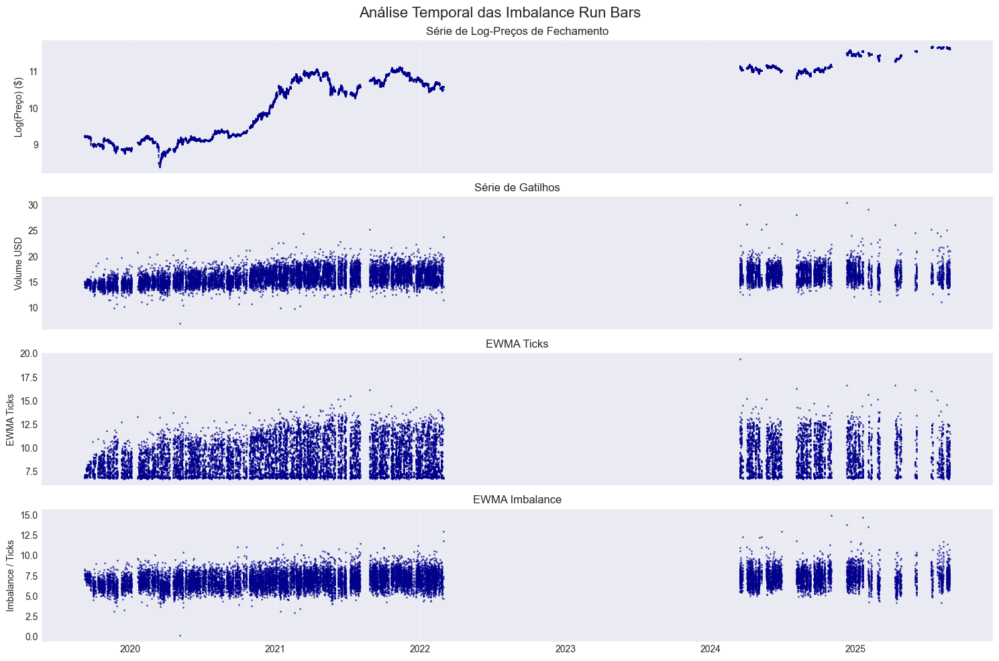

ANÁLISE DE DOLLAR IMBALANCE BARS - METODOLOGIA LOPEZ DE PRADO
SAMPLE - ./output/20250903-071928-imbalance-futures-ticks1000-aticks0.4-aimb0.7-treset5.parquet

📊 Dataset carregado: 27,007 barras
📅 Índices: 0 até 27006

📋 Estrutura dos dados:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 27007 entries, 0 to 27006
Data columns (total 13 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   end_time              27007 non-null  datetime64[ns]
 1   open                  27007 non-null  float64       
 2   high                  27007 non-null  float64       
 3   low                   27007 non-null  float64       
 4   close                 27007 non-null  float64       
 5   theta_k               27007 non-null  float64       
 6   total_volume_buy_usd  27007 non-null  float64       
 7   total_volume_usd      27007 non-null  float64       
 8   total_volume          27007 non-null  float64       
 9   ticks  

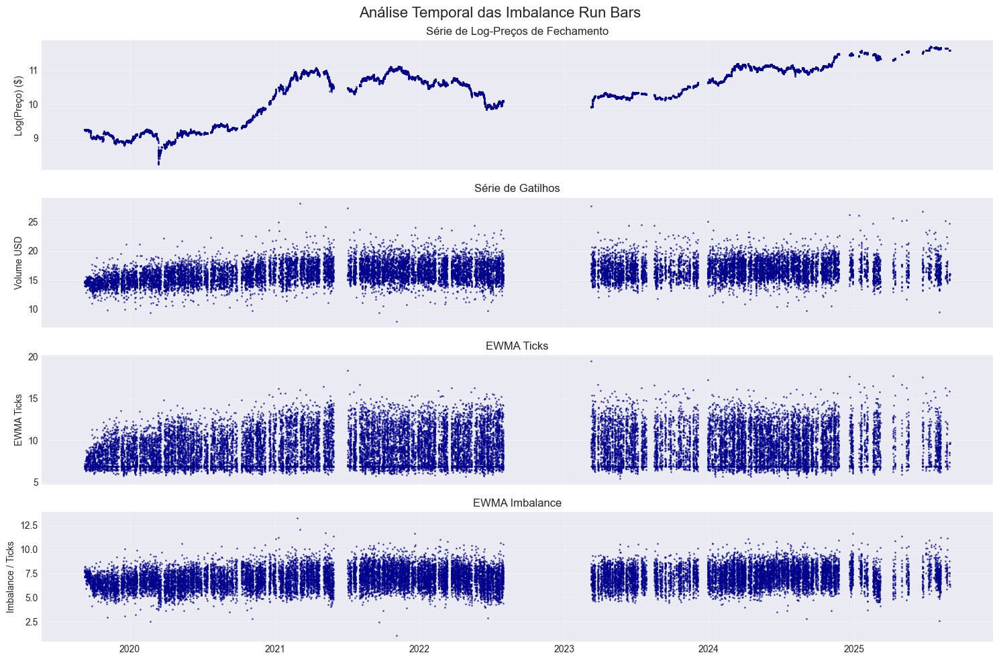

ANÁLISE DE DOLLAR IMBALANCE BARS - METODOLOGIA LOPEZ DE PRADO
SAMPLE - ./output/20250903-112908-imbalance-futures-ticks1000-aticks0.7-aimb0.7-treset9.parquet

📊 Dataset carregado: 14,984 barras
📅 Índices: 0 até 14983

📋 Estrutura dos dados:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 14984 entries, 0 to 14983
Data columns (total 13 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   end_time              14984 non-null  datetime64[ns]
 1   open                  14984 non-null  float64       
 2   high                  14984 non-null  float64       
 3   low                   14984 non-null  float64       
 4   close                 14984 non-null  float64       
 5   theta_k               14984 non-null  float64       
 6   total_volume_buy_usd  14984 non-null  float64       
 7   total_volume_usd      14984 non-null  float64       
 8   total_volume          14984 non-null  float64       
 9   ticks  

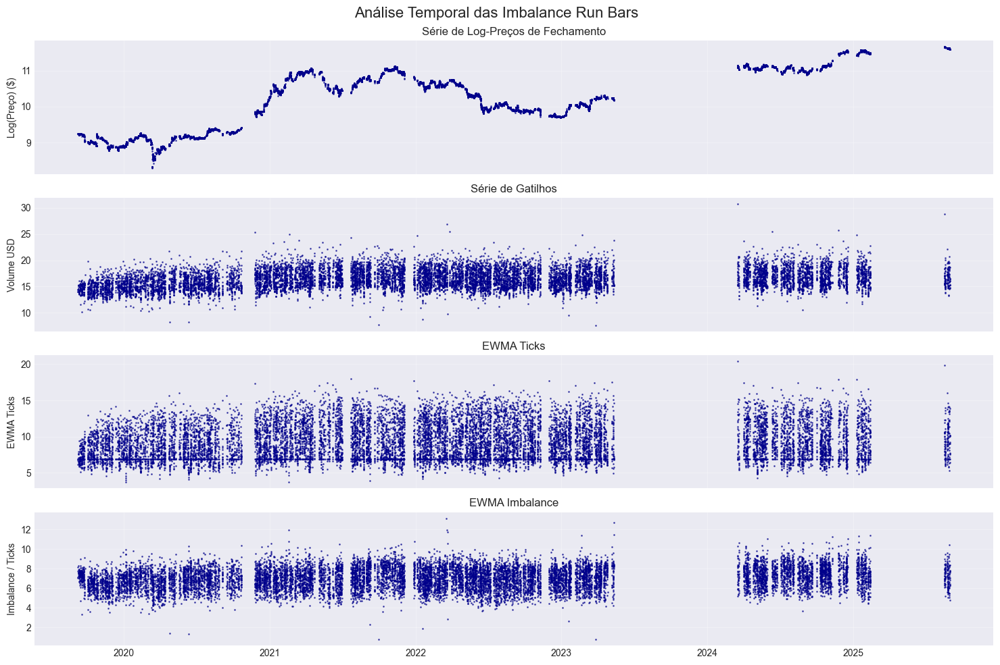

ANÁLISE DE DOLLAR IMBALANCE BARS - METODOLOGIA LOPEZ DE PRADO
SAMPLE - ./output/20250903-093915-imbalance-futures-ticks1000-aticks0.7-aimb0.4-treset5.parquet

📊 Dataset carregado: 7,786 barras
📅 Índices: 0 até 7785

📋 Estrutura dos dados:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7786 entries, 0 to 7785
Data columns (total 13 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   end_time              7786 non-null   datetime64[ns]
 1   open                  7786 non-null   float64       
 2   high                  7786 non-null   float64       
 3   low                   7786 non-null   float64       
 4   close                 7786 non-null   float64       
 5   theta_k               7786 non-null   float64       
 6   total_volume_buy_usd  7786 non-null   float64       
 7   total_volume_usd      7786 non-null   float64       
 8   total_volume          7786 non-null   float64       
 9   ticks      

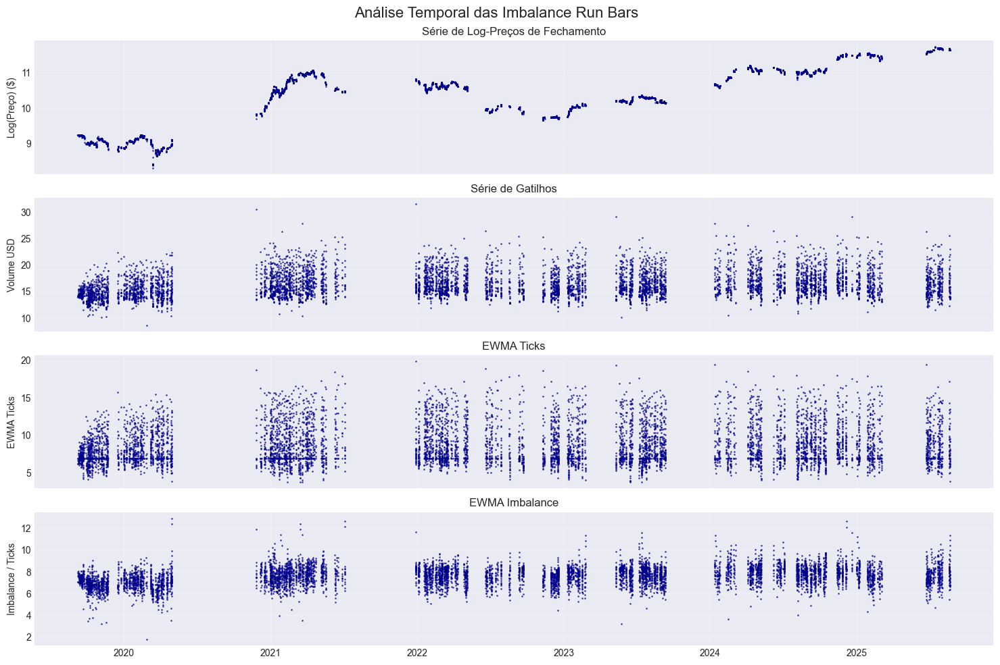

ANÁLISE DE DOLLAR IMBALANCE BARS - METODOLOGIA LOPEZ DE PRADO
SAMPLE - ./output/20250903-072625-imbalance-futures-ticks1000-aticks0.4-aimb0.7-treset6.parquet

📊 Dataset carregado: 25,817 barras
📅 Índices: 0 até 25816

📋 Estrutura dos dados:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 25817 entries, 0 to 25816
Data columns (total 13 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   end_time              25817 non-null  datetime64[ns]
 1   open                  25817 non-null  float64       
 2   high                  25817 non-null  float64       
 3   low                   25817 non-null  float64       
 4   close                 25817 non-null  float64       
 5   theta_k               25817 non-null  float64       
 6   total_volume_buy_usd  25817 non-null  float64       
 7   total_volume_usd      25817 non-null  float64       
 8   total_volume          25817 non-null  float64       
 9   ticks  

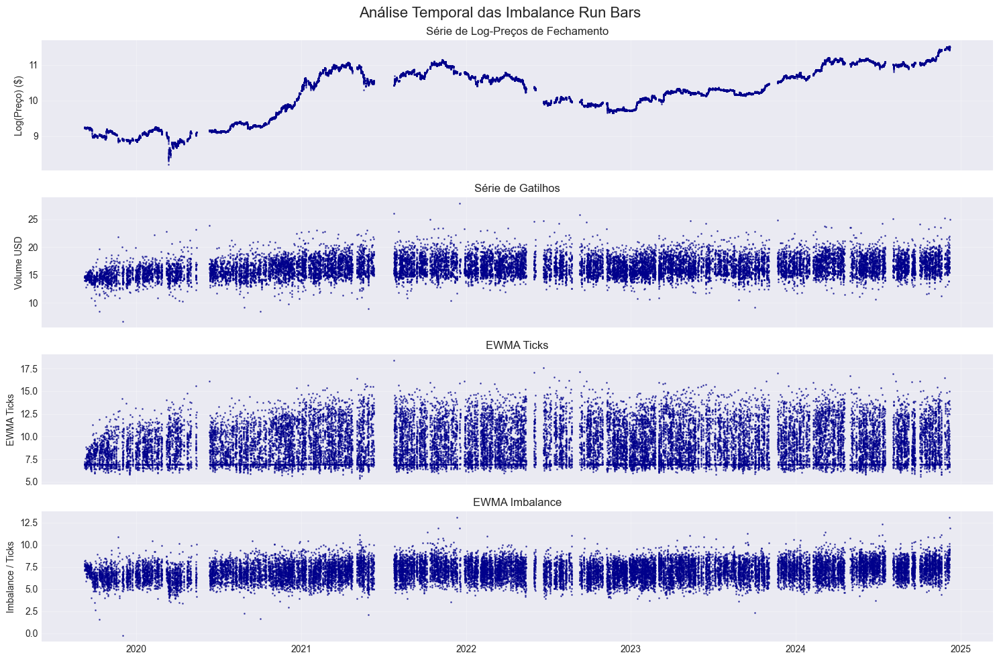

ANÁLISE DE DOLLAR IMBALANCE BARS - METODOLOGIA LOPEZ DE PRADO
SAMPLE - ./output/20250903-065834-imbalance-futures-ticks1000-aticks0.4-aimb0.7-treset2.parquet

📊 Dataset carregado: 45,280 barras
📅 Índices: 0 até 45279

📋 Estrutura dos dados:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 45280 entries, 0 to 45279
Data columns (total 13 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   end_time              45280 non-null  datetime64[ns]
 1   open                  45280 non-null  float64       
 2   high                  45280 non-null  float64       
 3   low                   45280 non-null  float64       
 4   close                 45280 non-null  float64       
 5   theta_k               45280 non-null  float64       
 6   total_volume_buy_usd  45280 non-null  float64       
 7   total_volume_usd      45280 non-null  float64       
 8   total_volume          45280 non-null  float64       
 9   ticks  

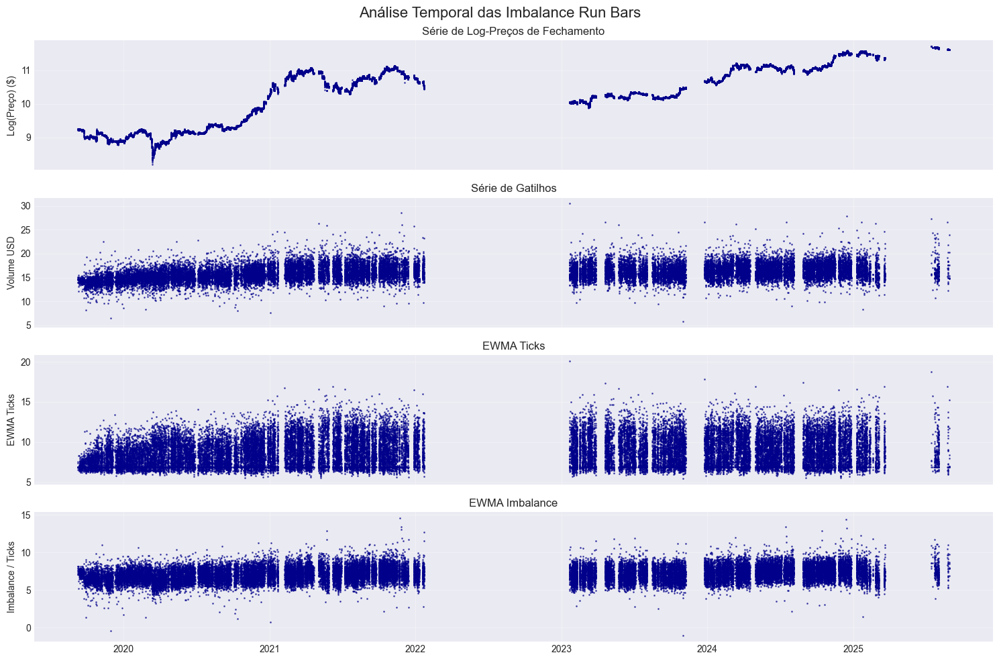

ANÁLISE DE DOLLAR IMBALANCE BARS - METODOLOGIA LOPEZ DE PRADO
SAMPLE - ./output/20250903-105652-imbalance-futures-ticks1000-aticks0.7-aimb0.7-treset5.parquet

📊 Dataset carregado: 20,171 barras
📅 Índices: 0 até 20170

📋 Estrutura dos dados:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20171 entries, 0 to 20170
Data columns (total 13 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   end_time              20171 non-null  datetime64[ns]
 1   open                  20171 non-null  float64       
 2   high                  20171 non-null  float64       
 3   low                   20171 non-null  float64       
 4   close                 20171 non-null  float64       
 5   theta_k               20171 non-null  float64       
 6   total_volume_buy_usd  20171 non-null  float64       
 7   total_volume_usd      20171 non-null  float64       
 8   total_volume          20171 non-null  float64       
 9   ticks  

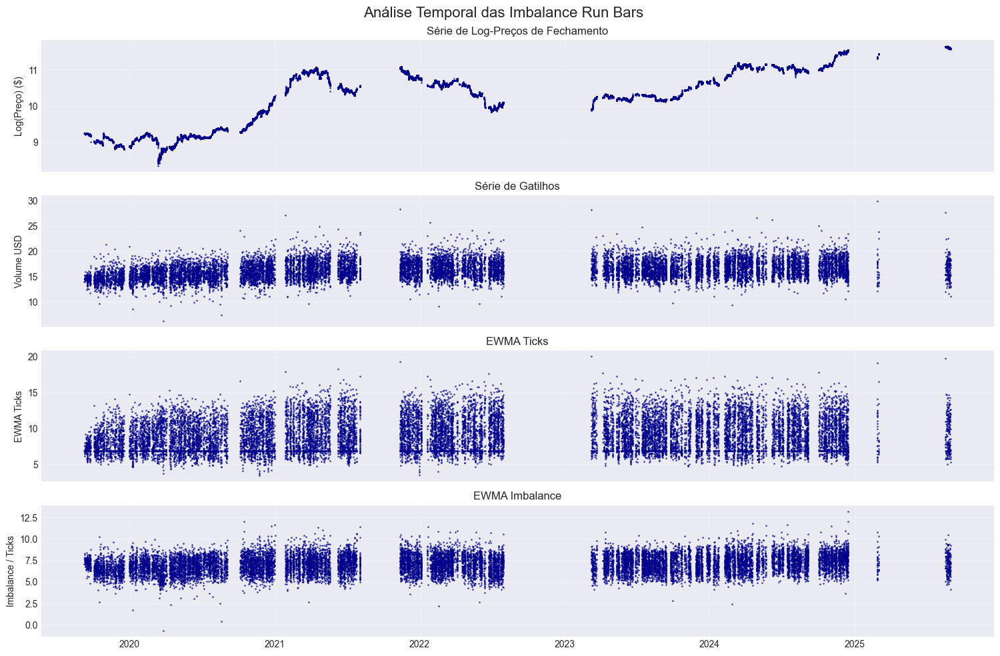

ANÁLISE DE DOLLAR IMBALANCE BARS - METODOLOGIA LOPEZ DE PRADO
SAMPLE - ./output/20250903-043249-imbalance-futures-ticks1000-aticks0.4-aimb0.1-treset1.parquet

📊 Dataset carregado: 41,171 barras
📅 Índices: 0 até 41170

📋 Estrutura dos dados:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 41171 entries, 0 to 41170
Data columns (total 13 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   end_time              41171 non-null  datetime64[ns]
 1   open                  41171 non-null  float64       
 2   high                  41171 non-null  float64       
 3   low                   41171 non-null  float64       
 4   close                 41171 non-null  float64       
 5   theta_k               41171 non-null  float64       
 6   total_volume_buy_usd  41171 non-null  float64       
 7   total_volume_usd      41171 non-null  float64       
 8   total_volume          41171 non-null  float64       
 9   ticks  

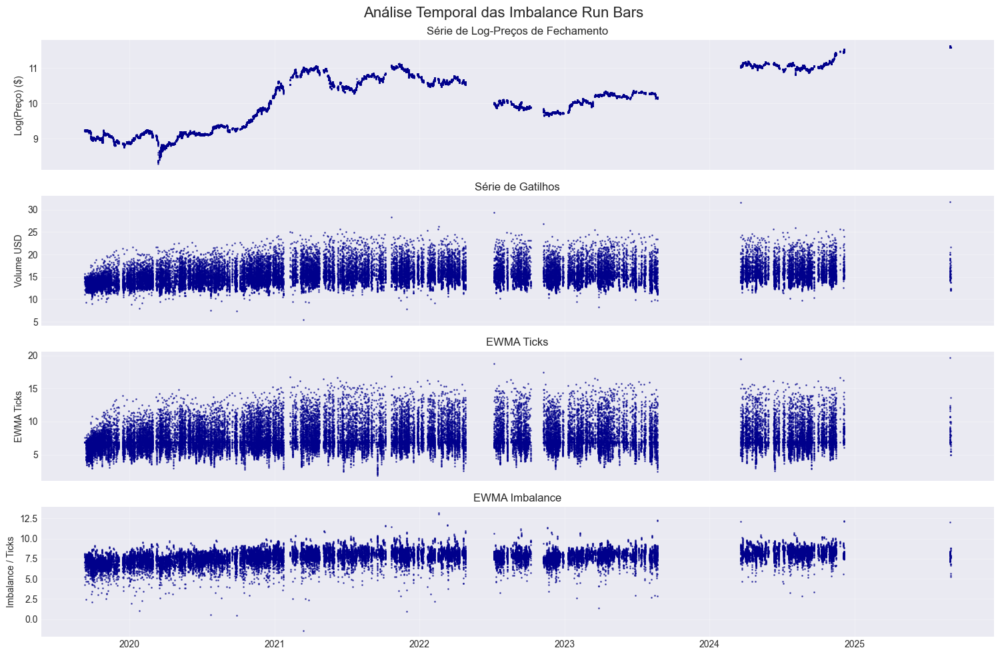

ANÁLISE DE DOLLAR IMBALANCE BARS - METODOLOGIA LOPEZ DE PRADO
SAMPLE - ./output/20250903-035113-imbalance-futures-ticks1000-aticks0.1-aimb0.7-treset5.parquet

📊 Dataset carregado: 40,855 barras
📅 Índices: 0 até 40854

📋 Estrutura dos dados:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 40855 entries, 0 to 40854
Data columns (total 13 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   end_time              40855 non-null  datetime64[ns]
 1   open                  40855 non-null  float64       
 2   high                  40855 non-null  float64       
 3   low                   40855 non-null  float64       
 4   close                 40855 non-null  float64       
 5   theta_k               40855 non-null  float64       
 6   total_volume_buy_usd  40855 non-null  float64       
 7   total_volume_usd      40855 non-null  float64       
 8   total_volume          40855 non-null  float64       
 9   ticks  

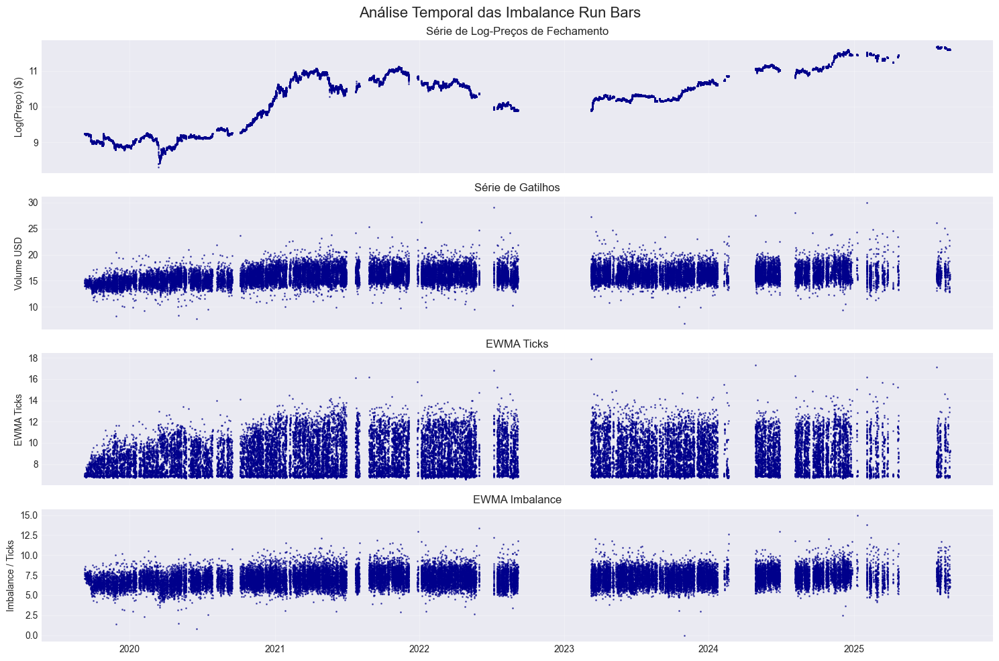

ANÁLISE DE DOLLAR IMBALANCE BARS - METODOLOGIA LOPEZ DE PRADO
SAMPLE - ./output/20250903-020030-imbalance-futures-ticks1000-aticks0.1-aimb0.1-treset9.parquet

📊 Dataset carregado: 21,194 barras
📅 Índices: 0 até 21193

📋 Estrutura dos dados:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21194 entries, 0 to 21193
Data columns (total 13 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   end_time              21194 non-null  datetime64[ns]
 1   open                  21194 non-null  float64       
 2   high                  21194 non-null  float64       
 3   low                   21194 non-null  float64       
 4   close                 21194 non-null  float64       
 5   theta_k               21194 non-null  float64       
 6   total_volume_buy_usd  21194 non-null  float64       
 7   total_volume_usd      21194 non-null  float64       
 8   total_volume          21194 non-null  float64       
 9   ticks  

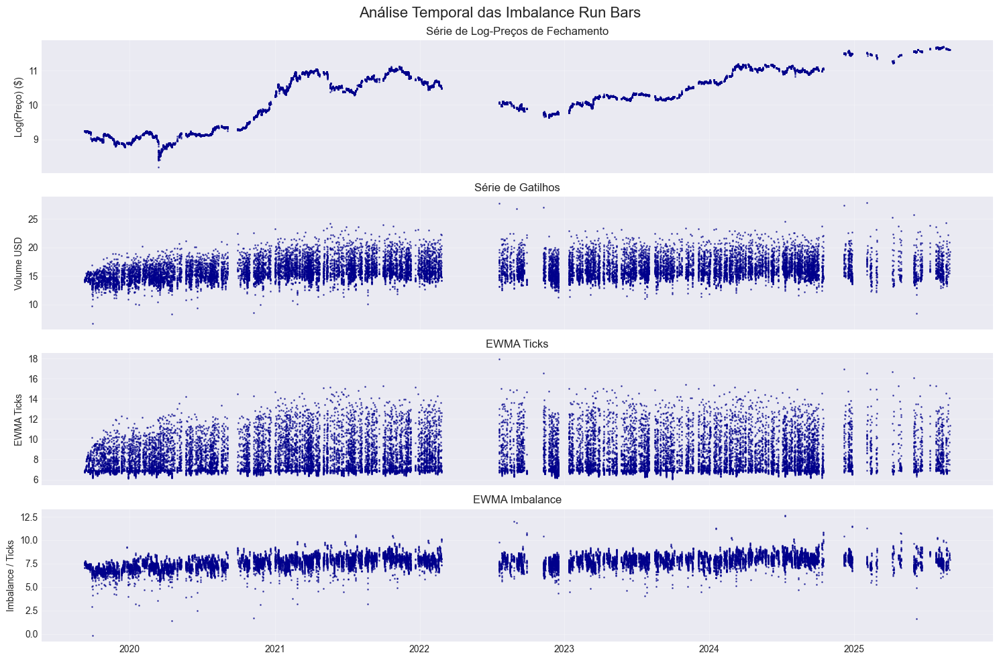

ANÁLISE DE DOLLAR IMBALANCE BARS - METODOLOGIA LOPEZ DE PRADO
SAMPLE - ./output/20250903-073320-imbalance-futures-ticks1000-aticks0.4-aimb0.7-treset7.parquet

📊 Dataset carregado: 18,707 barras
📅 Índices: 0 até 18706

📋 Estrutura dos dados:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 18707 entries, 0 to 18706
Data columns (total 13 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   end_time              18707 non-null  datetime64[ns]
 1   open                  18707 non-null  float64       
 2   high                  18707 non-null  float64       
 3   low                   18707 non-null  float64       
 4   close                 18707 non-null  float64       
 5   theta_k               18707 non-null  float64       
 6   total_volume_buy_usd  18707 non-null  float64       
 7   total_volume_usd      18707 non-null  float64       
 8   total_volume          18707 non-null  float64       
 9   ticks  

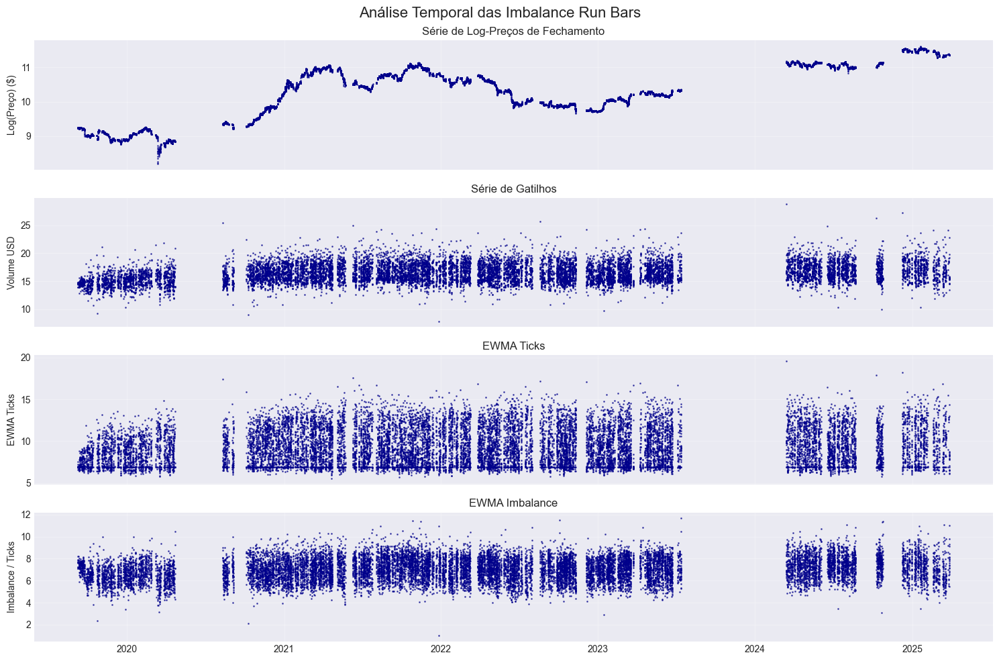

ANÁLISE DE DOLLAR IMBALANCE BARS - METODOLOGIA LOPEZ DE PRADO
SAMPLE - ./output/20250903-091751-imbalance-futures-ticks1000-aticks0.7-aimb0.4-treset2.parquet

📊 Dataset carregado: 12,666 barras
📅 Índices: 0 até 12665

📋 Estrutura dos dados:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 12666 entries, 0 to 12665
Data columns (total 13 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   end_time              12666 non-null  datetime64[ns]
 1   open                  12666 non-null  float64       
 2   high                  12666 non-null  float64       
 3   low                   12666 non-null  float64       
 4   close                 12666 non-null  float64       
 5   theta_k               12666 non-null  float64       
 6   total_volume_buy_usd  12666 non-null  float64       
 7   total_volume_usd      12666 non-null  float64       
 8   total_volume          12666 non-null  float64       
 9   ticks  

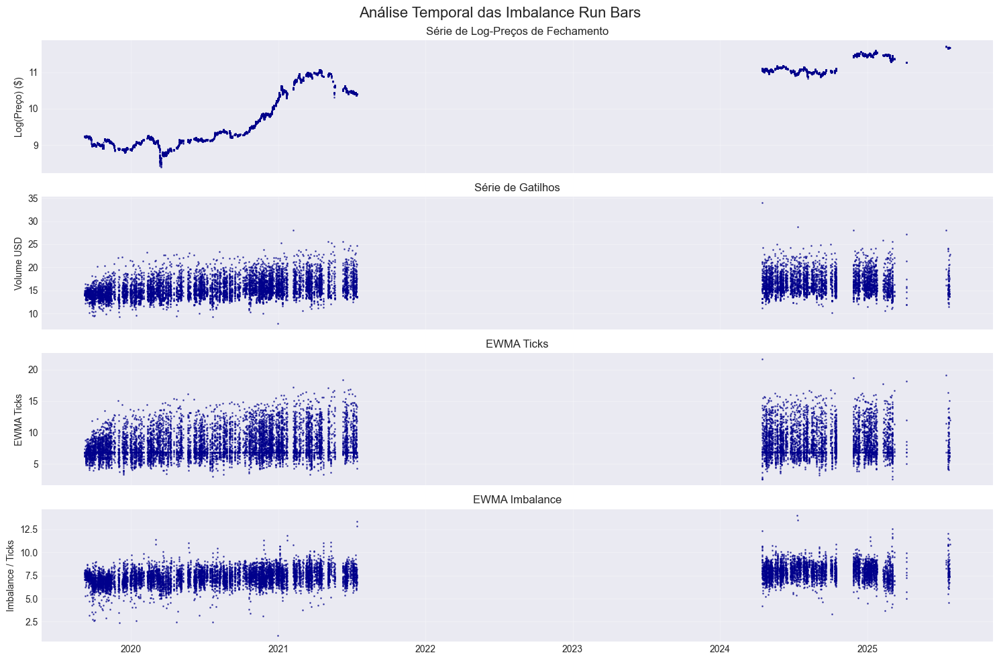

ANÁLISE DE DOLLAR IMBALANCE BARS - METODOLOGIA LOPEZ DE PRADO
SAMPLE - ./output/20250903-034419-imbalance-futures-ticks1000-aticks0.1-aimb0.7-treset4.parquet

📊 Dataset carregado: 55,008 barras
📅 Índices: 0 até 55007

📋 Estrutura dos dados:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 55008 entries, 0 to 55007
Data columns (total 13 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   end_time              55008 non-null  datetime64[ns]
 1   open                  55008 non-null  float64       
 2   high                  55008 non-null  float64       
 3   low                   55008 non-null  float64       
 4   close                 55008 non-null  float64       
 5   theta_k               55008 non-null  float64       
 6   total_volume_buy_usd  55008 non-null  float64       
 7   total_volume_usd      55008 non-null  float64       
 8   total_volume          55008 non-null  float64       
 9   ticks  

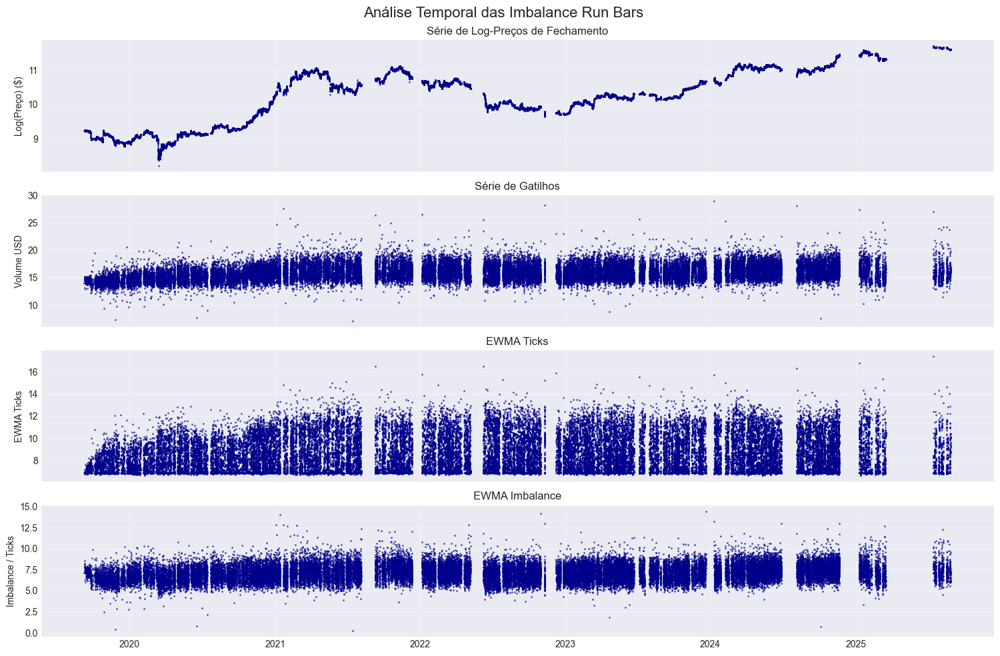

ANÁLISE DE DOLLAR IMBALANCE BARS - METODOLOGIA LOPEZ DE PRADO
SAMPLE - ./output/20250903-055559-imbalance-futures-ticks1000-aticks0.4-aimb0.4-treset3.parquet

📊 Dataset carregado: 22,582 barras
📅 Índices: 0 até 22581

📋 Estrutura dos dados:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 22582 entries, 0 to 22581
Data columns (total 13 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   end_time              22582 non-null  datetime64[ns]
 1   open                  22582 non-null  float64       
 2   high                  22582 non-null  float64       
 3   low                   22582 non-null  float64       
 4   close                 22582 non-null  float64       
 5   theta_k               22582 non-null  float64       
 6   total_volume_buy_usd  22582 non-null  float64       
 7   total_volume_usd      22582 non-null  float64       
 8   total_volume          22582 non-null  float64       
 9   ticks  

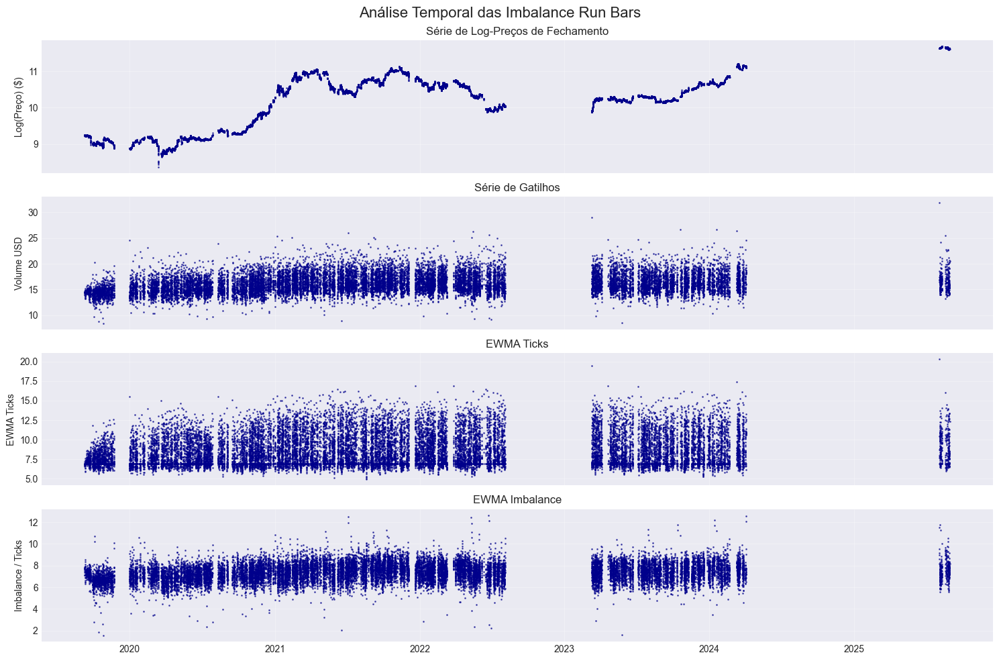

ANÁLISE DE DOLLAR IMBALANCE BARS - METODOLOGIA LOPEZ DE PRADO
SAMPLE - ./output/20250903-085657-imbalance-futures-ticks1000-aticks0.7-aimb0.1-treset9.parquet

📊 Dataset carregado: 2,135 barras
📅 Índices: 0 até 2134

📋 Estrutura dos dados:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2135 entries, 0 to 2134
Data columns (total 13 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   end_time              2135 non-null   datetime64[ns]
 1   open                  2135 non-null   float64       
 2   high                  2135 non-null   float64       
 3   low                   2135 non-null   float64       
 4   close                 2135 non-null   float64       
 5   theta_k               2135 non-null   float64       
 6   total_volume_buy_usd  2135 non-null   float64       
 7   total_volume_usd      2135 non-null   float64       
 8   total_volume          2135 non-null   float64       
 9   ticks      

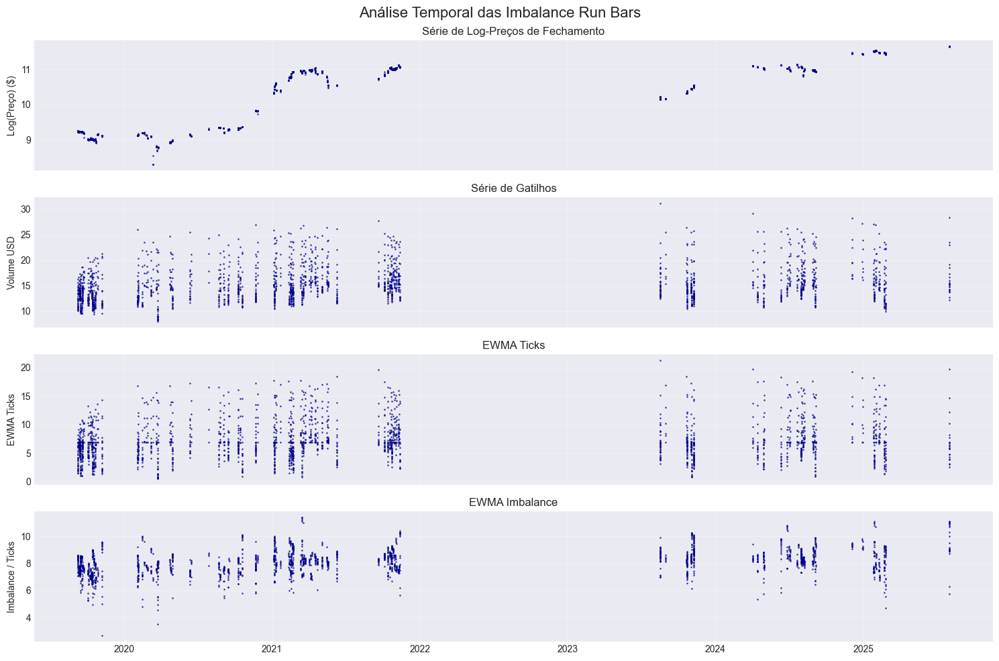

ANÁLISE DE DOLLAR IMBALANCE BARS - METODOLOGIA LOPEZ DE PRADO
SAMPLE - ./output/20250903-050027-imbalance-futures-ticks1000-aticks0.4-aimb0.1-treset5.parquet

📊 Dataset carregado: 8,005 barras
📅 Índices: 0 até 8004

📋 Estrutura dos dados:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8005 entries, 0 to 8004
Data columns (total 13 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   end_time              8005 non-null   datetime64[ns]
 1   open                  8005 non-null   float64       
 2   high                  8005 non-null   float64       
 3   low                   8005 non-null   float64       
 4   close                 8005 non-null   float64       
 5   theta_k               8005 non-null   float64       
 6   total_volume_buy_usd  8005 non-null   float64       
 7   total_volume_usd      8005 non-null   float64       
 8   total_volume          8005 non-null   float64       
 9   ticks      

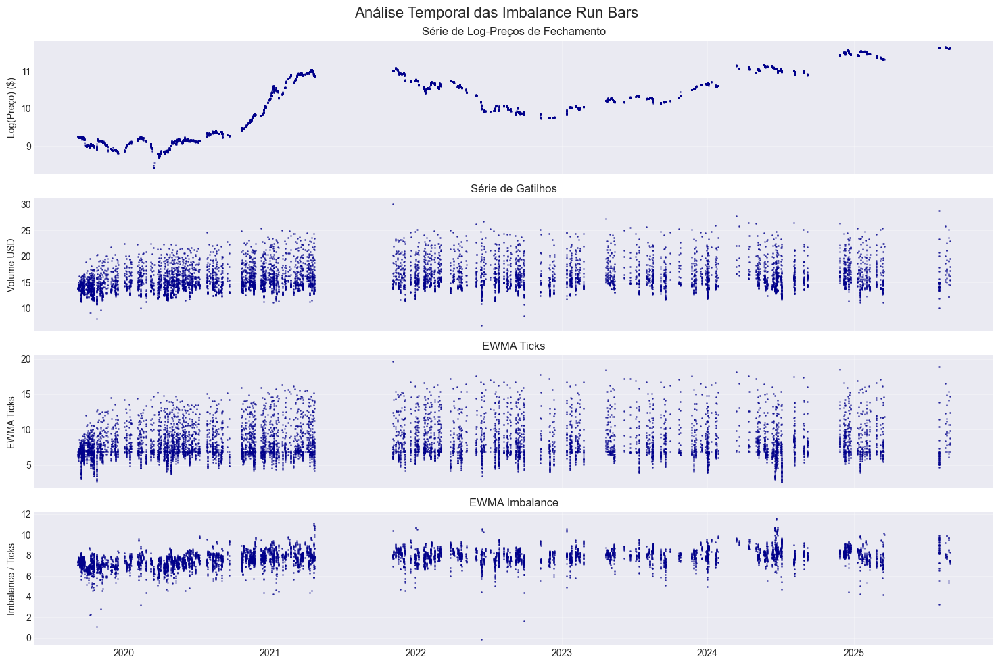

ANÁLISE DE DOLLAR IMBALANCE BARS - METODOLOGIA LOPEZ DE PRADO
SAMPLE - ./output/20250903-041855-imbalance-futures-ticks1000-aticks0.1-aimb0.7-treset9.parquet

📊 Dataset carregado: 31,084 barras
📅 Índices: 0 até 31083

📋 Estrutura dos dados:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 31084 entries, 0 to 31083
Data columns (total 13 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   end_time              31084 non-null  datetime64[ns]
 1   open                  31084 non-null  float64       
 2   high                  31084 non-null  float64       
 3   low                   31084 non-null  float64       
 4   close                 31084 non-null  float64       
 5   theta_k               31084 non-null  float64       
 6   total_volume_buy_usd  31084 non-null  float64       
 7   total_volume_usd      31084 non-null  float64       
 8   total_volume          31084 non-null  float64       
 9   ticks  

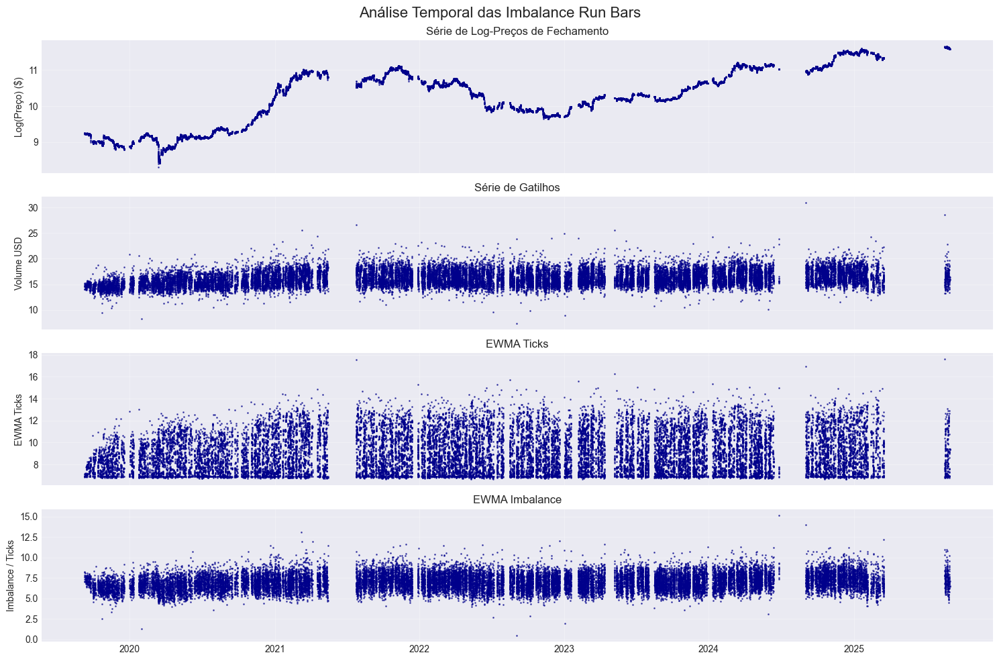

ANÁLISE DE DOLLAR IMBALANCE BARS - METODOLOGIA LOPEZ DE PRADO
SAMPLE - ./output/20250903-033027-imbalance-futures-ticks1000-aticks0.1-aimb0.7-treset2.parquet

📊 Dataset carregado: 91,889 barras
📅 Índices: 0 até 91888

📋 Estrutura dos dados:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 91889 entries, 0 to 91888
Data columns (total 13 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   end_time              91889 non-null  datetime64[ns]
 1   open                  91889 non-null  float64       
 2   high                  91889 non-null  float64       
 3   low                   91889 non-null  float64       
 4   close                 91889 non-null  float64       
 5   theta_k               91889 non-null  float64       
 6   total_volume_buy_usd  91889 non-null  float64       
 7   total_volume_usd      91889 non-null  float64       
 8   total_volume          91889 non-null  float64       
 9   ticks  

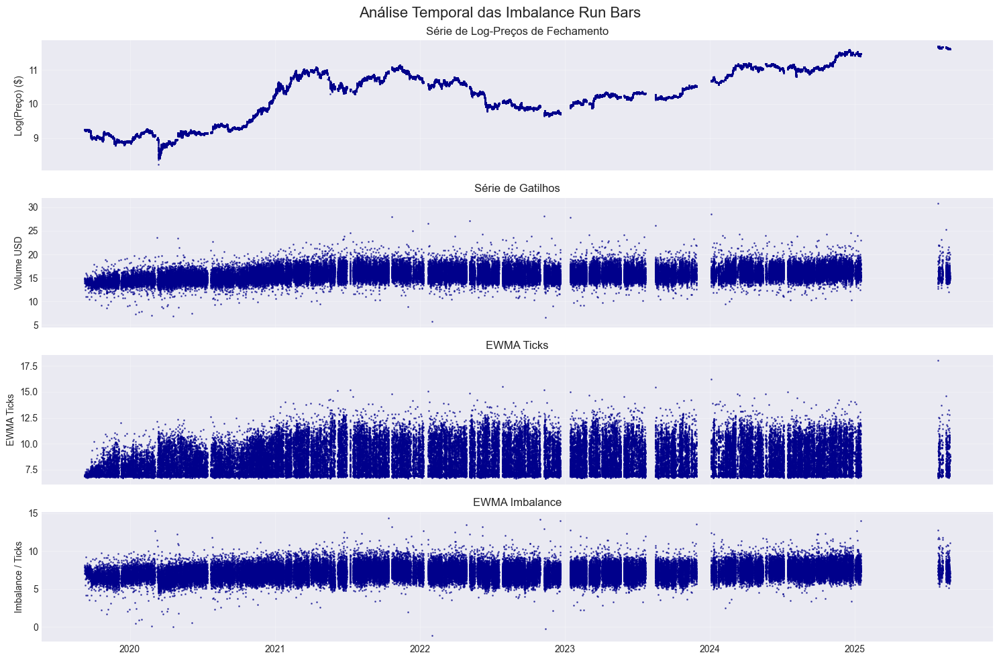

ANÁLISE DE DOLLAR IMBALANCE BARS - METODOLOGIA LOPEZ DE PRADO
SAMPLE - ./output/20250903-053509-imbalance-futures-ticks1000-aticks0.4-aimb0.1-treset10.parquet

📊 Dataset carregado: 4,087 barras
📅 Índices: 0 até 4086

📋 Estrutura dos dados:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4087 entries, 0 to 4086
Data columns (total 13 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   end_time              4087 non-null   datetime64[ns]
 1   open                  4087 non-null   float64       
 2   high                  4087 non-null   float64       
 3   low                   4087 non-null   float64       
 4   close                 4087 non-null   float64       
 5   theta_k               4087 non-null   float64       
 6   total_volume_buy_usd  4087 non-null   float64       
 7   total_volume_usd      4087 non-null   float64       
 8   total_volume          4087 non-null   float64       
 9   ticks     

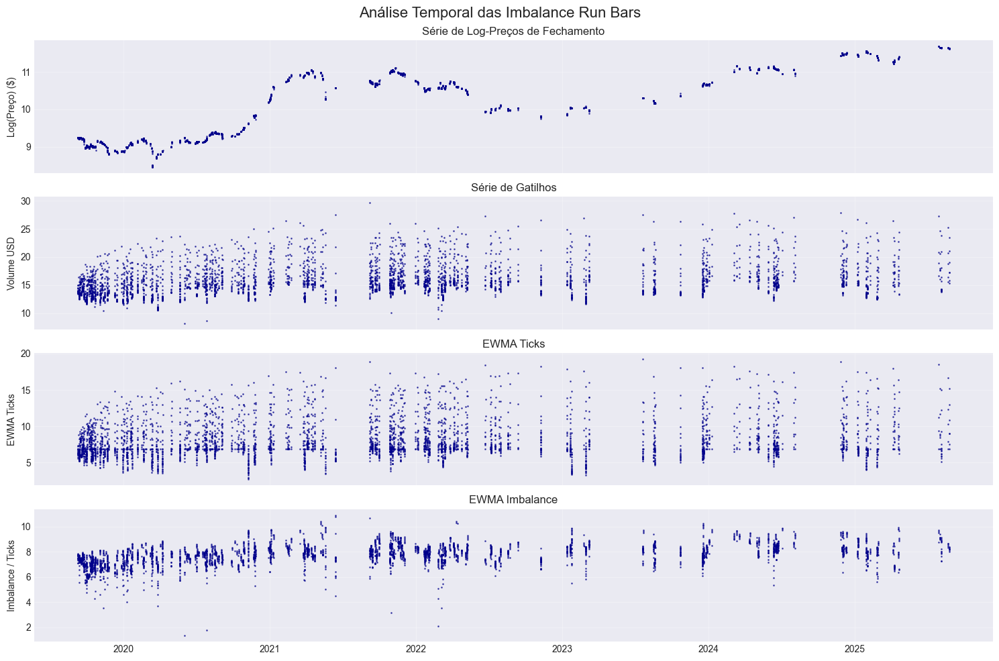

ANÁLISE DE DOLLAR IMBALANCE BARS - METODOLOGIA LOPEZ DE PRADO
SAMPLE - ./output/20250903-100916-imbalance-futures-ticks1000-aticks0.7-aimb0.4-treset9.parquet

📊 Dataset carregado: 3,637 barras
📅 Índices: 0 até 3636

📋 Estrutura dos dados:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3637 entries, 0 to 3636
Data columns (total 13 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   end_time              3637 non-null   datetime64[ns]
 1   open                  3637 non-null   float64       
 2   high                  3637 non-null   float64       
 3   low                   3637 non-null   float64       
 4   close                 3637 non-null   float64       
 5   theta_k               3637 non-null   float64       
 6   total_volume_buy_usd  3637 non-null   float64       
 7   total_volume_usd      3637 non-null   float64       
 8   total_volume          3637 non-null   float64       
 9   ticks      

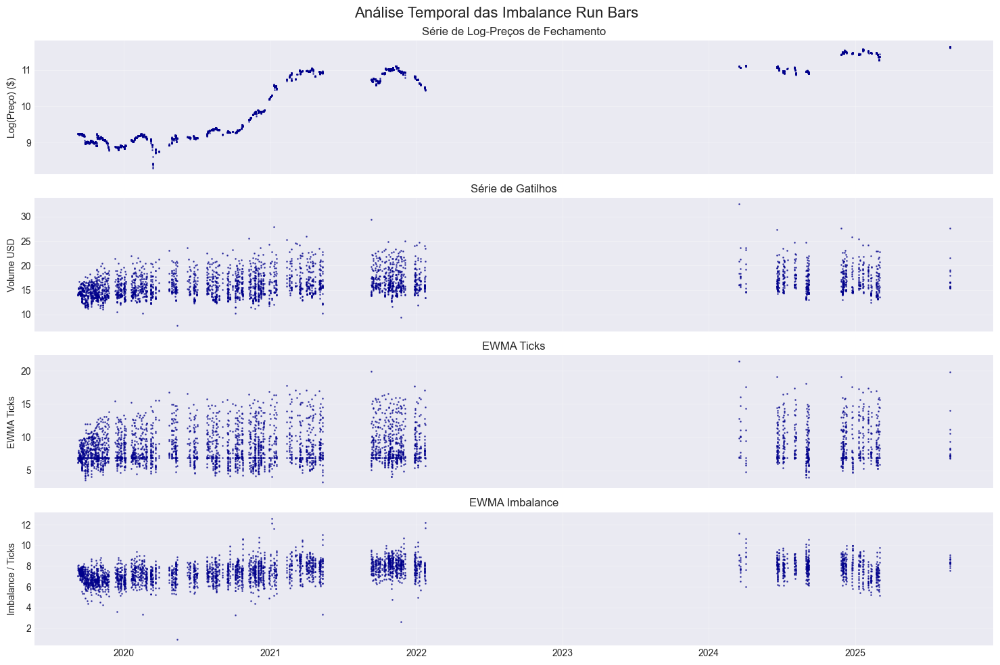

ANÁLISE DE DOLLAR IMBALANCE BARS - METODOLOGIA LOPEZ DE PRADO
SAMPLE - ./output/20250903-051425-imbalance-futures-ticks1000-aticks0.4-aimb0.1-treset7.parquet

📊 Dataset carregado: 5,434 barras
📅 Índices: 0 até 5433

📋 Estrutura dos dados:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5434 entries, 0 to 5433
Data columns (total 13 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   end_time              5434 non-null   datetime64[ns]
 1   open                  5434 non-null   float64       
 2   high                  5434 non-null   float64       
 3   low                   5434 non-null   float64       
 4   close                 5434 non-null   float64       
 5   theta_k               5434 non-null   float64       
 6   total_volume_buy_usd  5434 non-null   float64       
 7   total_volume_usd      5434 non-null   float64       
 8   total_volume          5434 non-null   float64       
 9   ticks      

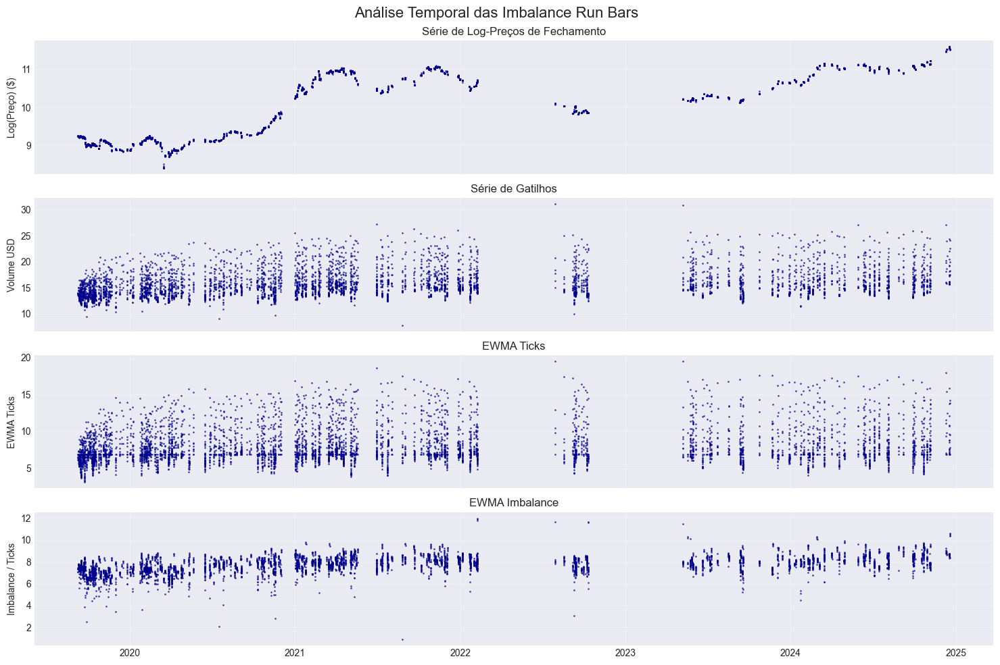

ANÁLISE DE DOLLAR IMBALANCE BARS - METODOLOGIA LOPEZ DE PRADO
SAMPLE - ./output/20250903-081503-imbalance-futures-ticks1000-aticks0.7-aimb0.1-treset3.parquet

📊 Dataset carregado: 5,571 barras
📅 Índices: 0 até 5570

📋 Estrutura dos dados:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5571 entries, 0 to 5570
Data columns (total 13 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   end_time              5571 non-null   datetime64[ns]
 1   open                  5571 non-null   float64       
 2   high                  5571 non-null   float64       
 3   low                   5571 non-null   float64       
 4   close                 5571 non-null   float64       
 5   theta_k               5571 non-null   float64       
 6   total_volume_buy_usd  5571 non-null   float64       
 7   total_volume_usd      5571 non-null   float64       
 8   total_volume          5571 non-null   float64       
 9   ticks      

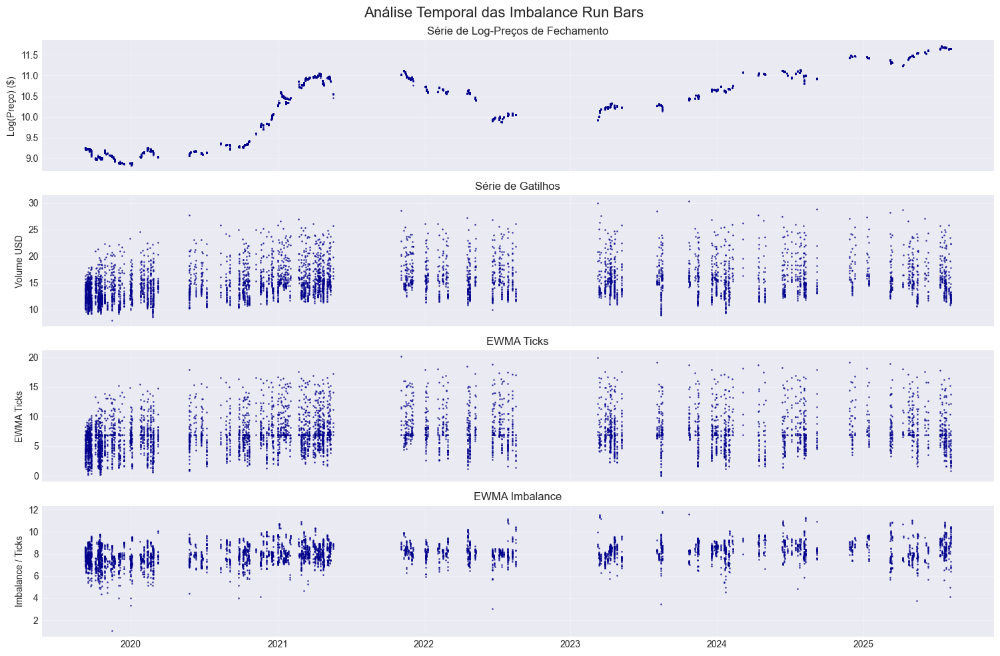

ANÁLISE DE DOLLAR IMBALANCE BARS - METODOLOGIA LOPEZ DE PRADO
SAMPLE - ./output/20250903-060254-imbalance-futures-ticks1000-aticks0.4-aimb0.4-treset4.parquet

📊 Dataset carregado: 25,864 barras
📅 Índices: 0 até 25863

📋 Estrutura dos dados:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 25864 entries, 0 to 25863
Data columns (total 13 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   end_time              25864 non-null  datetime64[ns]
 1   open                  25864 non-null  float64       
 2   high                  25864 non-null  float64       
 3   low                   25864 non-null  float64       
 4   close                 25864 non-null  float64       
 5   theta_k               25864 non-null  float64       
 6   total_volume_buy_usd  25864 non-null  float64       
 7   total_volume_usd      25864 non-null  float64       
 8   total_volume          25864 non-null  float64       
 9   ticks  

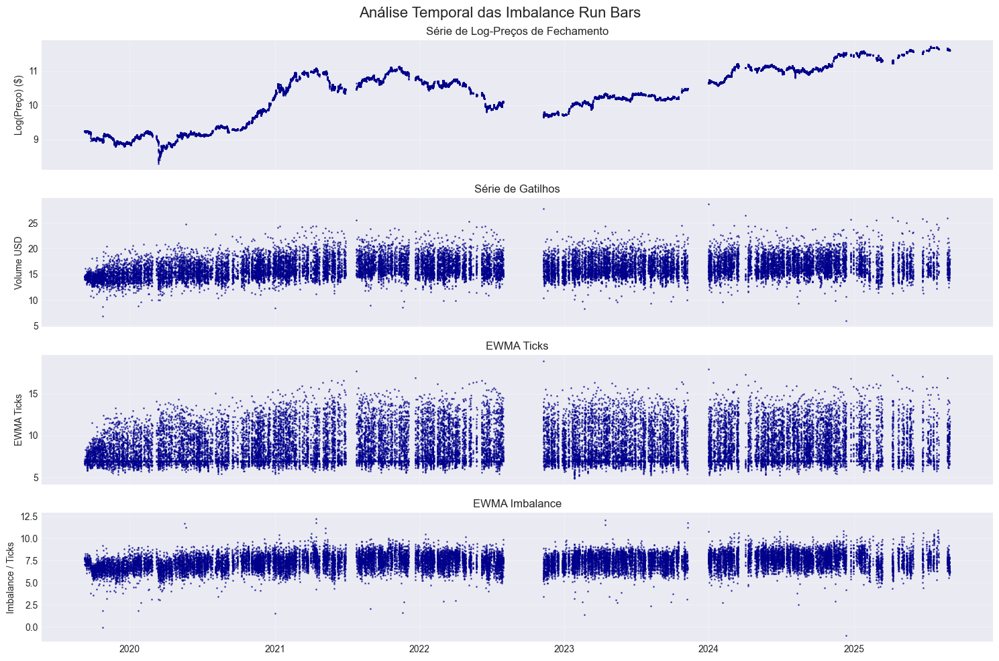

ANÁLISE DE DOLLAR IMBALANCE BARS - METODOLOGIA LOPEZ DE PRADO
SAMPLE - ./output/20250903-045331-imbalance-futures-ticks1000-aticks0.4-aimb0.1-treset4.parquet

📊 Dataset carregado: 10,375 barras
📅 Índices: 0 até 10374

📋 Estrutura dos dados:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10375 entries, 0 to 10374
Data columns (total 13 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   end_time              10375 non-null  datetime64[ns]
 1   open                  10375 non-null  float64       
 2   high                  10375 non-null  float64       
 3   low                   10375 non-null  float64       
 4   close                 10375 non-null  float64       
 5   theta_k               10375 non-null  float64       
 6   total_volume_buy_usd  10375 non-null  float64       
 7   total_volume_usd      10375 non-null  float64       
 8   total_volume          10375 non-null  float64       
 9   ticks  

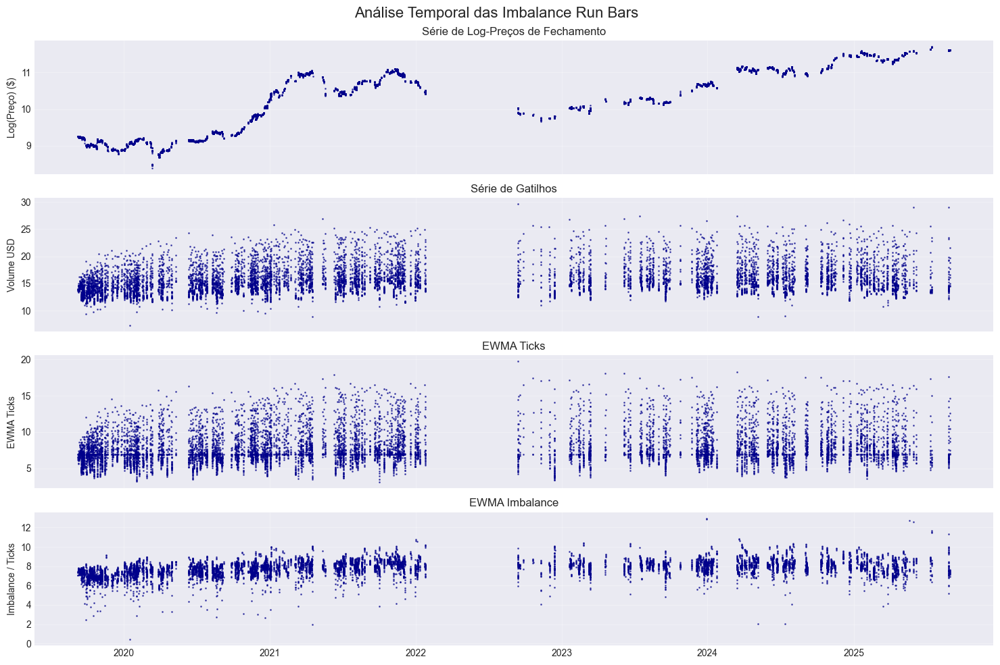

ANÁLISE DE DOLLAR IMBALANCE BARS - METODOLOGIA LOPEZ DE PRADO
SAMPLE - ./output/20250903-092453-imbalance-futures-ticks1000-aticks0.7-aimb0.4-treset3.parquet

📊 Dataset carregado: 13,875 barras
📅 Índices: 0 até 13874

📋 Estrutura dos dados:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 13875 entries, 0 to 13874
Data columns (total 13 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   end_time              13875 non-null  datetime64[ns]
 1   open                  13875 non-null  float64       
 2   high                  13875 non-null  float64       
 3   low                   13875 non-null  float64       
 4   close                 13875 non-null  float64       
 5   theta_k               13875 non-null  float64       
 6   total_volume_buy_usd  13875 non-null  float64       
 7   total_volume_usd      13875 non-null  float64       
 8   total_volume          13875 non-null  float64       
 9   ticks  

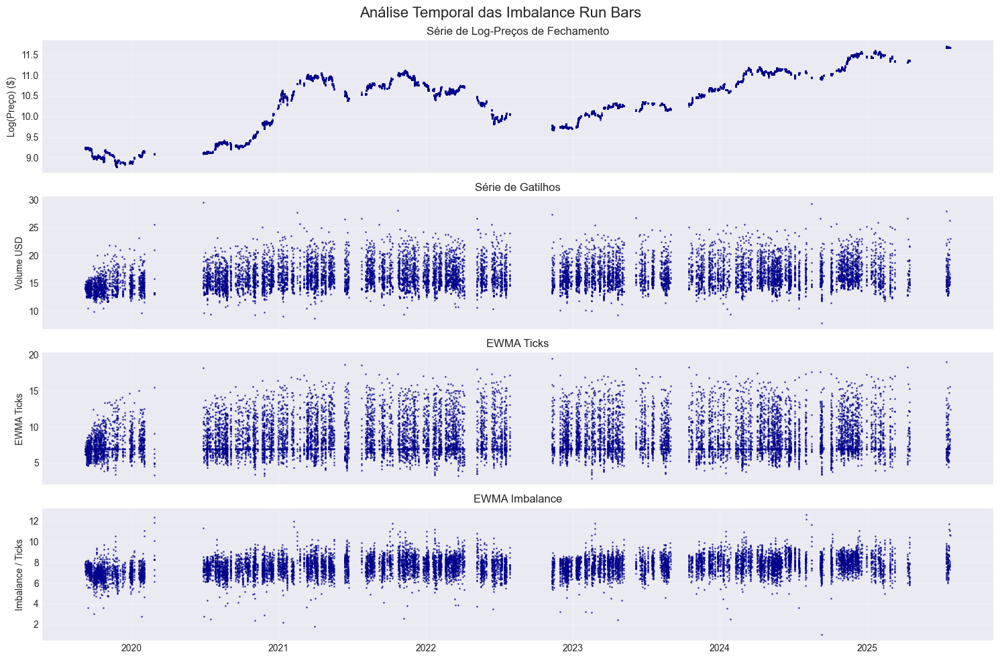

ANÁLISE DE DOLLAR IMBALANCE BARS - METODOLOGIA LOPEZ DE PRADO
SAMPLE - ./output/20250903-013936-imbalance-futures-ticks1000-aticks0.1-aimb0.1-treset6.parquet

📊 Dataset carregado: 32,743 barras
📅 Índices: 0 até 32742

📋 Estrutura dos dados:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 32743 entries, 0 to 32742
Data columns (total 13 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   end_time              32743 non-null  datetime64[ns]
 1   open                  32743 non-null  float64       
 2   high                  32743 non-null  float64       
 3   low                   32743 non-null  float64       
 4   close                 32743 non-null  float64       
 5   theta_k               32743 non-null  float64       
 6   total_volume_buy_usd  32743 non-null  float64       
 7   total_volume_usd      32743 non-null  float64       
 8   total_volume          32743 non-null  float64       
 9   ticks  

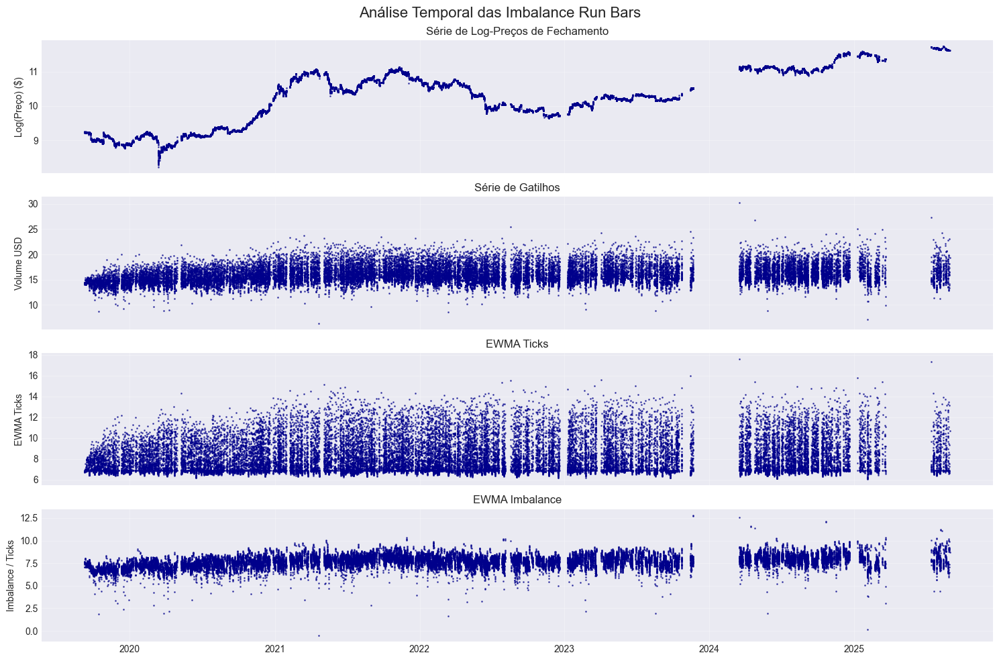

ANÁLISE DE DOLLAR IMBALANCE BARS - METODOLOGIA LOPEZ DE PRADO
SAMPLE - ./output/20250903-082900-imbalance-futures-ticks1000-aticks0.7-aimb0.1-treset5.parquet

📊 Dataset carregado: 4,170 barras
📅 Índices: 0 até 4169

📋 Estrutura dos dados:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4170 entries, 0 to 4169
Data columns (total 13 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   end_time              4170 non-null   datetime64[ns]
 1   open                  4170 non-null   float64       
 2   high                  4170 non-null   float64       
 3   low                   4170 non-null   float64       
 4   close                 4170 non-null   float64       
 5   theta_k               4170 non-null   float64       
 6   total_volume_buy_usd  4170 non-null   float64       
 7   total_volume_usd      4170 non-null   float64       
 8   total_volume          4170 non-null   float64       
 9   ticks      

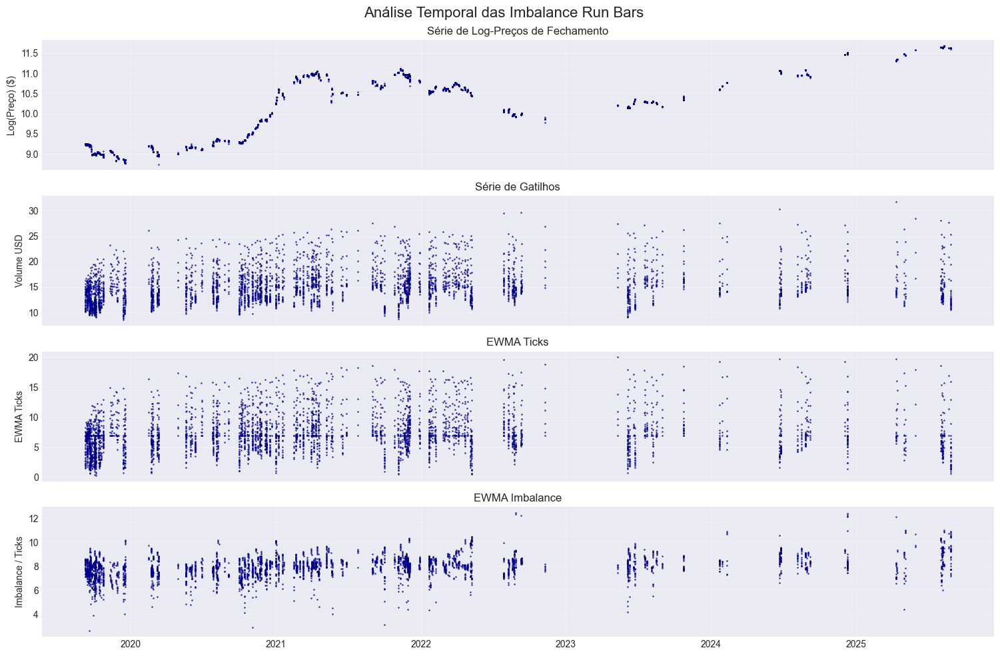

ANÁLISE DE DOLLAR IMBALANCE BARS - METODOLOGIA LOPEZ DE PRADO
SAMPLE - ./output/20250903-024150-imbalance-futures-ticks1000-aticks0.1-aimb0.4-treset5.parquet

📊 Dataset carregado: 51,918 barras
📅 Índices: 0 até 51917

📋 Estrutura dos dados:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 51918 entries, 0 to 51917
Data columns (total 13 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   end_time              51918 non-null  datetime64[ns]
 1   open                  51918 non-null  float64       
 2   high                  51918 non-null  float64       
 3   low                   51918 non-null  float64       
 4   close                 51918 non-null  float64       
 5   theta_k               51918 non-null  float64       
 6   total_volume_buy_usd  51918 non-null  float64       
 7   total_volume_usd      51918 non-null  float64       
 8   total_volume          51918 non-null  float64       
 9   ticks  

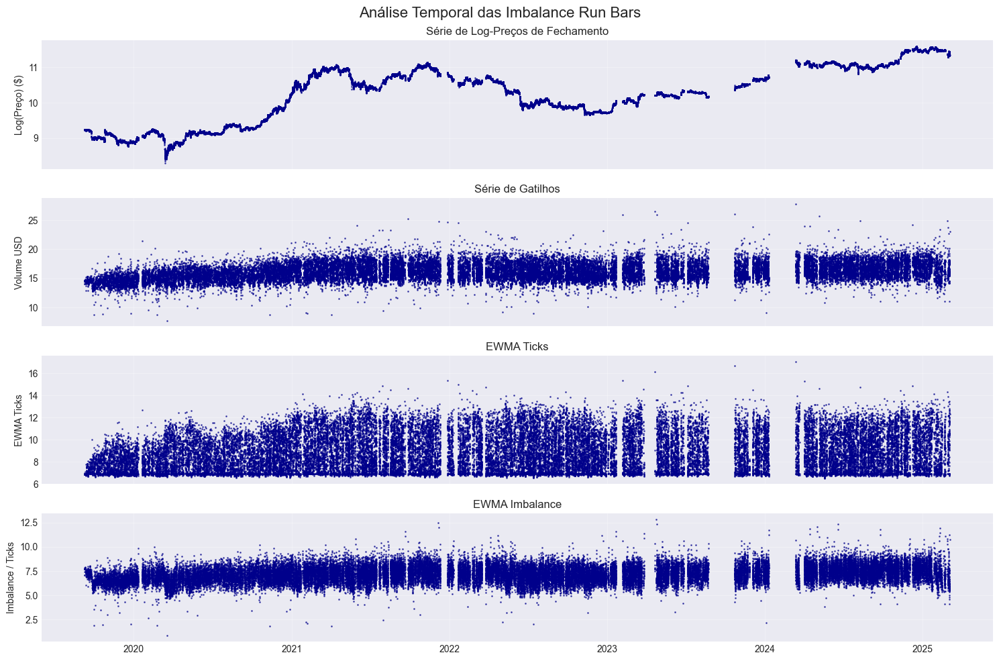

ANÁLISE DE DOLLAR IMBALANCE BARS - METODOLOGIA LOPEZ DE PRADO
SAMPLE - ./output/20250903-024843-imbalance-futures-ticks1000-aticks0.1-aimb0.4-treset6.parquet

📊 Dataset carregado: 31,759 barras
📅 Índices: 0 até 31758

📋 Estrutura dos dados:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 31759 entries, 0 to 31758
Data columns (total 13 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   end_time              31759 non-null  datetime64[ns]
 1   open                  31759 non-null  float64       
 2   high                  31759 non-null  float64       
 3   low                   31759 non-null  float64       
 4   close                 31759 non-null  float64       
 5   theta_k               31759 non-null  float64       
 6   total_volume_buy_usd  31759 non-null  float64       
 7   total_volume_usd      31759 non-null  float64       
 8   total_volume          31759 non-null  float64       
 9   ticks  

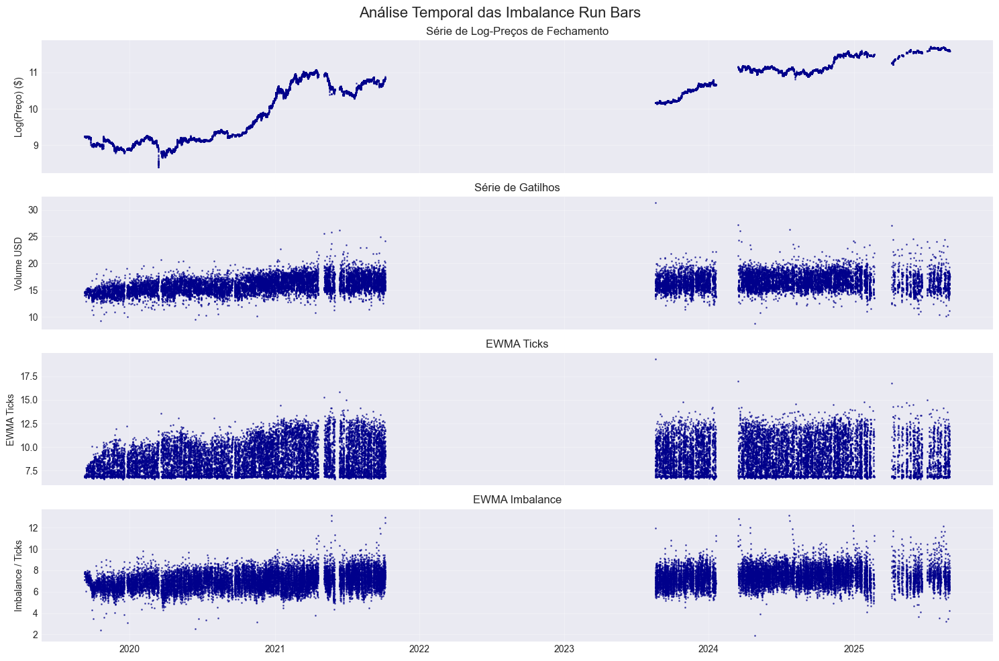

ANÁLISE DE DOLLAR IMBALANCE BARS - METODOLOGIA LOPEZ DE PRADO
SAMPLE - ./output/20250903-050726-imbalance-futures-ticks1000-aticks0.4-aimb0.1-treset6.parquet

📊 Dataset carregado: 7,954 barras
📅 Índices: 0 até 7953

📋 Estrutura dos dados:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7954 entries, 0 to 7953
Data columns (total 13 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   end_time              7954 non-null   datetime64[ns]
 1   open                  7954 non-null   float64       
 2   high                  7954 non-null   float64       
 3   low                   7954 non-null   float64       
 4   close                 7954 non-null   float64       
 5   theta_k               7954 non-null   float64       
 6   total_volume_buy_usd  7954 non-null   float64       
 7   total_volume_usd      7954 non-null   float64       
 8   total_volume          7954 non-null   float64       
 9   ticks      

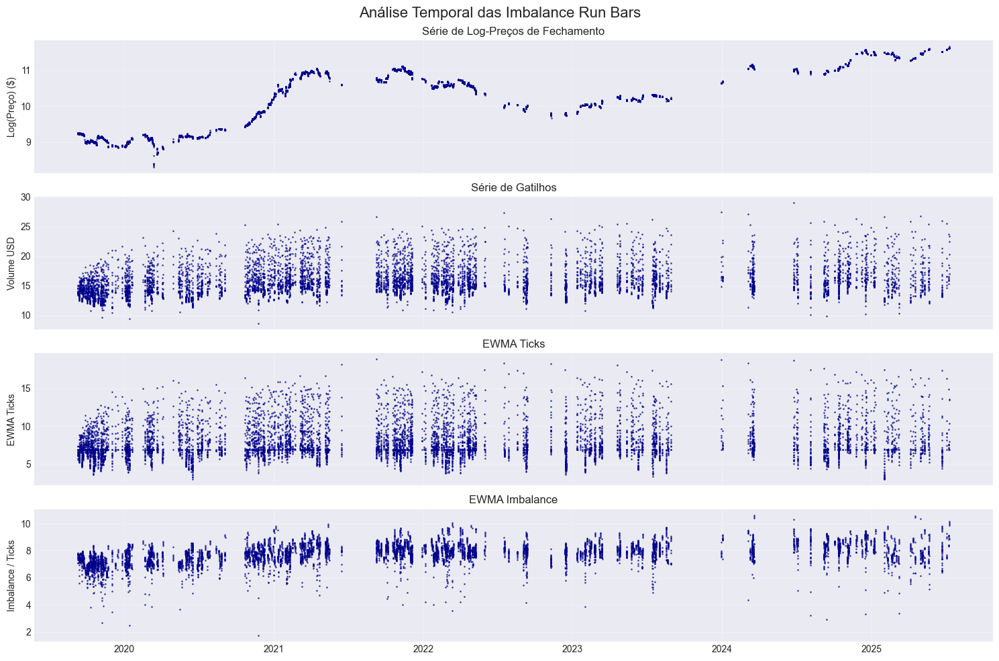

ANÁLISE DE DOLLAR IMBALANCE BARS - METODOLOGIA LOPEZ DE PRADO
SAMPLE - ./output/20250903-063048-imbalance-futures-ticks1000-aticks0.4-aimb0.4-treset8.parquet

📊 Dataset carregado: 11,107 barras
📅 Índices: 0 até 11106

📋 Estrutura dos dados:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 11107 entries, 0 to 11106
Data columns (total 13 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   end_time              11107 non-null  datetime64[ns]
 1   open                  11107 non-null  float64       
 2   high                  11107 non-null  float64       
 3   low                   11107 non-null  float64       
 4   close                 11107 non-null  float64       
 5   theta_k               11107 non-null  float64       
 6   total_volume_buy_usd  11107 non-null  float64       
 7   total_volume_usd      11107 non-null  float64       
 8   total_volume          11107 non-null  float64       
 9   ticks  

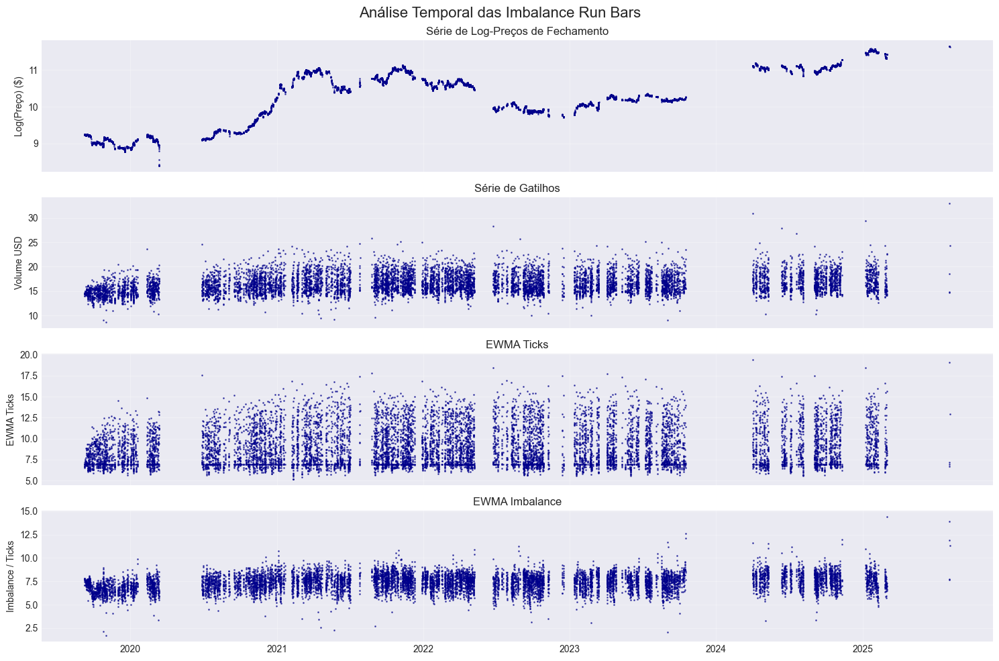

ANÁLISE DE DOLLAR IMBALANCE BARS - METODOLOGIA LOPEZ DE PRADO
SAMPLE - ./output/20250903-070532-imbalance-futures-ticks1000-aticks0.4-aimb0.7-treset3.parquet

📊 Dataset carregado: 21,423 barras
📅 Índices: 0 até 21422

📋 Estrutura dos dados:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21423 entries, 0 to 21422
Data columns (total 13 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   end_time              21423 non-null  datetime64[ns]
 1   open                  21423 non-null  float64       
 2   high                  21423 non-null  float64       
 3   low                   21423 non-null  float64       
 4   close                 21423 non-null  float64       
 5   theta_k               21423 non-null  float64       
 6   total_volume_buy_usd  21423 non-null  float64       
 7   total_volume_usd      21423 non-null  float64       
 8   total_volume          21423 non-null  float64       
 9   ticks  

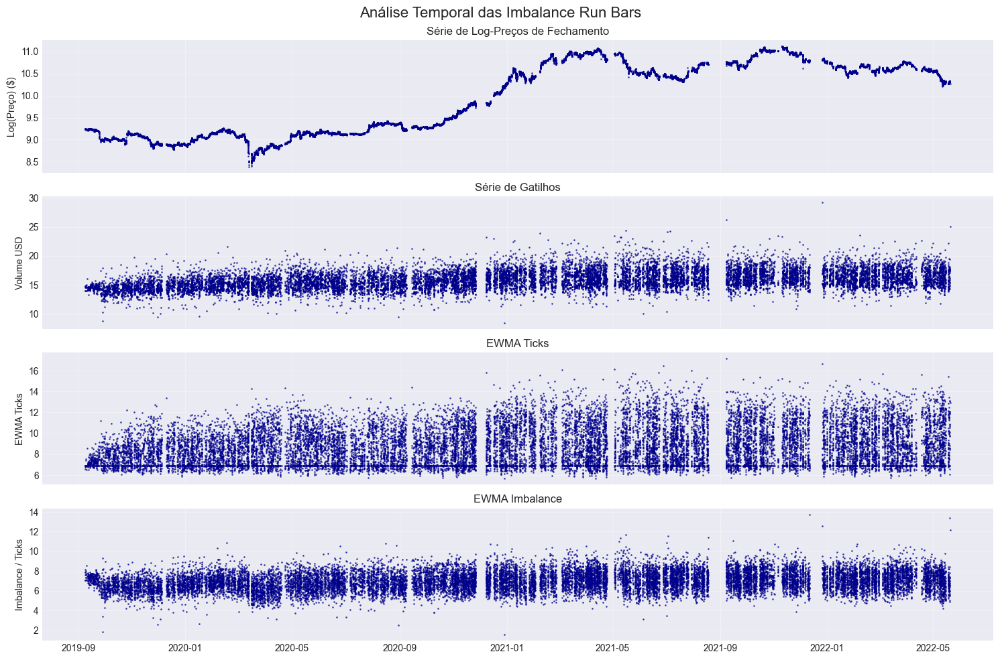

ANÁLISE DE DOLLAR IMBALANCE BARS - METODOLOGIA LOPEZ DE PRADO
SAMPLE - ./output/20250903-111306-imbalance-futures-ticks1000-aticks0.7-aimb0.7-treset7.parquet

📊 Dataset carregado: 14,730 barras
📅 Índices: 0 até 14729

📋 Estrutura dos dados:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 14730 entries, 0 to 14729
Data columns (total 13 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   end_time              14730 non-null  datetime64[ns]
 1   open                  14730 non-null  float64       
 2   high                  14730 non-null  float64       
 3   low                   14730 non-null  float64       
 4   close                 14730 non-null  float64       
 5   theta_k               14730 non-null  float64       
 6   total_volume_buy_usd  14730 non-null  float64       
 7   total_volume_usd      14730 non-null  float64       
 8   total_volume          14730 non-null  float64       
 9   ticks  

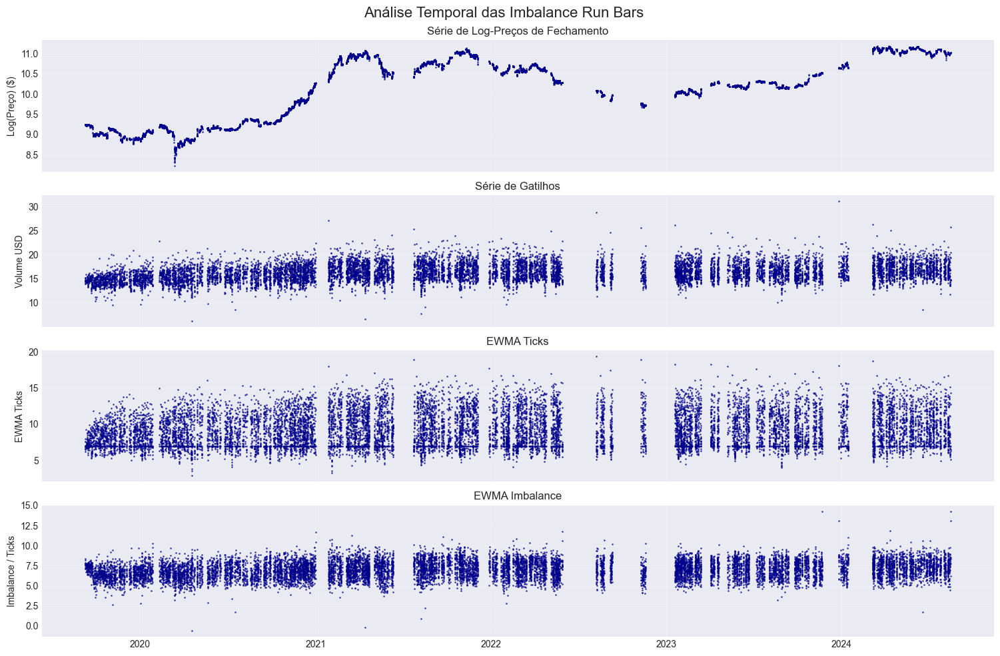

ANÁLISE DE DOLLAR IMBALANCE BARS - METODOLOGIA LOPEZ DE PRADO
SAMPLE - ./output/20250903-084956-imbalance-futures-ticks1000-aticks0.7-aimb0.1-treset8.parquet

📊 Dataset carregado: 2,878 barras
📅 Índices: 0 até 2877

📋 Estrutura dos dados:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2878 entries, 0 to 2877
Data columns (total 13 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   end_time              2878 non-null   datetime64[ns]
 1   open                  2878 non-null   float64       
 2   high                  2878 non-null   float64       
 3   low                   2878 non-null   float64       
 4   close                 2878 non-null   float64       
 5   theta_k               2878 non-null   float64       
 6   total_volume_buy_usd  2878 non-null   float64       
 7   total_volume_usd      2878 non-null   float64       
 8   total_volume          2878 non-null   float64       
 9   ticks      

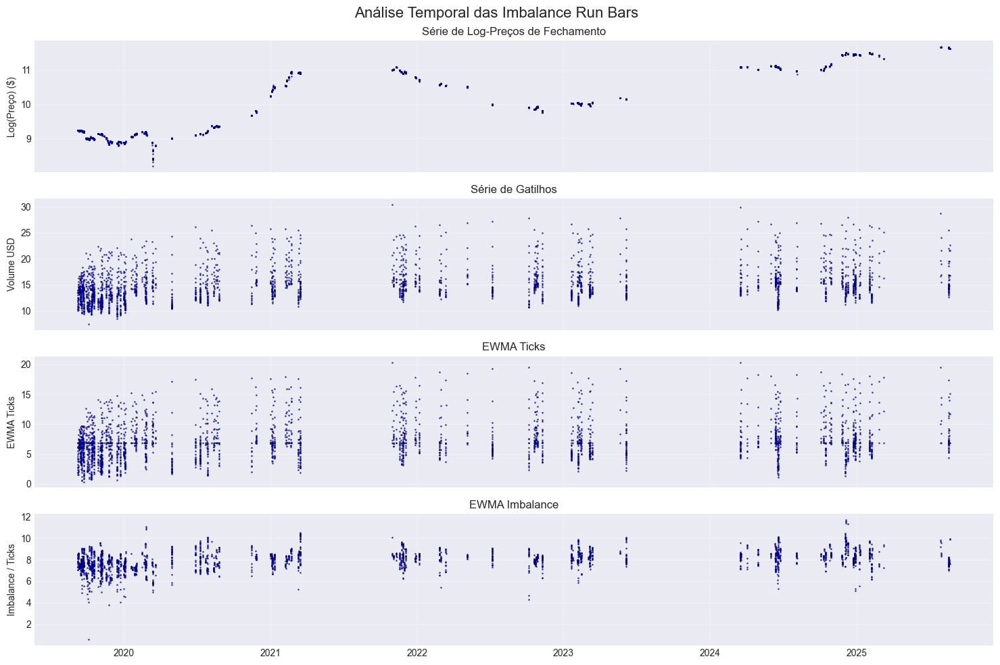

ANÁLISE DE DOLLAR IMBALANCE BARS - METODOLOGIA LOPEZ DE PRADO
SAMPLE - ./output/20250903-074016-imbalance-futures-ticks1000-aticks0.4-aimb0.7-treset8.parquet

📊 Dataset carregado: 19,671 barras
📅 Índices: 0 até 19670

📋 Estrutura dos dados:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 19671 entries, 0 to 19670
Data columns (total 13 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   end_time              19671 non-null  datetime64[ns]
 1   open                  19671 non-null  float64       
 2   high                  19671 non-null  float64       
 3   low                   19671 non-null  float64       
 4   close                 19671 non-null  float64       
 5   theta_k               19671 non-null  float64       
 6   total_volume_buy_usd  19671 non-null  float64       
 7   total_volume_usd      19671 non-null  float64       
 8   total_volume          19671 non-null  float64       
 9   ticks  

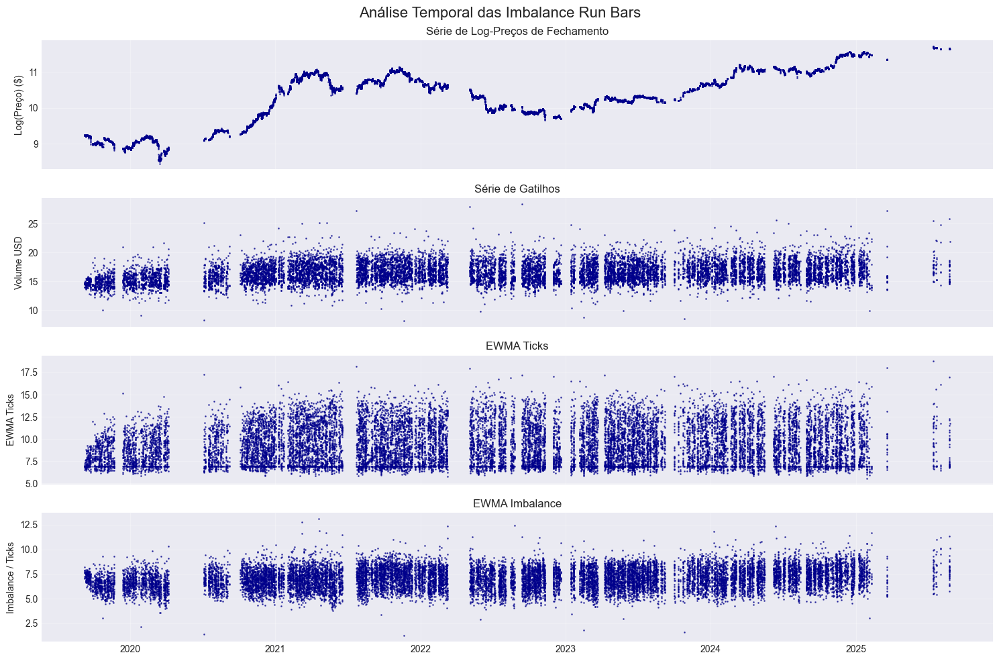

ANÁLISE DE DOLLAR IMBALANCE BARS - METODOLOGIA LOPEZ DE PRADO
SAMPLE - ./output/20250903-020720-imbalance-futures-ticks1000-aticks0.1-aimb0.1-treset10.parquet

📊 Dataset carregado: 18,556 barras
📅 Índices: 0 até 18555

📋 Estrutura dos dados:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 18556 entries, 0 to 18555
Data columns (total 13 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   end_time              18556 non-null  datetime64[ns]
 1   open                  18556 non-null  float64       
 2   high                  18556 non-null  float64       
 3   low                   18556 non-null  float64       
 4   close                 18556 non-null  float64       
 5   theta_k               18556 non-null  float64       
 6   total_volume_buy_usd  18556 non-null  float64       
 7   total_volume_usd      18556 non-null  float64       
 8   total_volume          18556 non-null  float64       
 9   ticks 

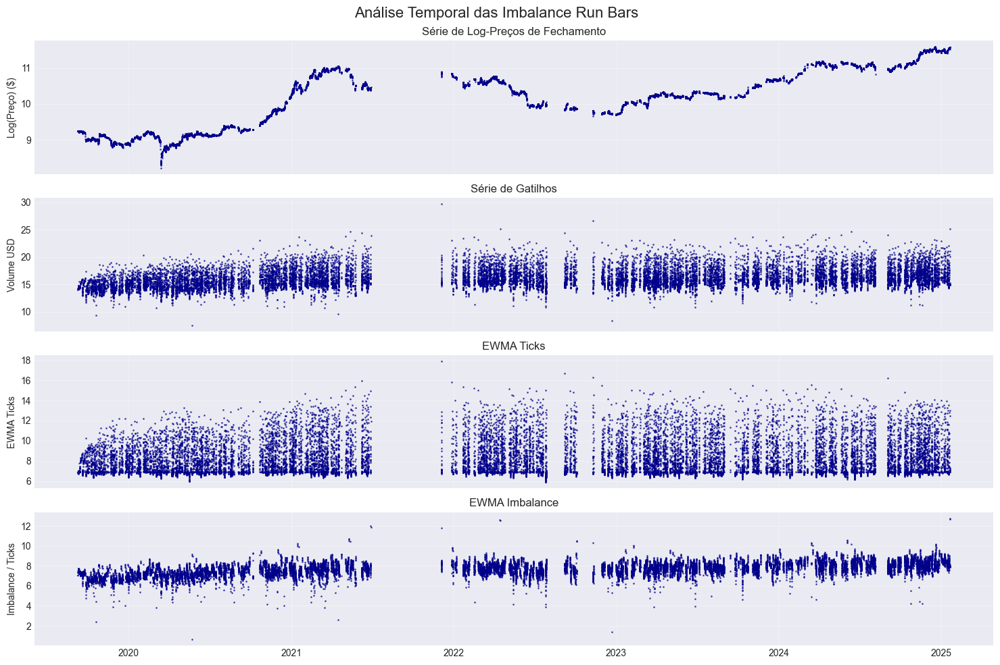

ANÁLISE DE DOLLAR IMBALANCE BARS - METODOLOGIA LOPEZ DE PRADO
SAMPLE - ./output/20250903-060953-imbalance-futures-ticks1000-aticks0.4-aimb0.4-treset5.parquet

📊 Dataset carregado: 11,361 barras
📅 Índices: 0 até 11360

📋 Estrutura dos dados:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 11361 entries, 0 to 11360
Data columns (total 13 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   end_time              11361 non-null  datetime64[ns]
 1   open                  11361 non-null  float64       
 2   high                  11361 non-null  float64       
 3   low                   11361 non-null  float64       
 4   close                 11361 non-null  float64       
 5   theta_k               11361 non-null  float64       
 6   total_volume_buy_usd  11361 non-null  float64       
 7   total_volume_usd      11361 non-null  float64       
 8   total_volume          11361 non-null  float64       
 9   ticks  

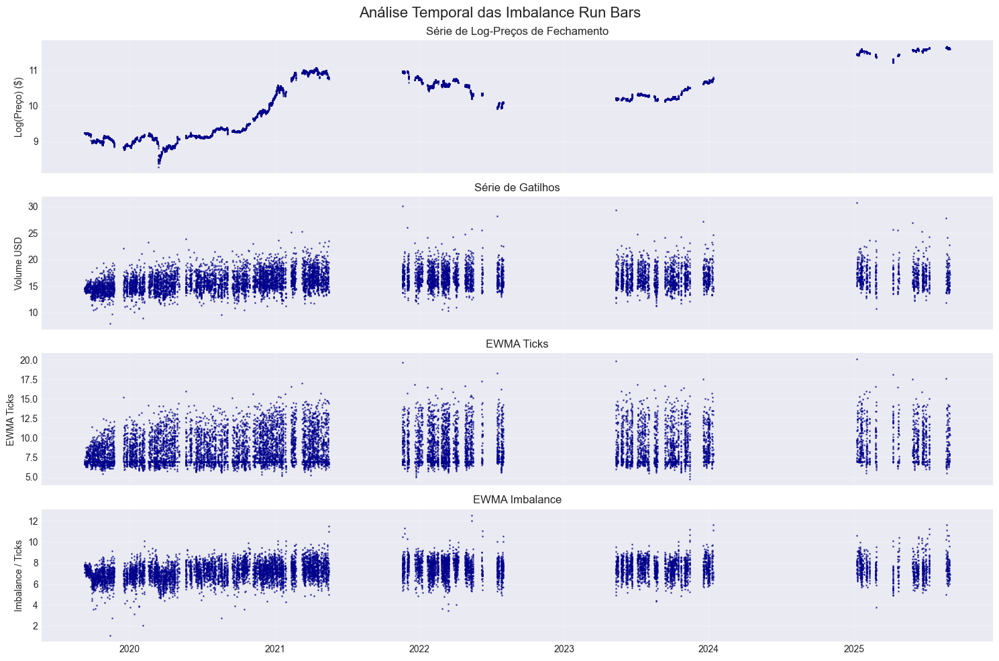

ANÁLISE DE DOLLAR IMBALANCE BARS - METODOLOGIA LOPEZ DE PRADO
SAMPLE - ./output/20250903-100156-imbalance-futures-ticks1000-aticks0.7-aimb0.4-treset8.parquet

📊 Dataset carregado: 5,451 barras
📅 Índices: 0 até 5450

📋 Estrutura dos dados:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5451 entries, 0 to 5450
Data columns (total 13 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   end_time              5451 non-null   datetime64[ns]
 1   open                  5451 non-null   float64       
 2   high                  5451 non-null   float64       
 3   low                   5451 non-null   float64       
 4   close                 5451 non-null   float64       
 5   theta_k               5451 non-null   float64       
 6   total_volume_buy_usd  5451 non-null   float64       
 7   total_volume_usd      5451 non-null   float64       
 8   total_volume          5451 non-null   float64       
 9   ticks      

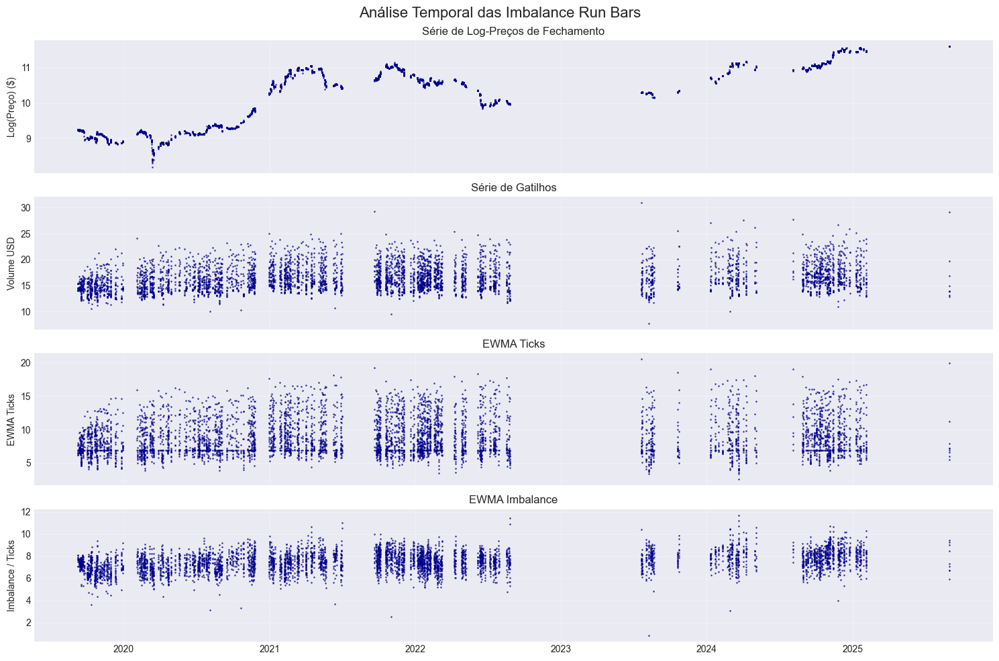

ANÁLISE DE DOLLAR IMBALANCE BARS - METODOLOGIA LOPEZ DE PRADO
SAMPLE - ./output/20250903-080107-imbalance-futures-ticks1000-aticks0.7-aimb0.1-treset1.parquet

📊 Dataset carregado: 17,656 barras
📅 Índices: 0 até 17655

📋 Estrutura dos dados:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 17656 entries, 0 to 17655
Data columns (total 13 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   end_time              17656 non-null  datetime64[ns]
 1   open                  17656 non-null  float64       
 2   high                  17656 non-null  float64       
 3   low                   17656 non-null  float64       
 4   close                 17656 non-null  float64       
 5   theta_k               17656 non-null  float64       
 6   total_volume_buy_usd  17656 non-null  float64       
 7   total_volume_usd      17656 non-null  float64       
 8   total_volume          17656 non-null  float64       
 9   ticks  

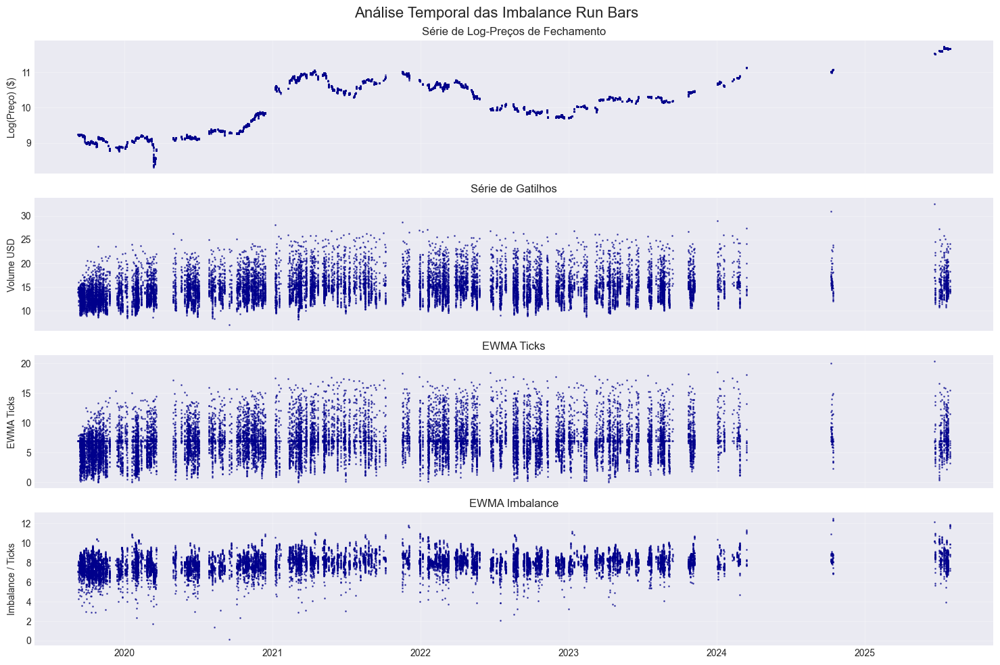

ANÁLISE DE DOLLAR IMBALANCE BARS - METODOLOGIA LOPEZ DE PRADO
SAMPLE - ./output/20250903-112115-imbalance-futures-ticks1000-aticks0.7-aimb0.7-treset8.parquet

📊 Dataset carregado: 6,874 barras
📅 Índices: 0 até 6873

📋 Estrutura dos dados:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6874 entries, 0 to 6873
Data columns (total 13 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   end_time              6874 non-null   datetime64[ns]
 1   open                  6874 non-null   float64       
 2   high                  6874 non-null   float64       
 3   low                   6874 non-null   float64       
 4   close                 6874 non-null   float64       
 5   theta_k               6874 non-null   float64       
 6   total_volume_buy_usd  6874 non-null   float64       
 7   total_volume_usd      6874 non-null   float64       
 8   total_volume          6874 non-null   float64       
 9   ticks      

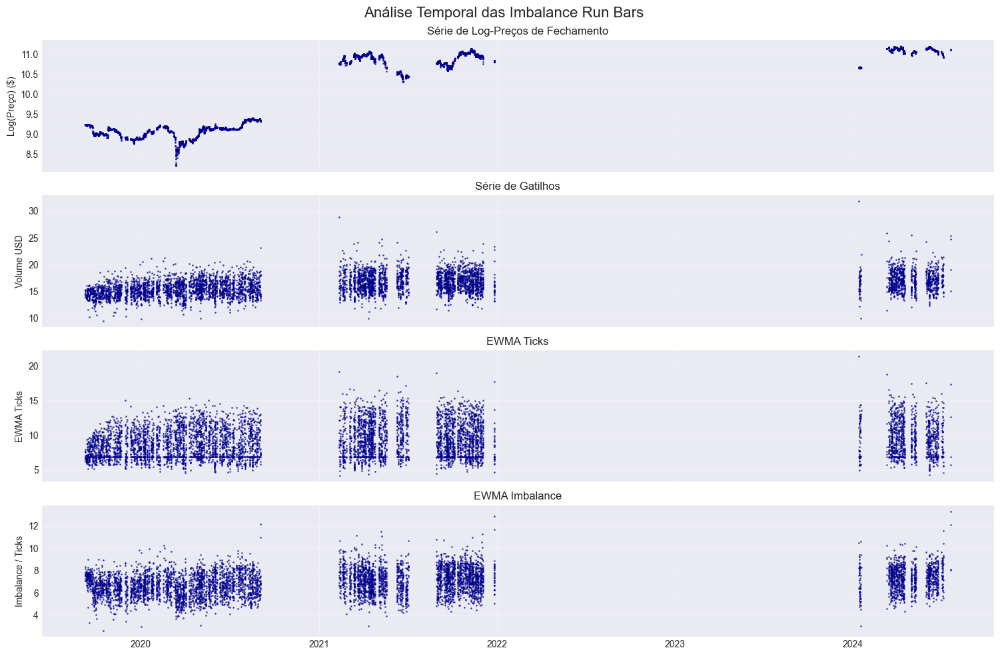

ANÁLISE DE DOLLAR IMBALANCE BARS - METODOLOGIA LOPEZ DE PRADO
SAMPLE - ./output/20250903-064441-imbalance-futures-ticks1000-aticks0.4-aimb0.4-treset10.parquet

📊 Dataset carregado: 5,710 barras
📅 Índices: 0 até 5709

📋 Estrutura dos dados:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5710 entries, 0 to 5709
Data columns (total 13 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   end_time              5710 non-null   datetime64[ns]
 1   open                  5710 non-null   float64       
 2   high                  5710 non-null   float64       
 3   low                   5710 non-null   float64       
 4   close                 5710 non-null   float64       
 5   theta_k               5710 non-null   float64       
 6   total_volume_buy_usd  5710 non-null   float64       
 7   total_volume_usd      5710 non-null   float64       
 8   total_volume          5710 non-null   float64       
 9   ticks     

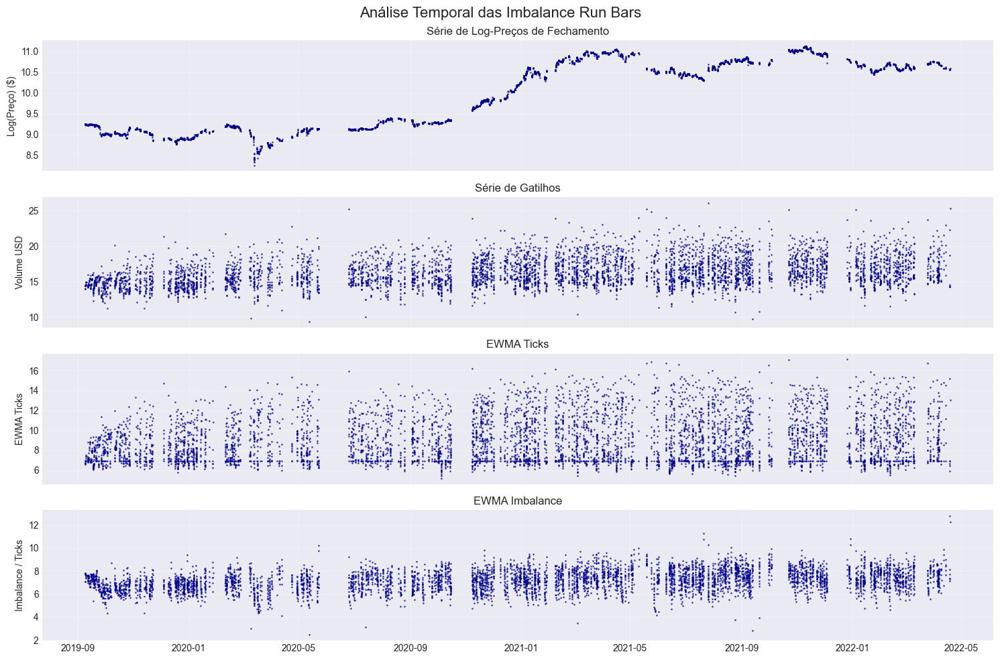

ANÁLISE DE DOLLAR IMBALANCE BARS - METODOLOGIA LOPEZ DE PRADO
SAMPLE - ./output/20250903-071230-imbalance-futures-ticks1000-aticks0.4-aimb0.7-treset4.parquet

📊 Dataset carregado: 19,565 barras
📅 Índices: 0 até 19564

📋 Estrutura dos dados:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 19565 entries, 0 to 19564
Data columns (total 13 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   end_time              19565 non-null  datetime64[ns]
 1   open                  19565 non-null  float64       
 2   high                  19565 non-null  float64       
 3   low                   19565 non-null  float64       
 4   close                 19565 non-null  float64       
 5   theta_k               19565 non-null  float64       
 6   total_volume_buy_usd  19565 non-null  float64       
 7   total_volume_usd      19565 non-null  float64       
 8   total_volume          19565 non-null  float64       
 9   ticks  

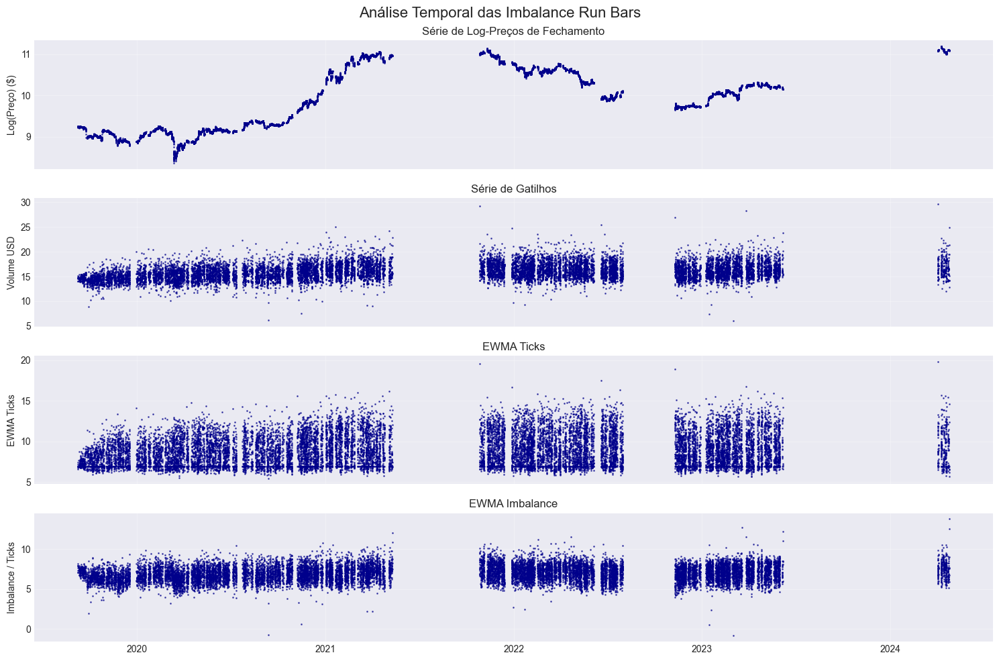

ANÁLISE DE DOLLAR IMBALANCE BARS - METODOLOGIA LOPEZ DE PRADO
SAMPLE - ./output/20250903-054902-imbalance-futures-ticks1000-aticks0.4-aimb0.4-treset2.parquet

📊 Dataset carregado: 35,055 barras
📅 Índices: 0 até 35054

📋 Estrutura dos dados:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 35055 entries, 0 to 35054
Data columns (total 13 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   end_time              35055 non-null  datetime64[ns]
 1   open                  35055 non-null  float64       
 2   high                  35055 non-null  float64       
 3   low                   35055 non-null  float64       
 4   close                 35055 non-null  float64       
 5   theta_k               35055 non-null  float64       
 6   total_volume_buy_usd  35055 non-null  float64       
 7   total_volume_usd      35055 non-null  float64       
 8   total_volume          35055 non-null  float64       
 9   ticks  

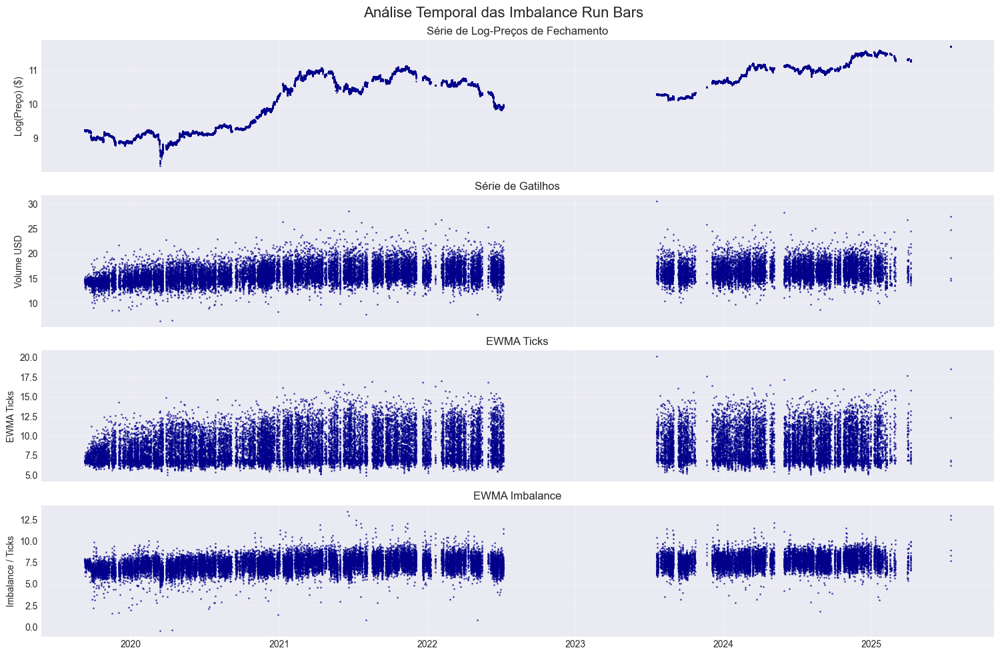

ANÁLISE DE DOLLAR IMBALANCE BARS - METODOLOGIA LOPEZ DE PRADO
SAMPLE - ./output/20250903-040503-imbalance-futures-ticks1000-aticks0.1-aimb0.7-treset7.parquet

📊 Dataset carregado: 34,373 barras
📅 Índices: 0 até 34372

📋 Estrutura dos dados:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 34373 entries, 0 to 34372
Data columns (total 13 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   end_time              34373 non-null  datetime64[ns]
 1   open                  34373 non-null  float64       
 2   high                  34373 non-null  float64       
 3   low                   34373 non-null  float64       
 4   close                 34373 non-null  float64       
 5   theta_k               34373 non-null  float64       
 6   total_volume_buy_usd  34373 non-null  float64       
 7   total_volume_usd      34373 non-null  float64       
 8   total_volume          34373 non-null  float64       
 9   ticks  

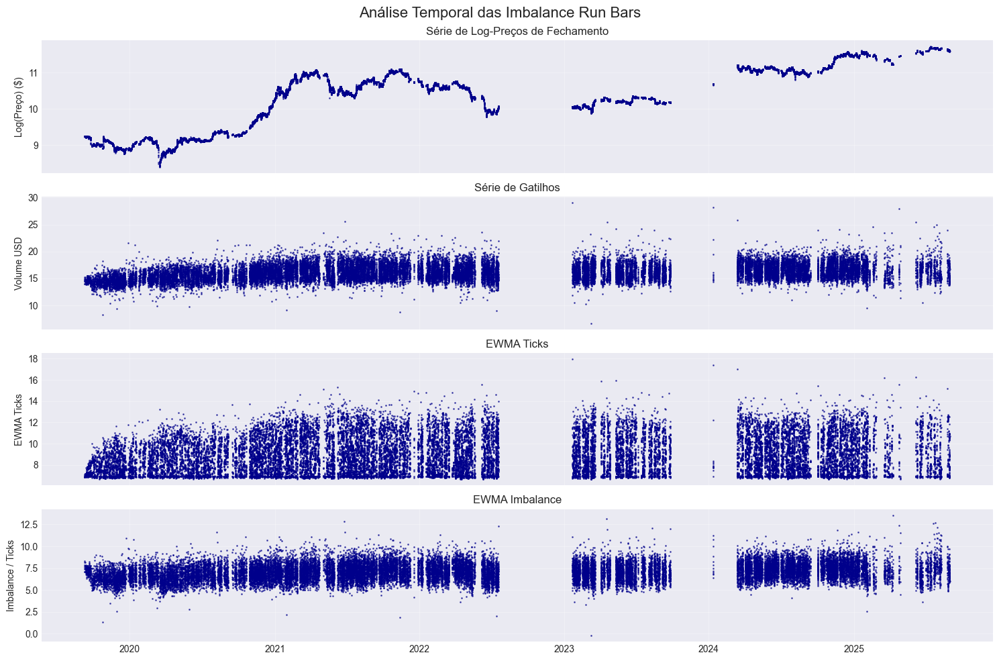

ANÁLISE DE DOLLAR IMBALANCE BARS - METODOLOGIA LOPEZ DE PRADO
SAMPLE - ./output/20250903-021412-imbalance-futures-ticks1000-aticks0.1-aimb0.4-treset1.parquet

📊 Dataset carregado: 174,474 barras
📅 Índices: 0 até 174473

📋 Estrutura dos dados:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 174474 entries, 0 to 174473
Data columns (total 13 columns):
 #   Column                Non-Null Count   Dtype         
---  ------                --------------   -----         
 0   end_time              174474 non-null  datetime64[ns]
 1   open                  174474 non-null  float64       
 2   high                  174474 non-null  float64       
 3   low                   174474 non-null  float64       
 4   close                 174474 non-null  float64       
 5   theta_k               174474 non-null  float64       
 6   total_volume_buy_usd  174474 non-null  float64       
 7   total_volume_usd      174474 non-null  float64       
 8   total_volume          174474 non-null  float64     

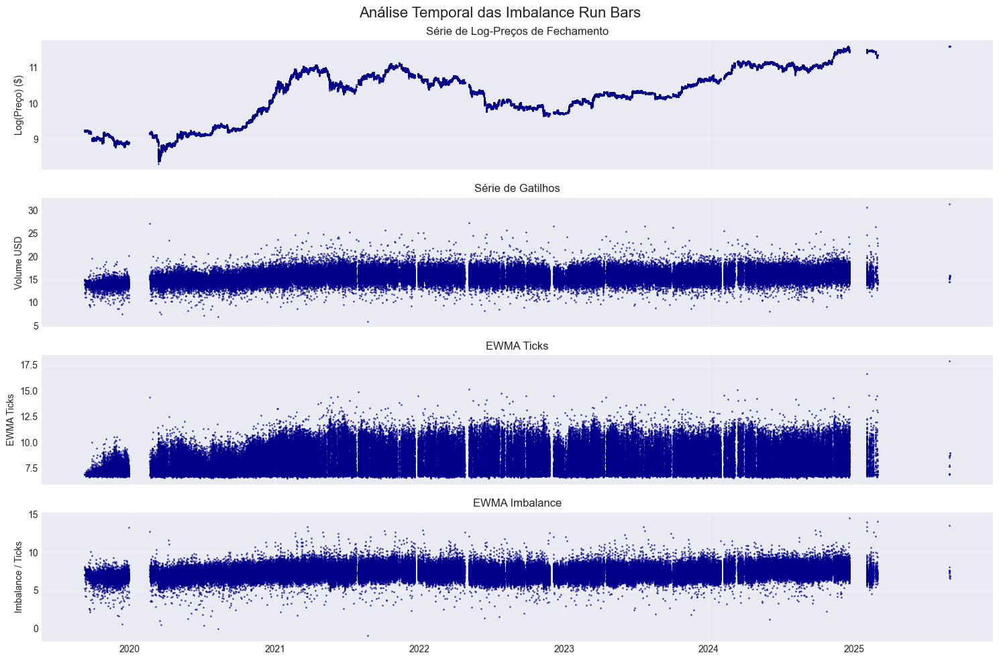

ANÁLISE DE DOLLAR IMBALANCE BARS - METODOLOGIA LOPEZ DE PRADO
SAMPLE - ./output/20250903-052119-imbalance-futures-ticks1000-aticks0.4-aimb0.1-treset8.parquet

📊 Dataset carregado: 5,329 barras
📅 Índices: 0 até 5328

📋 Estrutura dos dados:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5329 entries, 0 to 5328
Data columns (total 13 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   end_time              5329 non-null   datetime64[ns]
 1   open                  5329 non-null   float64       
 2   high                  5329 non-null   float64       
 3   low                   5329 non-null   float64       
 4   close                 5329 non-null   float64       
 5   theta_k               5329 non-null   float64       
 6   total_volume_buy_usd  5329 non-null   float64       
 7   total_volume_usd      5329 non-null   float64       
 8   total_volume          5329 non-null   float64       
 9   ticks      

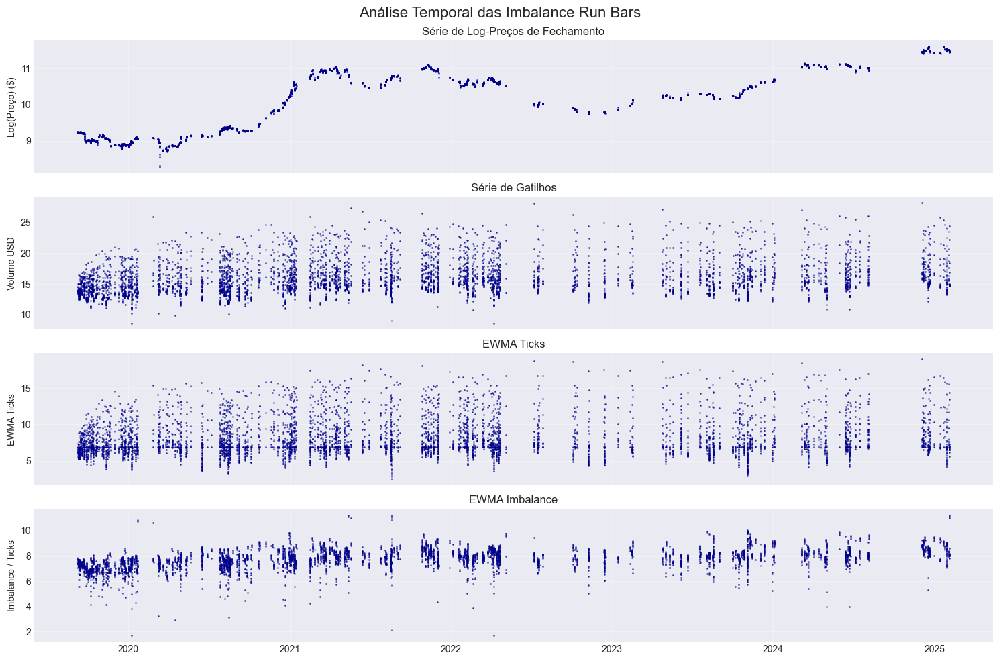

ANÁLISE DE DOLLAR IMBALANCE BARS - METODOLOGIA LOPEZ DE PRADO
SAMPLE - ./output/20250903-110458-imbalance-futures-ticks1000-aticks0.7-aimb0.7-treset6.parquet

📊 Dataset carregado: 18,214 barras
📅 Índices: 0 até 18213

📋 Estrutura dos dados:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 18214 entries, 0 to 18213
Data columns (total 13 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   end_time              18214 non-null  datetime64[ns]
 1   open                  18214 non-null  float64       
 2   high                  18214 non-null  float64       
 3   low                   18214 non-null  float64       
 4   close                 18214 non-null  float64       
 5   theta_k               18214 non-null  float64       
 6   total_volume_buy_usd  18214 non-null  float64       
 7   total_volume_usd      18214 non-null  float64       
 8   total_volume          18214 non-null  float64       
 9   ticks  

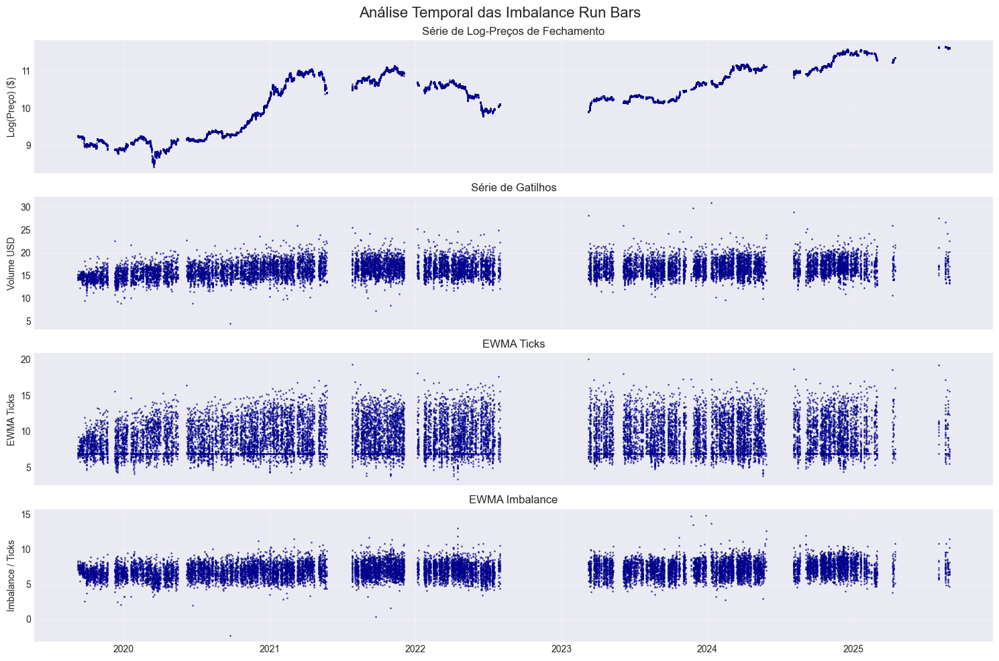

ANÁLISE DE DOLLAR IMBALANCE BARS - METODOLOGIA LOPEZ DE PRADO
SAMPLE - ./output/20250903-062351-imbalance-futures-ticks1000-aticks0.4-aimb0.4-treset7.parquet

📊 Dataset carregado: 8,974 barras
📅 Índices: 0 até 8973

📋 Estrutura dos dados:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8974 entries, 0 to 8973
Data columns (total 13 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   end_time              8974 non-null   datetime64[ns]
 1   open                  8974 non-null   float64       
 2   high                  8974 non-null   float64       
 3   low                   8974 non-null   float64       
 4   close                 8974 non-null   float64       
 5   theta_k               8974 non-null   float64       
 6   total_volume_buy_usd  8974 non-null   float64       
 7   total_volume_usd      8974 non-null   float64       
 8   total_volume          8974 non-null   float64       
 9   ticks      

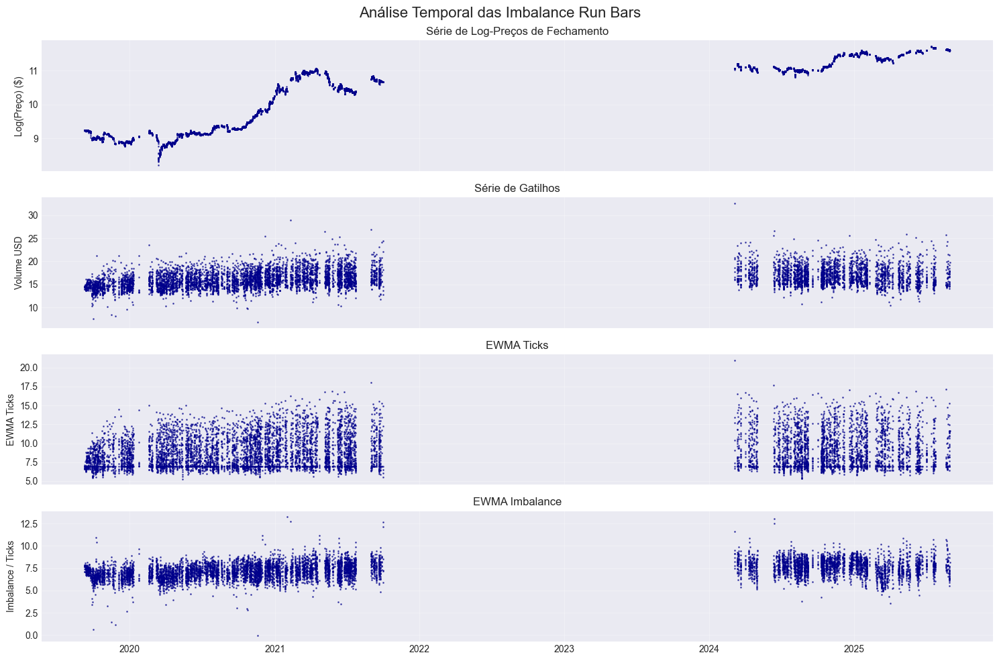

ANÁLISE DE DOLLAR IMBALANCE BARS - METODOLOGIA LOPEZ DE PRADO
SAMPLE - ./output/20250903-015331-imbalance-futures-ticks1000-aticks0.1-aimb0.1-treset8.parquet

📊 Dataset carregado: 17,712 barras
📅 Índices: 0 até 17711

📋 Estrutura dos dados:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 17712 entries, 0 to 17711
Data columns (total 13 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   end_time              17712 non-null  datetime64[ns]
 1   open                  17712 non-null  float64       
 2   high                  17712 non-null  float64       
 3   low                   17712 non-null  float64       
 4   close                 17712 non-null  float64       
 5   theta_k               17712 non-null  float64       
 6   total_volume_buy_usd  17712 non-null  float64       
 7   total_volume_usd      17712 non-null  float64       
 8   total_volume          17712 non-null  float64       
 9   ticks  

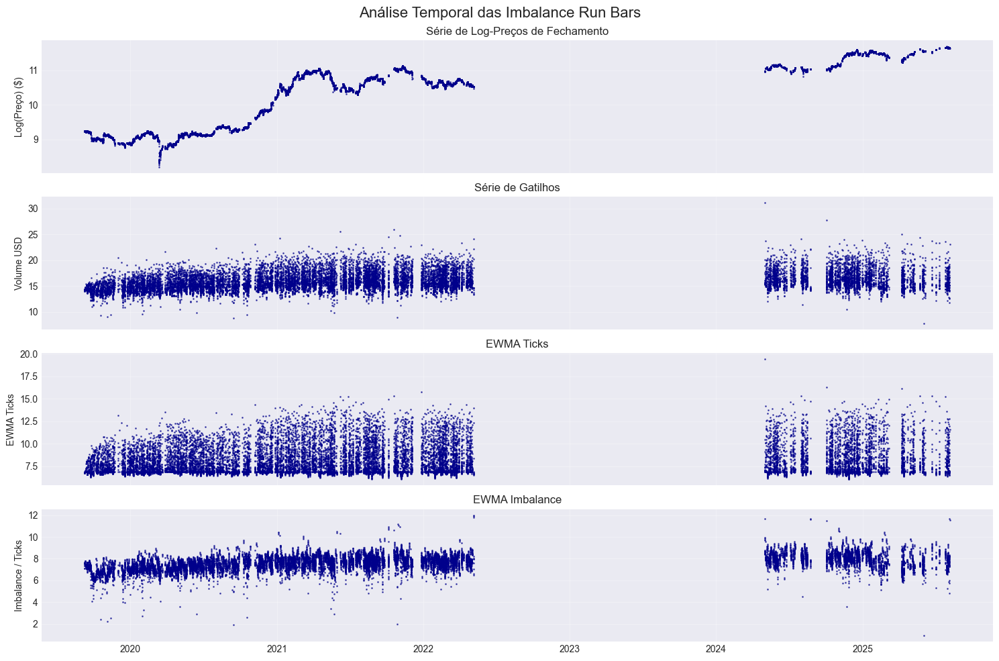

ANÁLISE DE DOLLAR IMBALANCE BARS - METODOLOGIA LOPEZ DE PRADO
SAMPLE - ./output/20250903-043942-imbalance-futures-ticks1000-aticks0.4-aimb0.1-treset2.parquet

📊 Dataset carregado: 19,705 barras
📅 Índices: 0 até 19704

📋 Estrutura dos dados:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 19705 entries, 0 to 19704
Data columns (total 13 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   end_time              19705 non-null  datetime64[ns]
 1   open                  19705 non-null  float64       
 2   high                  19705 non-null  float64       
 3   low                   19705 non-null  float64       
 4   close                 19705 non-null  float64       
 5   theta_k               19705 non-null  float64       
 6   total_volume_buy_usd  19705 non-null  float64       
 7   total_volume_usd      19705 non-null  float64       
 8   total_volume          19705 non-null  float64       
 9   ticks  

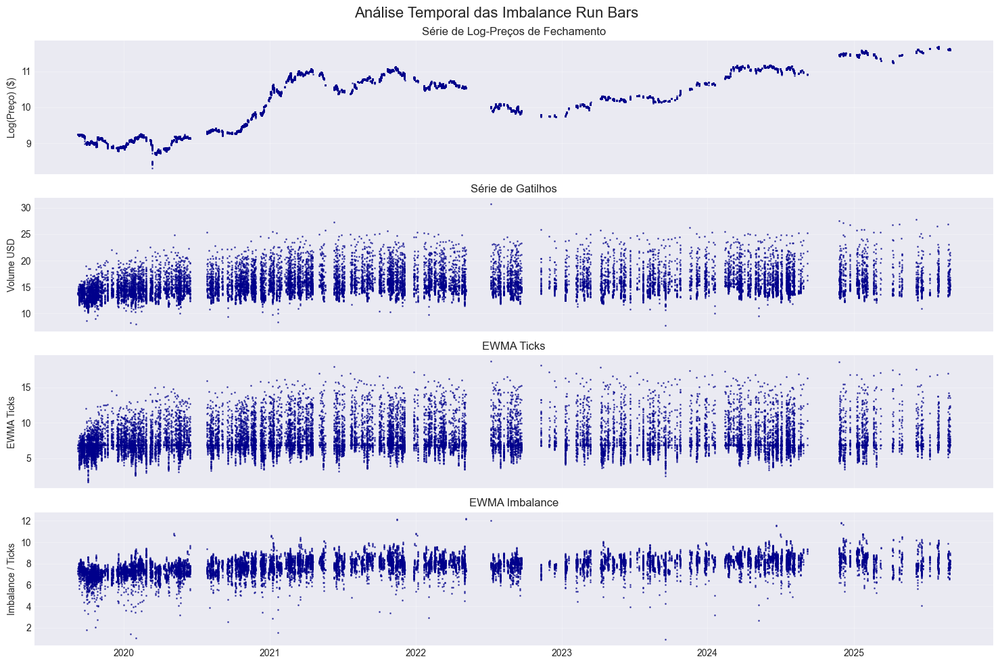

ANÁLISE DE DOLLAR IMBALANCE BARS - METODOLOGIA LOPEZ DE PRADO
SAMPLE - ./output/20250903-101658-imbalance-futures-ticks1000-aticks0.7-aimb0.4-treset10.parquet

📊 Dataset carregado: 4,179 barras
📅 Índices: 0 até 4178

📋 Estrutura dos dados:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4179 entries, 0 to 4178
Data columns (total 13 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   end_time              4179 non-null   datetime64[ns]
 1   open                  4179 non-null   float64       
 2   high                  4179 non-null   float64       
 3   low                   4179 non-null   float64       
 4   close                 4179 non-null   float64       
 5   theta_k               4179 non-null   float64       
 6   total_volume_buy_usd  4179 non-null   float64       
 7   total_volume_usd      4179 non-null   float64       
 8   total_volume          4179 non-null   float64       
 9   ticks     

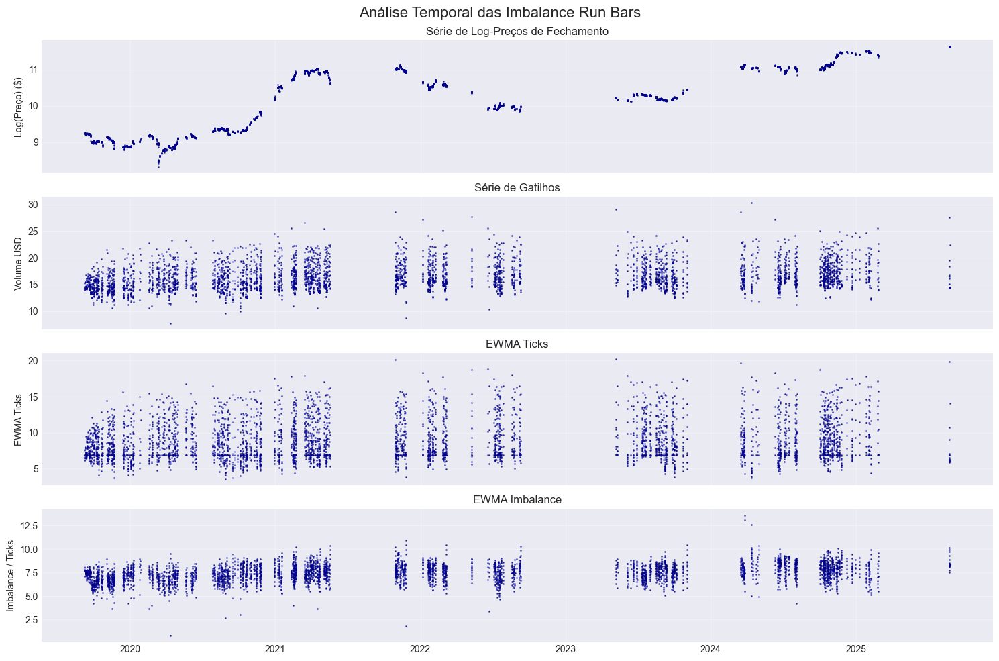

ANÁLISE DE DOLLAR IMBALANCE BARS - METODOLOGIA LOPEZ DE PRADO
SAMPLE - ./output/20250903-113657-imbalance-futures-ticks1000-aticks0.7-aimb0.7-treset10.parquet

📊 Dataset carregado: 13,274 barras
📅 Índices: 0 até 13273

📋 Estrutura dos dados:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 13274 entries, 0 to 13273
Data columns (total 13 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   end_time              13274 non-null  datetime64[ns]
 1   open                  13274 non-null  float64       
 2   high                  13274 non-null  float64       
 3   low                   13274 non-null  float64       
 4   close                 13274 non-null  float64       
 5   theta_k               13274 non-null  float64       
 6   total_volume_buy_usd  13274 non-null  float64       
 7   total_volume_usd      13274 non-null  float64       
 8   total_volume          13274 non-null  float64       
 9   ticks 

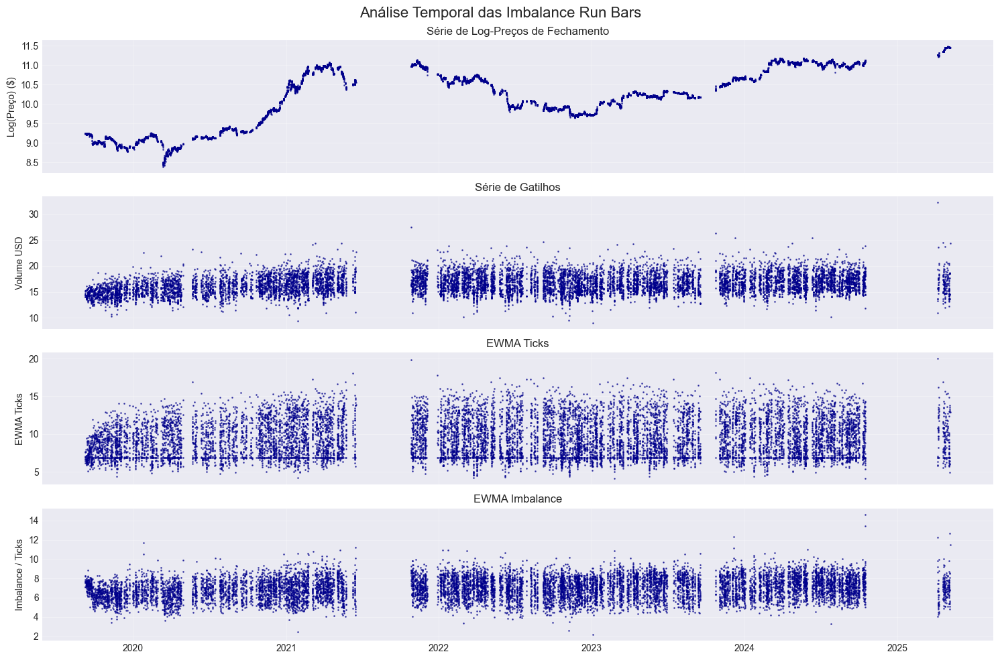

ANÁLISE DE DOLLAR IMBALANCE BARS - METODOLOGIA LOPEZ DE PRADO
SAMPLE - ./output/20250903-052814-imbalance-futures-ticks1000-aticks0.4-aimb0.1-treset9.parquet

📊 Dataset carregado: 4,188 barras
📅 Índices: 0 até 4187

📋 Estrutura dos dados:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4188 entries, 0 to 4187
Data columns (total 13 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   end_time              4188 non-null   datetime64[ns]
 1   open                  4188 non-null   float64       
 2   high                  4188 non-null   float64       
 3   low                   4188 non-null   float64       
 4   close                 4188 non-null   float64       
 5   theta_k               4188 non-null   float64       
 6   total_volume_buy_usd  4188 non-null   float64       
 7   total_volume_usd      4188 non-null   float64       
 8   total_volume          4188 non-null   float64       
 9   ticks      

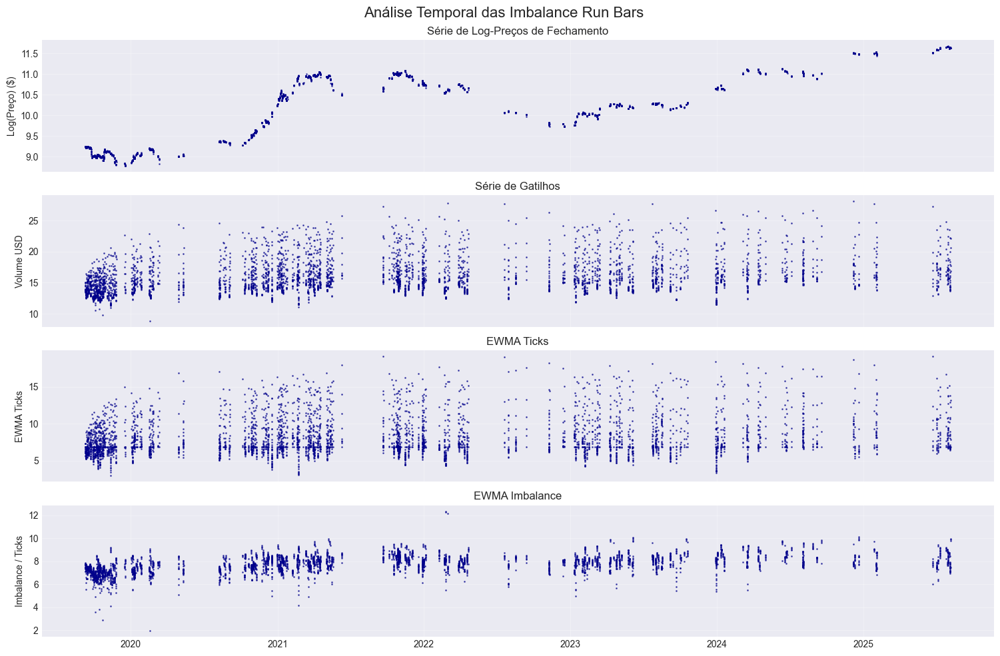

ANÁLISE DE DOLLAR IMBALANCE BARS - METODOLOGIA LOPEZ DE PRADO
SAMPLE - ./output/20250903-012540-imbalance-futures-ticks1000-aticks0.1-aimb0.1-treset4.parquet

📊 Dataset carregado: 46,696 barras
📅 Índices: 0 até 46695

📋 Estrutura dos dados:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 46696 entries, 0 to 46695
Data columns (total 13 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   end_time              46696 non-null  datetime64[ns]
 1   open                  46696 non-null  float64       
 2   high                  46696 non-null  float64       
 3   low                   46696 non-null  float64       
 4   close                 46696 non-null  float64       
 5   theta_k               46696 non-null  float64       
 6   total_volume_buy_usd  46696 non-null  float64       
 7   total_volume_usd      46696 non-null  float64       
 8   total_volume          46696 non-null  float64       
 9   ticks  

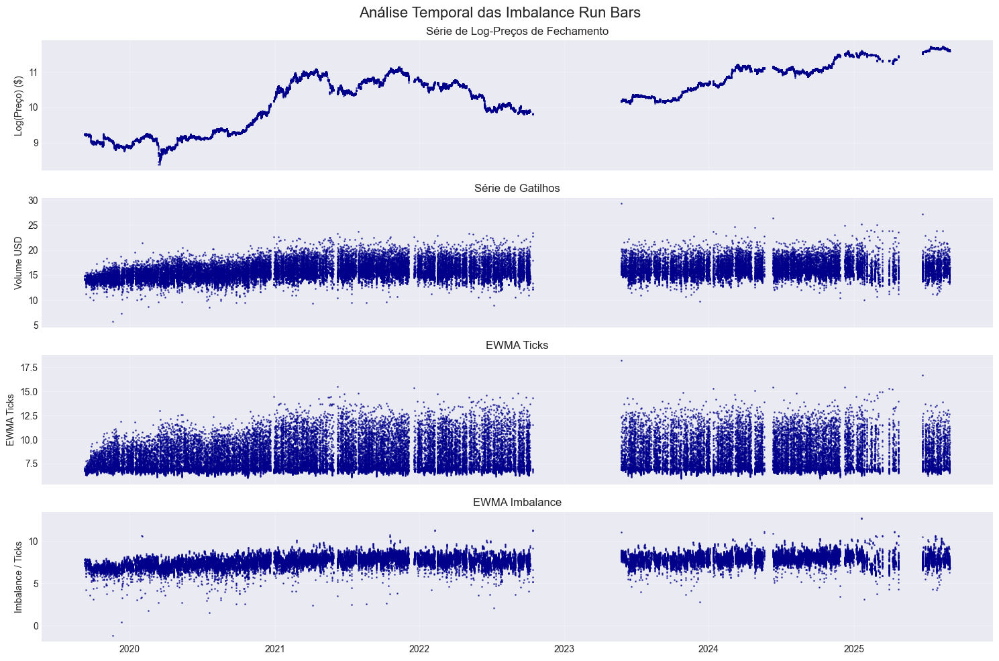

ANÁLISE DE DOLLAR IMBALANCE BARS - METODOLOGIA LOPEZ DE PRADO
SAMPLE - ./output/20250903-030932-imbalance-futures-ticks1000-aticks0.1-aimb0.4-treset9.parquet

📊 Dataset carregado: 23,568 barras
📅 Índices: 0 até 23567

📋 Estrutura dos dados:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 23568 entries, 0 to 23567
Data columns (total 13 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   end_time              23568 non-null  datetime64[ns]
 1   open                  23568 non-null  float64       
 2   high                  23568 non-null  float64       
 3   low                   23568 non-null  float64       
 4   close                 23568 non-null  float64       
 5   theta_k               23568 non-null  float64       
 6   total_volume_buy_usd  23568 non-null  float64       
 7   total_volume_usd      23568 non-null  float64       
 8   total_volume          23568 non-null  float64       
 9   ticks  

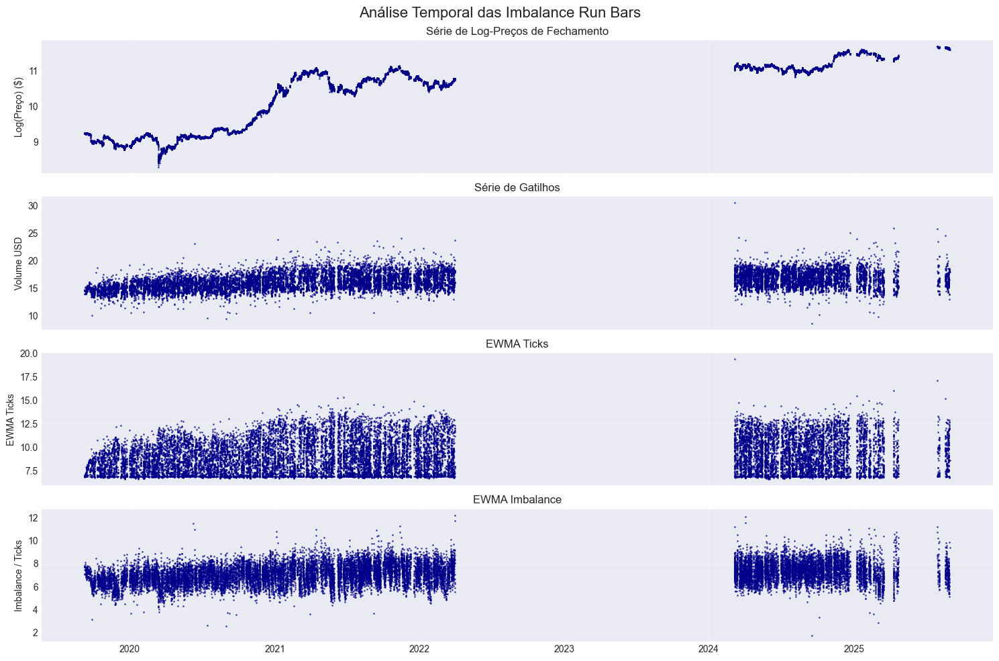

ANÁLISE DE DOLLAR IMBALANCE BARS - METODOLOGIA LOPEZ DE PRADO
SAMPLE - ./output/20250903-095428-imbalance-futures-ticks1000-aticks0.7-aimb0.4-treset7.parquet

📊 Dataset carregado: 3,146 barras
📅 Índices: 0 até 3145

📋 Estrutura dos dados:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3146 entries, 0 to 3145
Data columns (total 13 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   end_time              3146 non-null   datetime64[ns]
 1   open                  3146 non-null   float64       
 2   high                  3146 non-null   float64       
 3   low                   3146 non-null   float64       
 4   close                 3146 non-null   float64       
 5   theta_k               3146 non-null   float64       
 6   total_volume_buy_usd  3146 non-null   float64       
 7   total_volume_usd      3146 non-null   float64       
 8   total_volume          3146 non-null   float64       
 9   ticks      

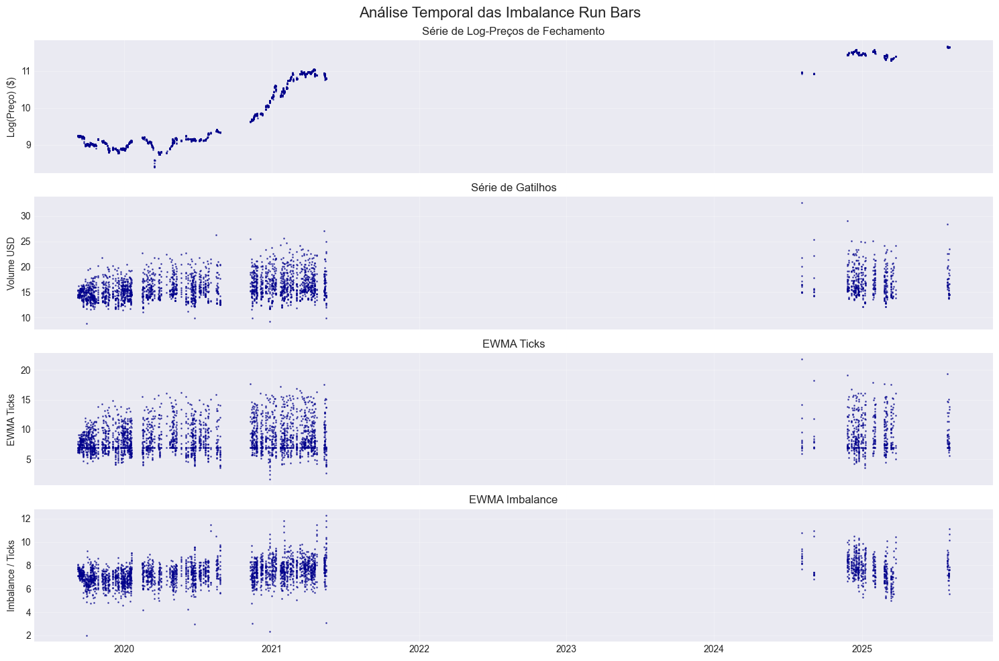

ANÁLISE DE DOLLAR IMBALANCE BARS - METODOLOGIA LOPEZ DE PRADO
SAMPLE - ./output/20250903-010437-imbalance-futures-ticks1000-aticks0.1-aimb0.1-treset1.parquet

📊 Dataset carregado: 170,502 barras
📅 Índices: 0 até 170501

📋 Estrutura dos dados:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 170502 entries, 0 to 170501
Data columns (total 13 columns):
 #   Column                Non-Null Count   Dtype         
---  ------                --------------   -----         
 0   end_time              170502 non-null  datetime64[ns]
 1   open                  170502 non-null  float64       
 2   high                  170502 non-null  float64       
 3   low                   170502 non-null  float64       
 4   close                 170502 non-null  float64       
 5   theta_k               170502 non-null  float64       
 6   total_volume_buy_usd  170502 non-null  float64       
 7   total_volume_usd      170502 non-null  float64       
 8   total_volume          170502 non-null  float64     

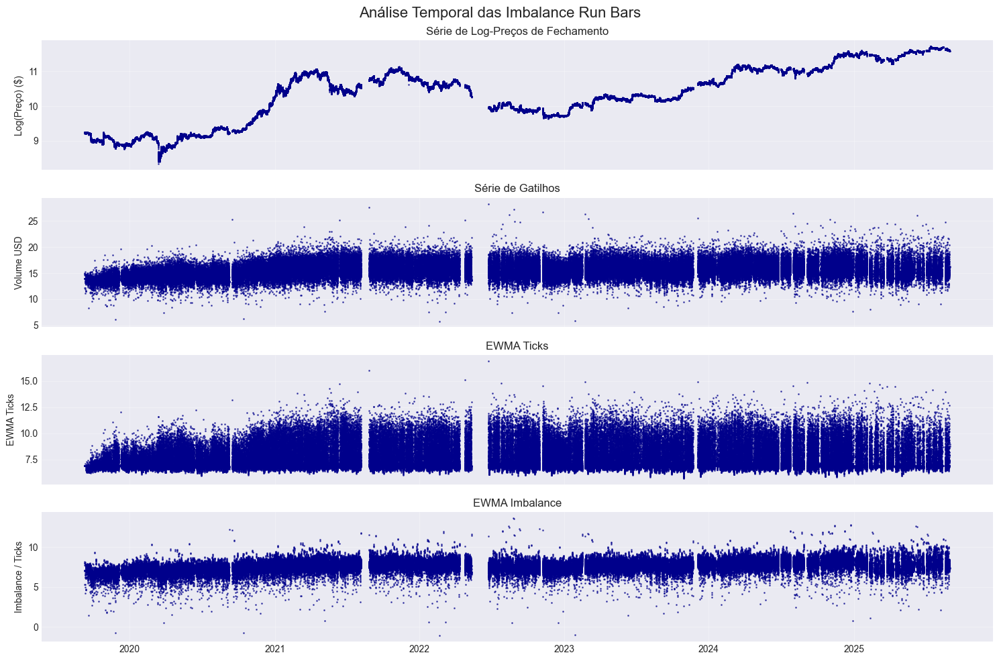

ANÁLISE DE DOLLAR IMBALANCE BARS - METODOLOGIA LOPEZ DE PRADO
SAMPLE - ./output/20250903-094649-imbalance-futures-ticks1000-aticks0.7-aimb0.4-treset6.parquet

📊 Dataset carregado: 6,376 barras
📅 Índices: 0 até 6375

📋 Estrutura dos dados:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6376 entries, 0 to 6375
Data columns (total 13 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   end_time              6376 non-null   datetime64[ns]
 1   open                  6376 non-null   float64       
 2   high                  6376 non-null   float64       
 3   low                   6376 non-null   float64       
 4   close                 6376 non-null   float64       
 5   theta_k               6376 non-null   float64       
 6   total_volume_buy_usd  6376 non-null   float64       
 7   total_volume_usd      6376 non-null   float64       
 8   total_volume          6376 non-null   float64       
 9   ticks      

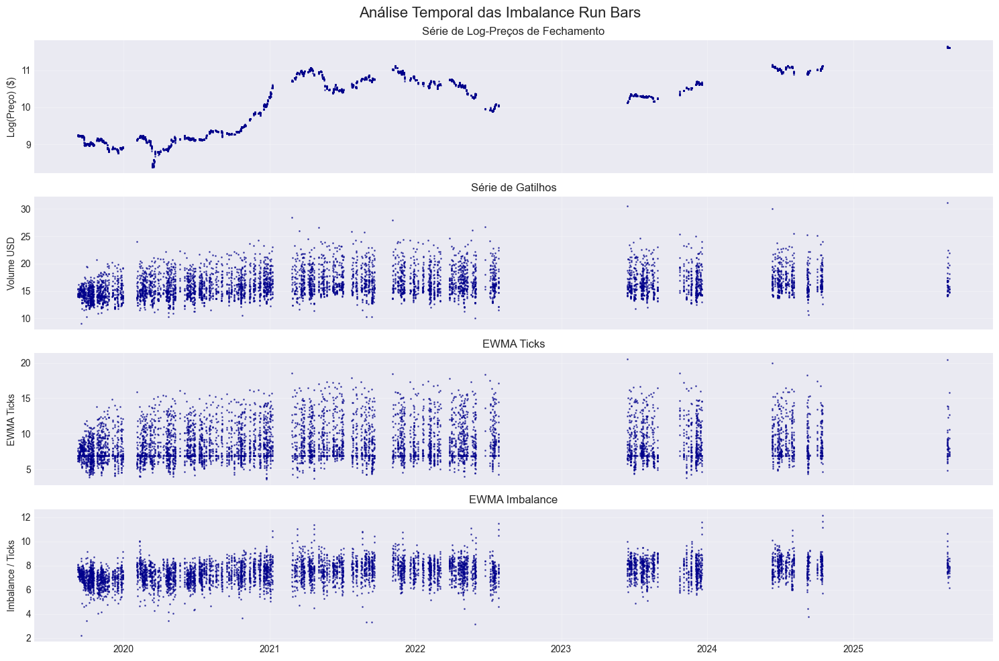

ANÁLISE DE DOLLAR IMBALANCE BARS - METODOLOGIA LOPEZ DE PRADO
SAMPLE - ./output/20250903-044636-imbalance-futures-ticks1000-aticks0.4-aimb0.1-treset3.parquet

📊 Dataset carregado: 12,926 barras
📅 Índices: 0 até 12925

📋 Estrutura dos dados:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 12926 entries, 0 to 12925
Data columns (total 13 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   end_time              12926 non-null  datetime64[ns]
 1   open                  12926 non-null  float64       
 2   high                  12926 non-null  float64       
 3   low                   12926 non-null  float64       
 4   close                 12926 non-null  float64       
 5   theta_k               12926 non-null  float64       
 6   total_volume_buy_usd  12926 non-null  float64       
 7   total_volume_usd      12926 non-null  float64       
 8   total_volume          12926 non-null  float64       
 9   ticks  

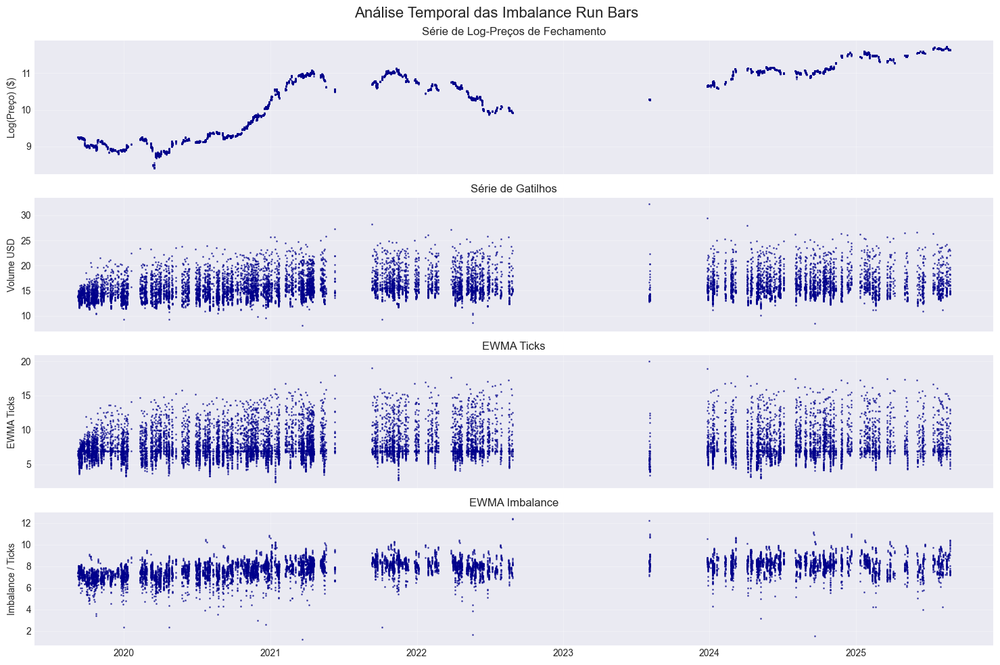

ANÁLISE DE DOLLAR IMBALANCE BARS - METODOLOGIA LOPEZ DE PRADO
SAMPLE - ./output/20250903-104832-imbalance-futures-ticks1000-aticks0.7-aimb0.7-treset4.parquet

📊 Dataset carregado: 24,749 barras
📅 Índices: 0 até 24748

📋 Estrutura dos dados:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 24749 entries, 0 to 24748
Data columns (total 13 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   end_time              24749 non-null  datetime64[ns]
 1   open                  24749 non-null  float64       
 2   high                  24749 non-null  float64       
 3   low                   24749 non-null  float64       
 4   close                 24749 non-null  float64       
 5   theta_k               24749 non-null  float64       
 6   total_volume_buy_usd  24749 non-null  float64       
 7   total_volume_usd      24749 non-null  float64       
 8   total_volume          24749 non-null  float64       
 9   ticks  

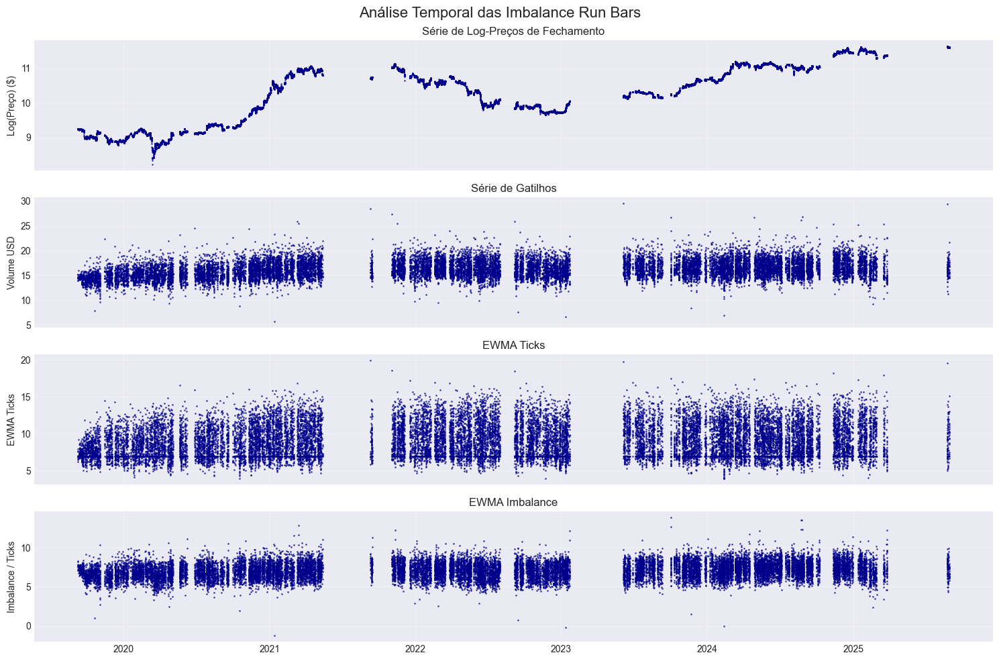

ANÁLISE DE DOLLAR IMBALANCE BARS - METODOLOGIA LOPEZ DE PRADO
SAMPLE - ./output/20250903-054205-imbalance-futures-ticks1000-aticks0.4-aimb0.4-treset1.parquet

📊 Dataset carregado: 78,189 barras
📅 Índices: 0 até 78188

📋 Estrutura dos dados:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 78189 entries, 0 to 78188
Data columns (total 13 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   end_time              78189 non-null  datetime64[ns]
 1   open                  78189 non-null  float64       
 2   high                  78189 non-null  float64       
 3   low                   78189 non-null  float64       
 4   close                 78189 non-null  float64       
 5   theta_k               78189 non-null  float64       
 6   total_volume_buy_usd  78189 non-null  float64       
 7   total_volume_usd      78189 non-null  float64       
 8   total_volume          78189 non-null  float64       
 9   ticks  

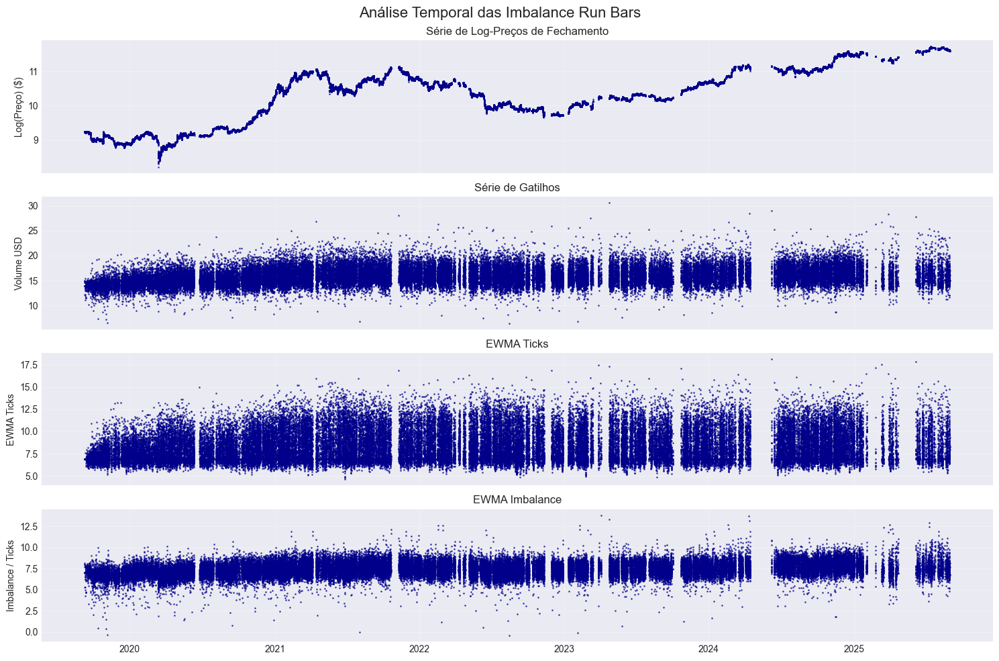

ANÁLISE DE DOLLAR IMBALANCE BARS - METODOLOGIA LOPEZ DE PRADO
SAMPLE - ./output/20250903-080804-imbalance-futures-ticks1000-aticks0.7-aimb0.1-treset2.parquet

📊 Dataset carregado: 8,792 barras
📅 Índices: 0 até 8791

📋 Estrutura dos dados:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8792 entries, 0 to 8791
Data columns (total 13 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   end_time              8792 non-null   datetime64[ns]
 1   open                  8792 non-null   float64       
 2   high                  8792 non-null   float64       
 3   low                   8792 non-null   float64       
 4   close                 8792 non-null   float64       
 5   theta_k               8792 non-null   float64       
 6   total_volume_buy_usd  8792 non-null   float64       
 7   total_volume_usd      8792 non-null   float64       
 8   total_volume          8792 non-null   float64       
 9   ticks      

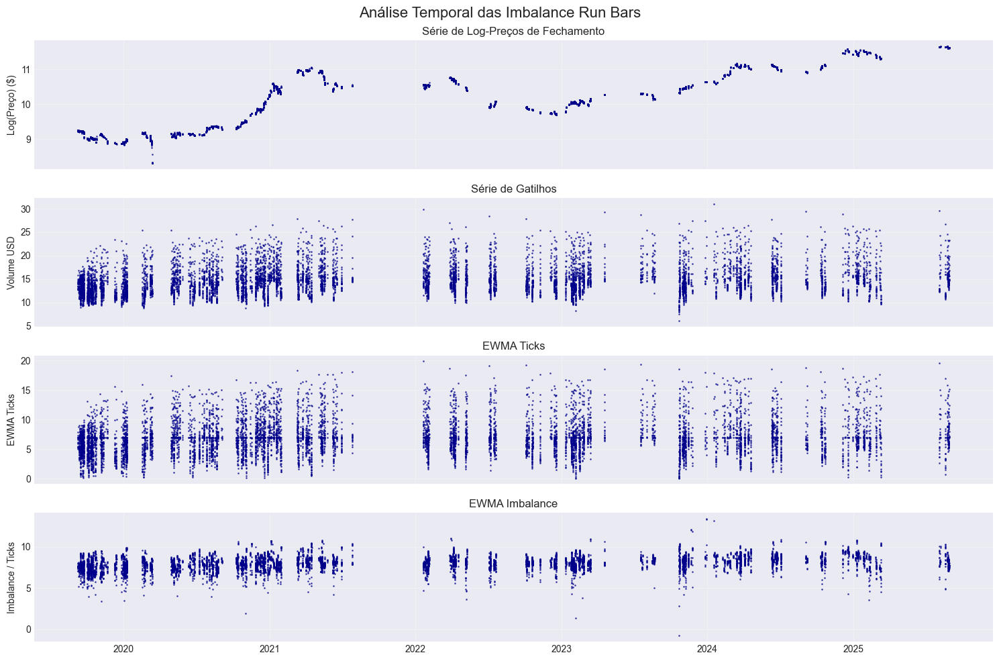

ANÁLISE DE DOLLAR IMBALANCE BARS - METODOLOGIA LOPEZ DE PRADO
SAMPLE - ./output/20250903-074712-imbalance-futures-ticks1000-aticks0.4-aimb0.7-treset9.parquet

📊 Dataset carregado: 17,149 barras
📅 Índices: 0 até 17148

📋 Estrutura dos dados:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 17149 entries, 0 to 17148
Data columns (total 13 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   end_time              17149 non-null  datetime64[ns]
 1   open                  17149 non-null  float64       
 2   high                  17149 non-null  float64       
 3   low                   17149 non-null  float64       
 4   close                 17149 non-null  float64       
 5   theta_k               17149 non-null  float64       
 6   total_volume_buy_usd  17149 non-null  float64       
 7   total_volume_usd      17149 non-null  float64       
 8   total_volume          17149 non-null  float64       
 9   ticks  

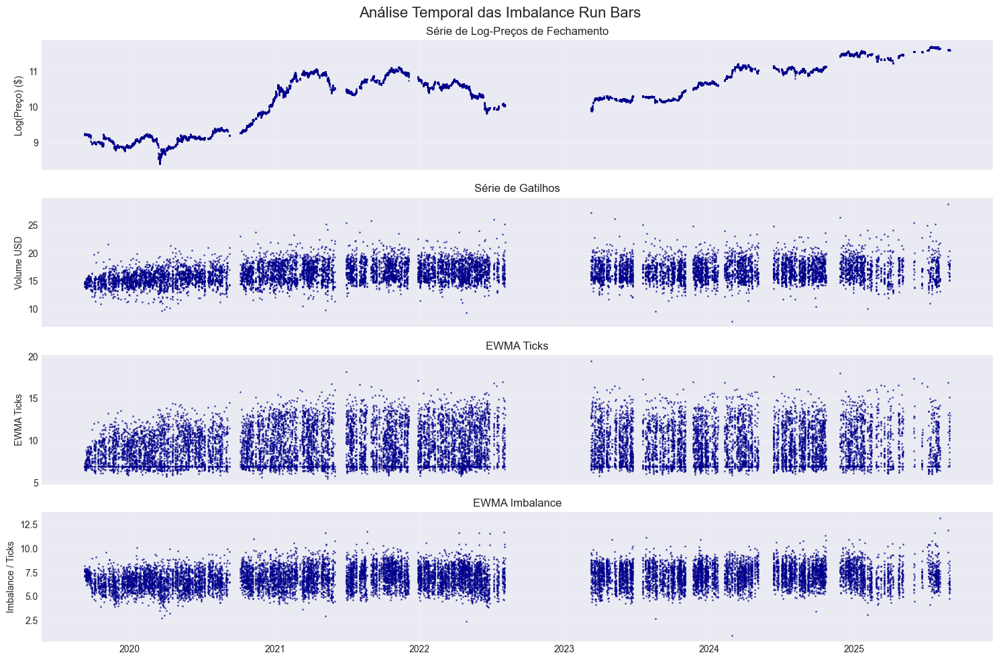

ANÁLISE DE DOLLAR IMBALANCE BARS - METODOLOGIA LOPEZ DE PRADO
SAMPLE - ./output/20250903-022108-imbalance-futures-ticks1000-aticks0.1-aimb0.4-treset2.parquet

📊 Dataset carregado: 113,632 barras
📅 Índices: 0 até 113631

📋 Estrutura dos dados:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 113632 entries, 0 to 113631
Data columns (total 13 columns):
 #   Column                Non-Null Count   Dtype         
---  ------                --------------   -----         
 0   end_time              113632 non-null  datetime64[ns]
 1   open                  113632 non-null  float64       
 2   high                  113632 non-null  float64       
 3   low                   113632 non-null  float64       
 4   close                 113632 non-null  float64       
 5   theta_k               113632 non-null  float64       
 6   total_volume_buy_usd  113632 non-null  float64       
 7   total_volume_usd      113632 non-null  float64       
 8   total_volume          113632 non-null  float64     

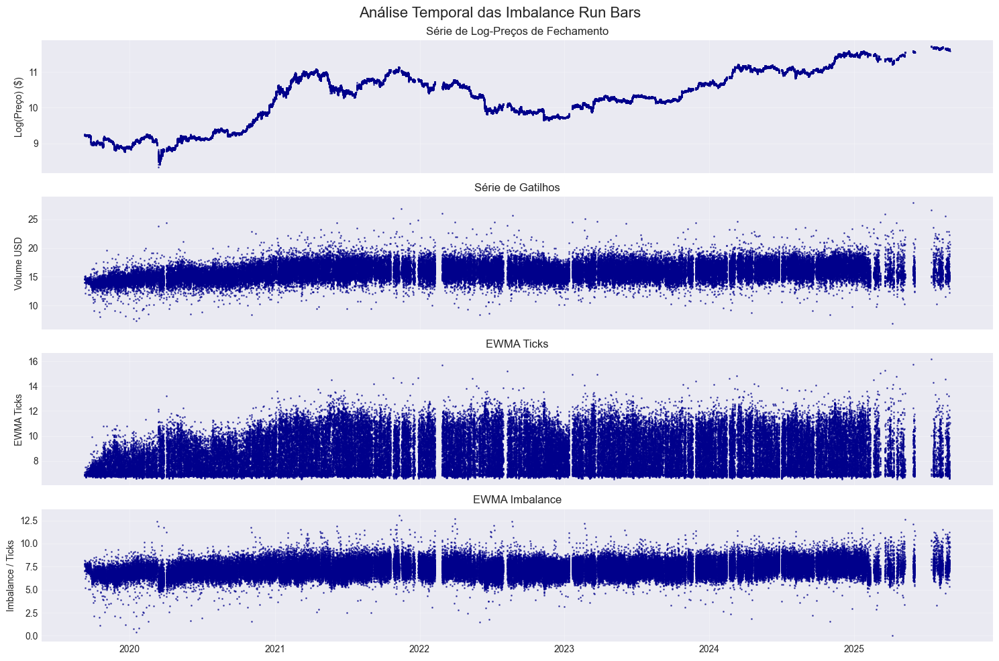

ANÁLISE DE DOLLAR IMBALANCE BARS - METODOLOGIA LOPEZ DE PRADO
SAMPLE - ./output/20250903-083559-imbalance-futures-ticks1000-aticks0.7-aimb0.1-treset6.parquet

📊 Dataset carregado: 3,781 barras
📅 Índices: 0 até 3780

📋 Estrutura dos dados:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3781 entries, 0 to 3780
Data columns (total 13 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   end_time              3781 non-null   datetime64[ns]
 1   open                  3781 non-null   float64       
 2   high                  3781 non-null   float64       
 3   low                   3781 non-null   float64       
 4   close                 3781 non-null   float64       
 5   theta_k               3781 non-null   float64       
 6   total_volume_buy_usd  3781 non-null   float64       
 7   total_volume_usd      3781 non-null   float64       
 8   total_volume          3781 non-null   float64       
 9   ticks      

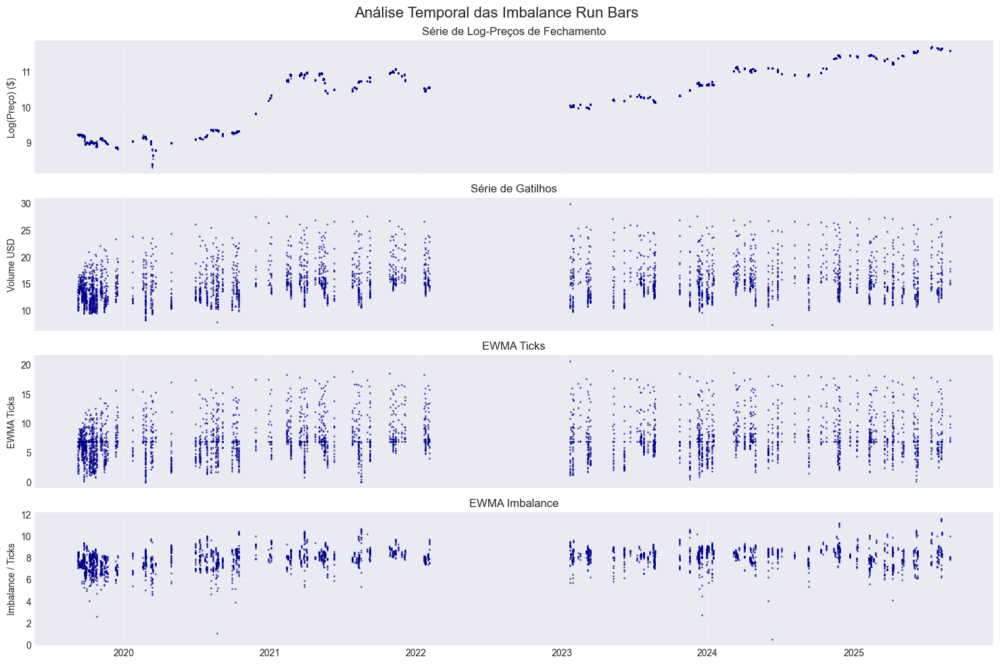

ANÁLISE DE DOLLAR IMBALANCE BARS - METODOLOGIA LOPEZ DE PRADO
SAMPLE - ./output/20250903-013236-imbalance-futures-ticks1000-aticks0.1-aimb0.1-treset5.parquet

📊 Dataset carregado: 34,361 barras
📅 Índices: 0 até 34360

📋 Estrutura dos dados:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 34361 entries, 0 to 34360
Data columns (total 13 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   end_time              34361 non-null  datetime64[ns]
 1   open                  34361 non-null  float64       
 2   high                  34361 non-null  float64       
 3   low                   34361 non-null  float64       
 4   close                 34361 non-null  float64       
 5   theta_k               34361 non-null  float64       
 6   total_volume_buy_usd  34361 non-null  float64       
 7   total_volume_usd      34361 non-null  float64       
 8   total_volume          34361 non-null  float64       
 9   ticks  

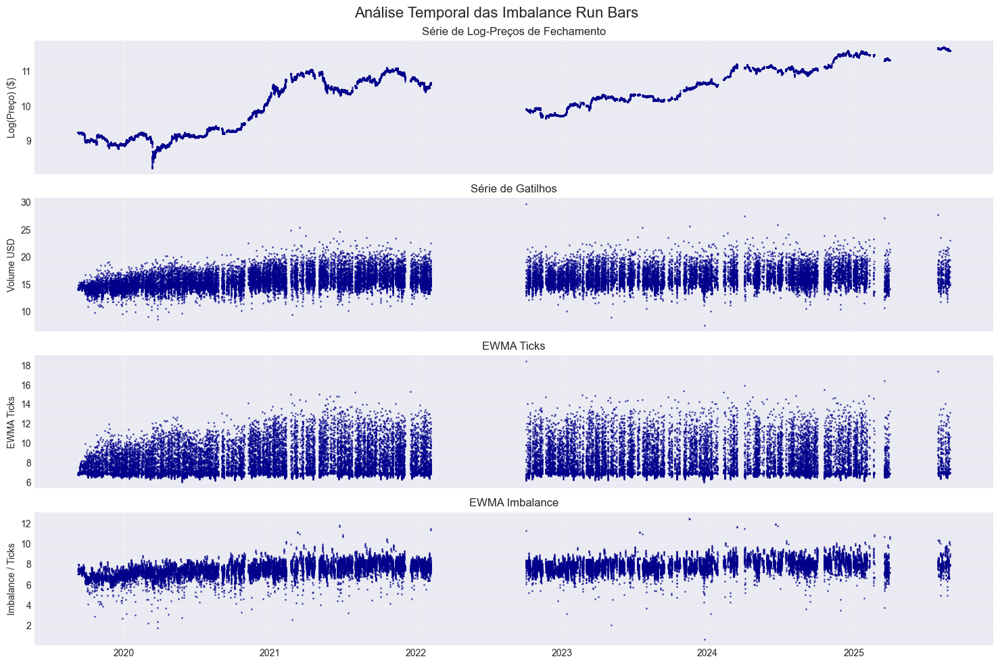

ANÁLISE DE DOLLAR IMBALANCE BARS - METODOLOGIA LOPEZ DE PRADO
SAMPLE - ./output/20250903-032330-imbalance-futures-ticks1000-aticks0.1-aimb0.7-treset1.parquet

📊 Dataset carregado: 122,278 barras
📅 Índices: 0 até 122277

📋 Estrutura dos dados:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 122278 entries, 0 to 122277
Data columns (total 13 columns):
 #   Column                Non-Null Count   Dtype         
---  ------                --------------   -----         
 0   end_time              122278 non-null  datetime64[ns]
 1   open                  122278 non-null  float64       
 2   high                  122278 non-null  float64       
 3   low                   122278 non-null  float64       
 4   close                 122278 non-null  float64       
 5   theta_k               122278 non-null  float64       
 6   total_volume_buy_usd  122278 non-null  float64       
 7   total_volume_usd      122278 non-null  float64       
 8   total_volume          122278 non-null  float64     

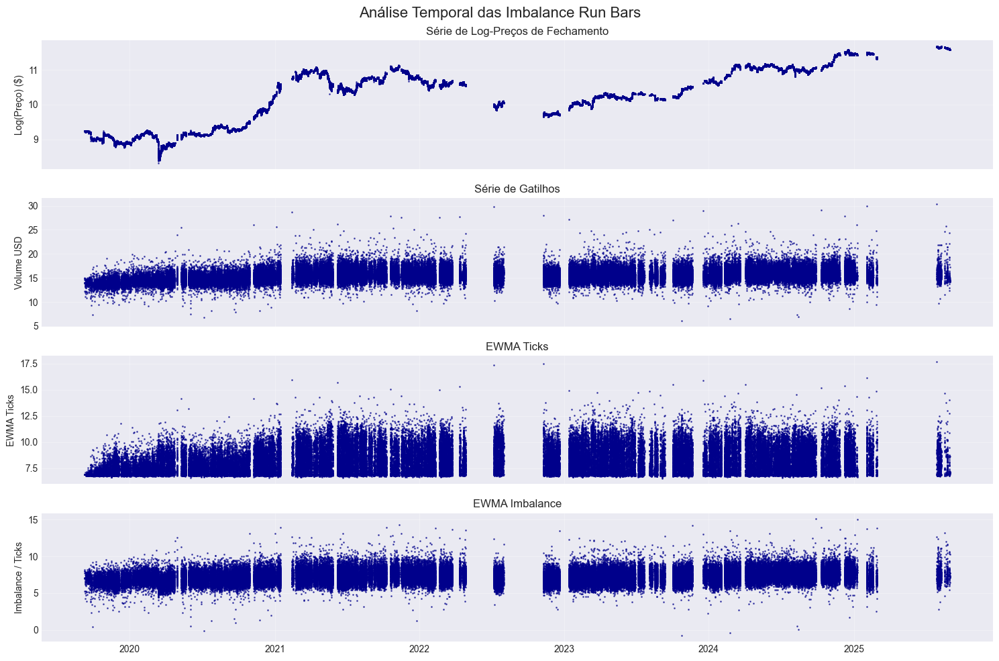

ANÁLISE DE DOLLAR IMBALANCE BARS - METODOLOGIA LOPEZ DE PRADO
SAMPLE - ./output/20250903-014633-imbalance-futures-ticks1000-aticks0.1-aimb0.1-treset7.parquet

📊 Dataset carregado: 27,873 barras
📅 Índices: 0 até 27872

📋 Estrutura dos dados:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 27873 entries, 0 to 27872
Data columns (total 13 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   end_time              27873 non-null  datetime64[ns]
 1   open                  27873 non-null  float64       
 2   high                  27873 non-null  float64       
 3   low                   27873 non-null  float64       
 4   close                 27873 non-null  float64       
 5   theta_k               27873 non-null  float64       
 6   total_volume_buy_usd  27873 non-null  float64       
 7   total_volume_usd      27873 non-null  float64       
 8   total_volume          27873 non-null  float64       
 9   ticks  

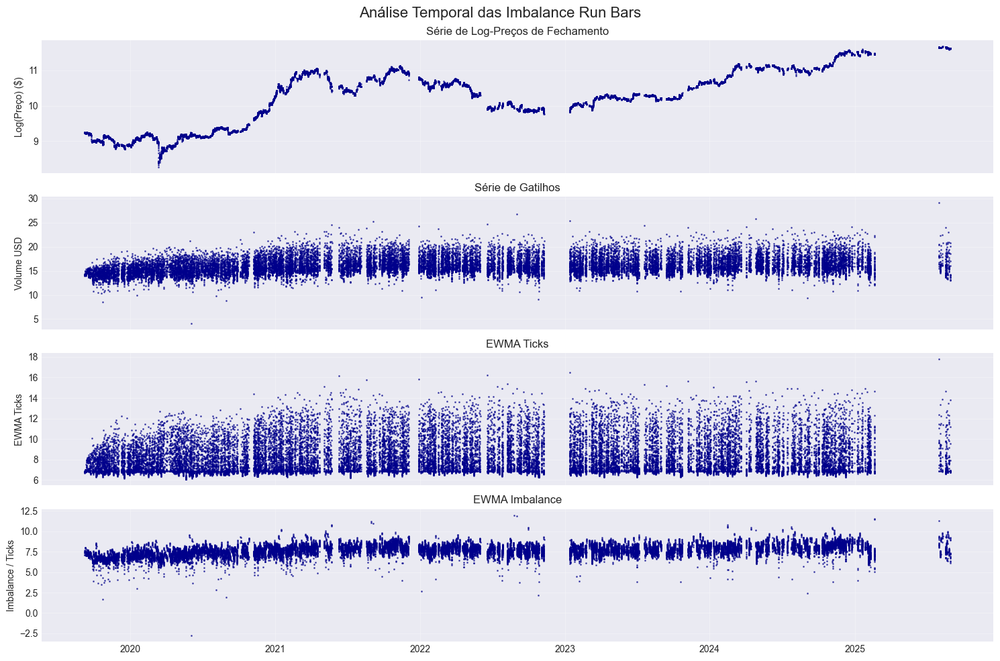

ANÁLISE DE DOLLAR IMBALANCE BARS - METODOLOGIA LOPEZ DE PRADO
SAMPLE - ./output/20250903-035808-imbalance-futures-ticks1000-aticks0.1-aimb0.7-treset6.parquet

📊 Dataset carregado: 41,461 barras
📅 Índices: 0 até 41460

📋 Estrutura dos dados:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 41461 entries, 0 to 41460
Data columns (total 13 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   end_time              41461 non-null  datetime64[ns]
 1   open                  41461 non-null  float64       
 2   high                  41461 non-null  float64       
 3   low                   41461 non-null  float64       
 4   close                 41461 non-null  float64       
 5   theta_k               41461 non-null  float64       
 6   total_volume_buy_usd  41461 non-null  float64       
 7   total_volume_usd      41461 non-null  float64       
 8   total_volume          41461 non-null  float64       
 9   ticks  

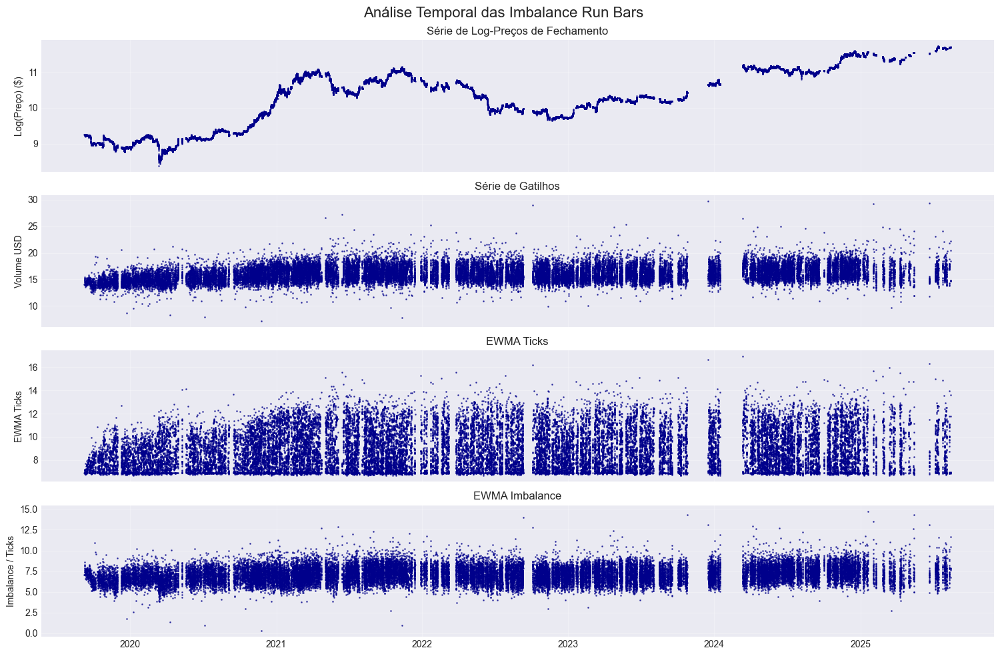

ANÁLISE DE DOLLAR IMBALANCE BARS - METODOLOGIA LOPEZ DE PRADO
SAMPLE - ./output/20250903-093154-imbalance-futures-ticks1000-aticks0.7-aimb0.4-treset4.parquet

📊 Dataset carregado: 8,379 barras
📅 Índices: 0 até 8378

📋 Estrutura dos dados:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8379 entries, 0 to 8378
Data columns (total 13 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   end_time              8379 non-null   datetime64[ns]
 1   open                  8379 non-null   float64       
 2   high                  8379 non-null   float64       
 3   low                   8379 non-null   float64       
 4   close                 8379 non-null   float64       
 5   theta_k               8379 non-null   float64       
 6   total_volume_buy_usd  8379 non-null   float64       
 7   total_volume_usd      8379 non-null   float64       
 8   total_volume          8379 non-null   float64       
 9   ticks      

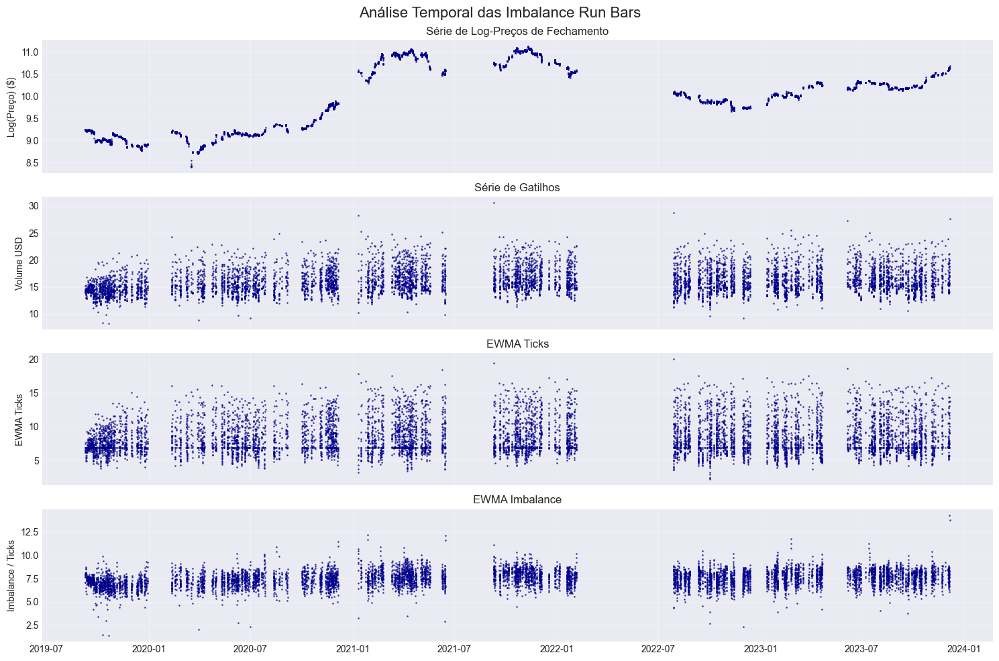

ANÁLISE DE DOLLAR IMBALANCE BARS - METODOLOGIA LOPEZ DE PRADO
SAMPLE - ./output/20250903-025539-imbalance-futures-ticks1000-aticks0.1-aimb0.4-treset7.parquet

📊 Dataset carregado: 42,363 barras
📅 Índices: 0 até 42362

📋 Estrutura dos dados:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 42363 entries, 0 to 42362
Data columns (total 13 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   end_time              42363 non-null  datetime64[ns]
 1   open                  42363 non-null  float64       
 2   high                  42363 non-null  float64       
 3   low                   42363 non-null  float64       
 4   close                 42363 non-null  float64       
 5   theta_k               42363 non-null  float64       
 6   total_volume_buy_usd  42363 non-null  float64       
 7   total_volume_usd      42363 non-null  float64       
 8   total_volume          42363 non-null  float64       
 9   ticks  

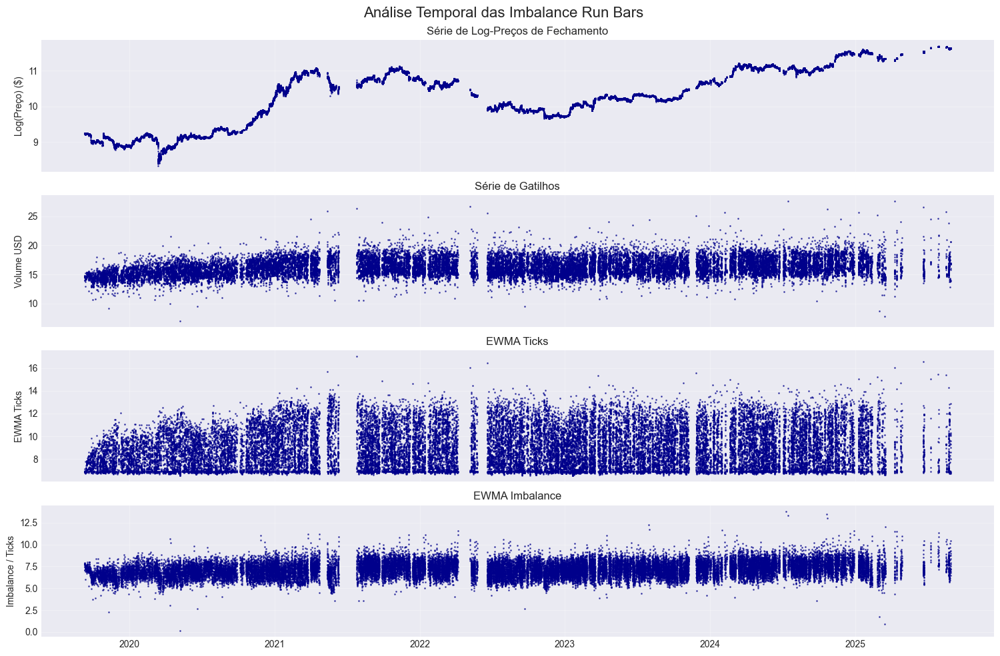

ANÁLISE DE DOLLAR IMBALANCE BARS - METODOLOGIA LOPEZ DE PRADO
SAMPLE - ./output/20250903-102457-imbalance-futures-ticks1000-aticks0.7-aimb0.7-treset1.parquet

📊 Dataset carregado: 84,524 barras
📅 Índices: 0 até 84523

📋 Estrutura dos dados:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 84524 entries, 0 to 84523
Data columns (total 13 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   end_time              84524 non-null  datetime64[ns]
 1   open                  84524 non-null  float64       
 2   high                  84524 non-null  float64       
 3   low                   84524 non-null  float64       
 4   close                 84524 non-null  float64       
 5   theta_k               84524 non-null  float64       
 6   total_volume_buy_usd  84524 non-null  float64       
 7   total_volume_usd      84524 non-null  float64       
 8   total_volume          84524 non-null  float64       
 9   ticks  

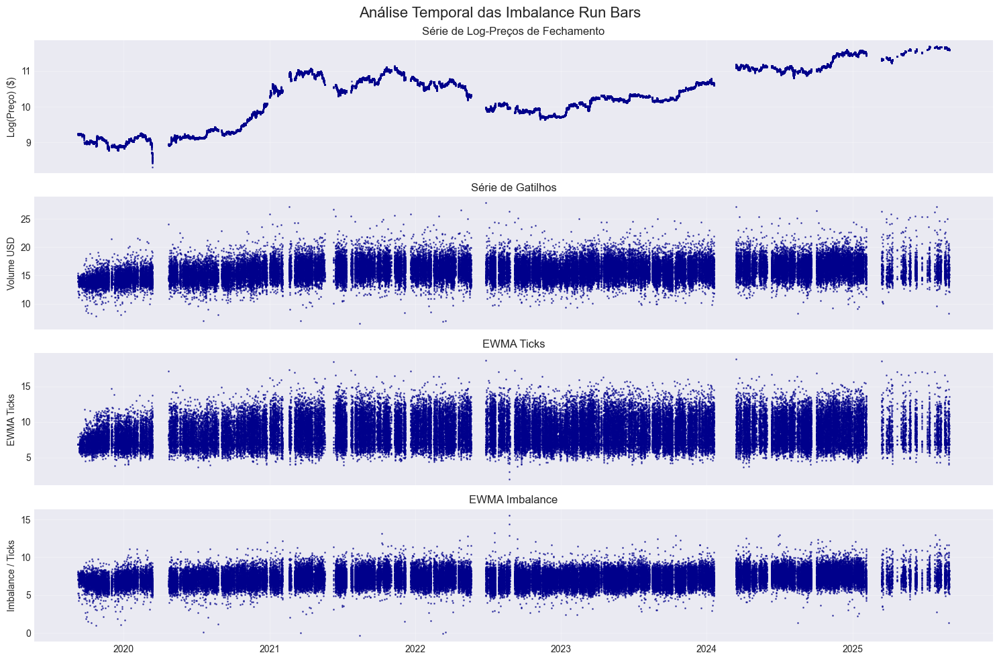

ANÁLISE DE DOLLAR IMBALANCE BARS - METODOLOGIA LOPEZ DE PRADO
SAMPLE - ./output/20250903-090356-imbalance-futures-ticks1000-aticks0.7-aimb0.1-treset10.parquet

📊 Dataset carregado: 2,135 barras
📅 Índices: 0 até 2134

📋 Estrutura dos dados:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2135 entries, 0 to 2134
Data columns (total 13 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   end_time              2135 non-null   datetime64[ns]
 1   open                  2135 non-null   float64       
 2   high                  2135 non-null   float64       
 3   low                   2135 non-null   float64       
 4   close                 2135 non-null   float64       
 5   theta_k               2135 non-null   float64       
 6   total_volume_buy_usd  2135 non-null   float64       
 7   total_volume_usd      2135 non-null   float64       
 8   total_volume          2135 non-null   float64       
 9   ticks     

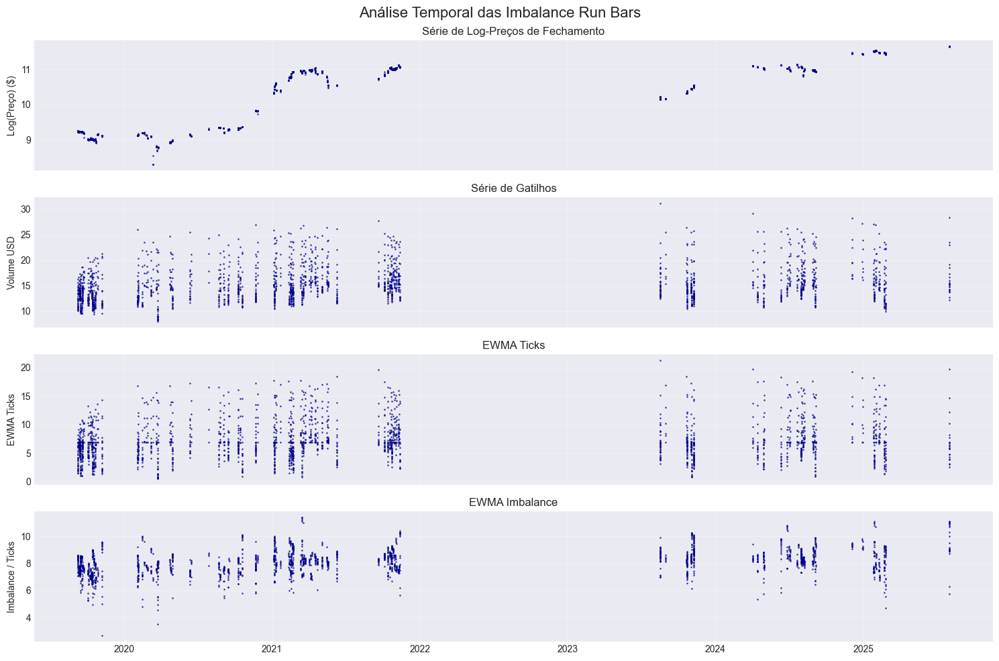

ANÁLISE DE DOLLAR IMBALANCE BARS - METODOLOGIA LOPEZ DE PRADO
SAMPLE - ./output/20250903-075410-imbalance-futures-ticks1000-aticks0.4-aimb0.7-treset10.parquet

📊 Dataset carregado: 14,270 barras
📅 Índices: 0 até 14269

📋 Estrutura dos dados:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 14270 entries, 0 to 14269
Data columns (total 13 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   end_time              14270 non-null  datetime64[ns]
 1   open                  14270 non-null  float64       
 2   high                  14270 non-null  float64       
 3   low                   14270 non-null  float64       
 4   close                 14270 non-null  float64       
 5   theta_k               14270 non-null  float64       
 6   total_volume_buy_usd  14270 non-null  float64       
 7   total_volume_usd      14270 non-null  float64       
 8   total_volume          14270 non-null  float64       
 9   ticks 

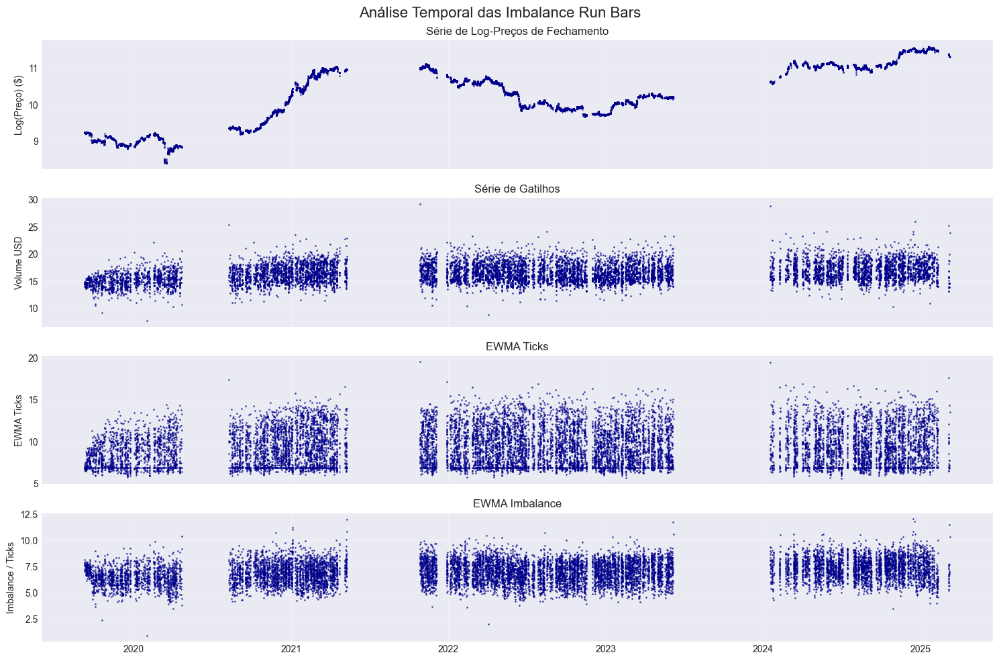

ANÁLISE DE DOLLAR IMBALANCE BARS - METODOLOGIA LOPEZ DE PRADO
SAMPLE - ./output/20250903-065137-imbalance-futures-ticks1000-aticks0.4-aimb0.7-treset1.parquet

📊 Dataset carregado: 98,979 barras
📅 Índices: 0 até 98978

📋 Estrutura dos dados:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 98979 entries, 0 to 98978
Data columns (total 13 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   end_time              98979 non-null  datetime64[ns]
 1   open                  98979 non-null  float64       
 2   high                  98979 non-null  float64       
 3   low                   98979 non-null  float64       
 4   close                 98979 non-null  float64       
 5   theta_k               98979 non-null  float64       
 6   total_volume_buy_usd  98979 non-null  float64       
 7   total_volume_usd      98979 non-null  float64       
 8   total_volume          98979 non-null  float64       
 9   ticks  

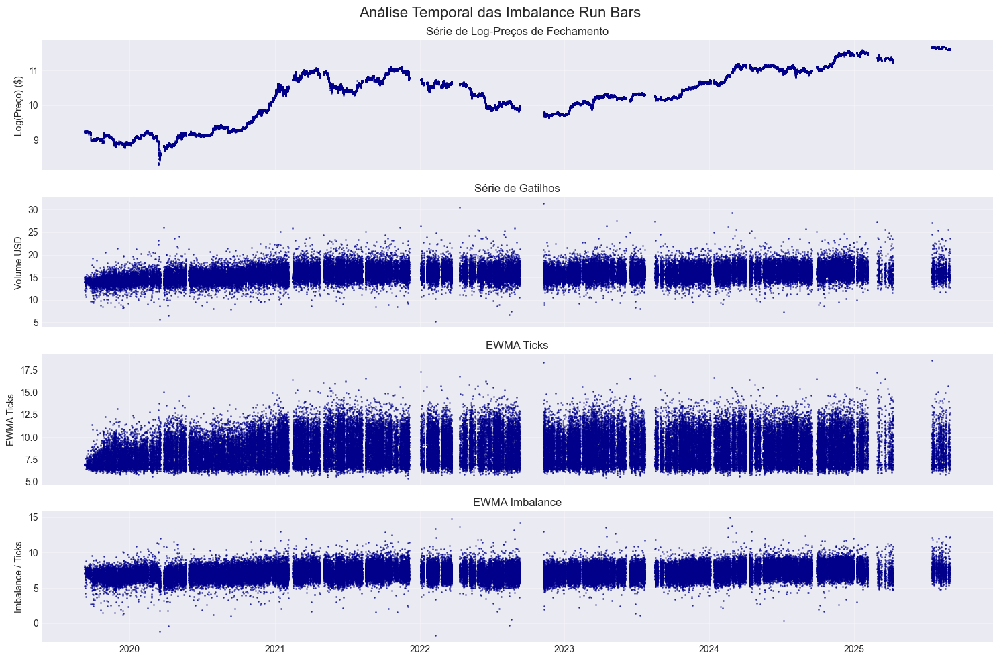

ANÁLISE DE DOLLAR IMBALANCE BARS - METODOLOGIA LOPEZ DE PRADO
SAMPLE - ./output/20250903-084255-imbalance-futures-ticks1000-aticks0.7-aimb0.1-treset7.parquet

📊 Dataset carregado: 3,741 barras
📅 Índices: 0 até 3740

📋 Estrutura dos dados:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3741 entries, 0 to 3740
Data columns (total 13 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   end_time              3741 non-null   datetime64[ns]
 1   open                  3741 non-null   float64       
 2   high                  3741 non-null   float64       
 3   low                   3741 non-null   float64       
 4   close                 3741 non-null   float64       
 5   theta_k               3741 non-null   float64       
 6   total_volume_buy_usd  3741 non-null   float64       
 7   total_volume_usd      3741 non-null   float64       
 8   total_volume          3741 non-null   float64       
 9   ticks      

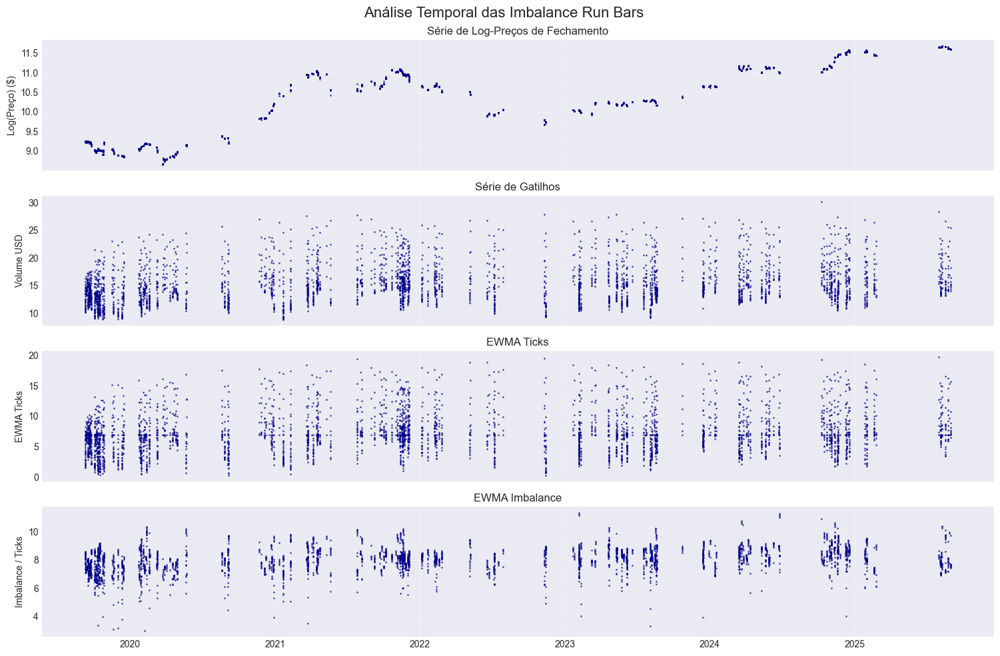

ANÁLISE DE DOLLAR IMBALANCE BARS - METODOLOGIA LOPEZ DE PRADO
SAMPLE - ./output/20250903-011132-imbalance-futures-ticks1000-aticks0.1-aimb0.1-treset2.parquet

📊 Dataset carregado: 93,135 barras
📅 Índices: 0 até 93134

📋 Estrutura dos dados:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 93135 entries, 0 to 93134
Data columns (total 13 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   end_time              93135 non-null  datetime64[ns]
 1   open                  93135 non-null  float64       
 2   high                  93135 non-null  float64       
 3   low                   93135 non-null  float64       
 4   close                 93135 non-null  float64       
 5   theta_k               93135 non-null  float64       
 6   total_volume_buy_usd  93135 non-null  float64       
 7   total_volume_usd      93135 non-null  float64       
 8   total_volume          93135 non-null  float64       
 9   ticks  

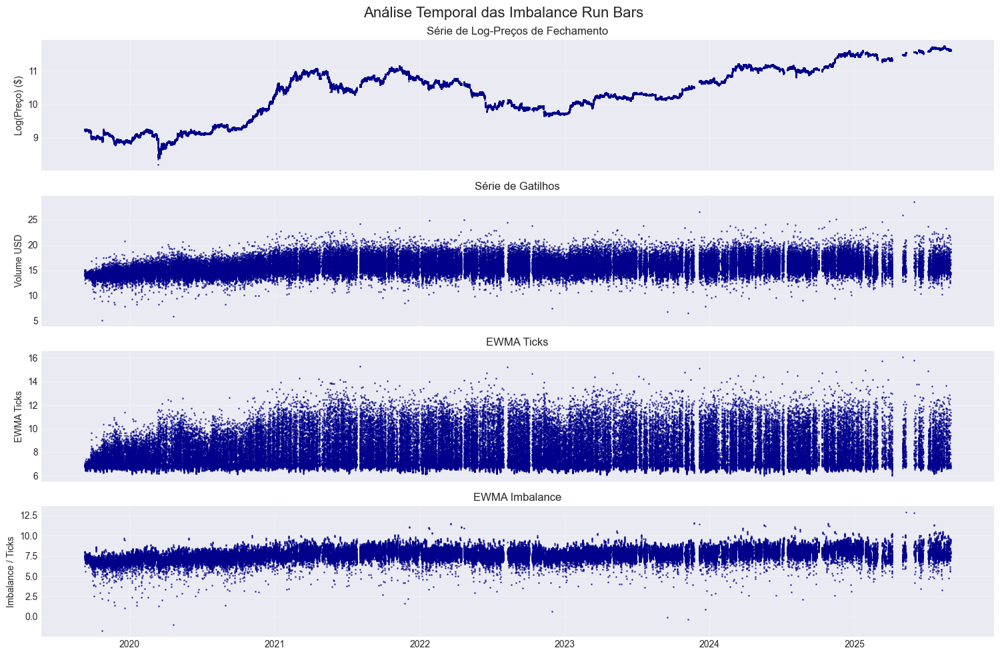

ANÁLISE DE DOLLAR IMBALANCE BARS - METODOLOGIA LOPEZ DE PRADO
SAMPLE - ./output/20250903-103241-imbalance-futures-ticks1000-aticks0.7-aimb0.7-treset2.parquet

📊 Dataset carregado: 43,645 barras
📅 Índices: 0 até 43644

📋 Estrutura dos dados:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 43645 entries, 0 to 43644
Data columns (total 13 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   end_time              43645 non-null  datetime64[ns]
 1   open                  43645 non-null  float64       
 2   high                  43645 non-null  float64       
 3   low                   43645 non-null  float64       
 4   close                 43645 non-null  float64       
 5   theta_k               43645 non-null  float64       
 6   total_volume_buy_usd  43645 non-null  float64       
 7   total_volume_usd      43645 non-null  float64       
 8   total_volume          43645 non-null  float64       
 9   ticks  

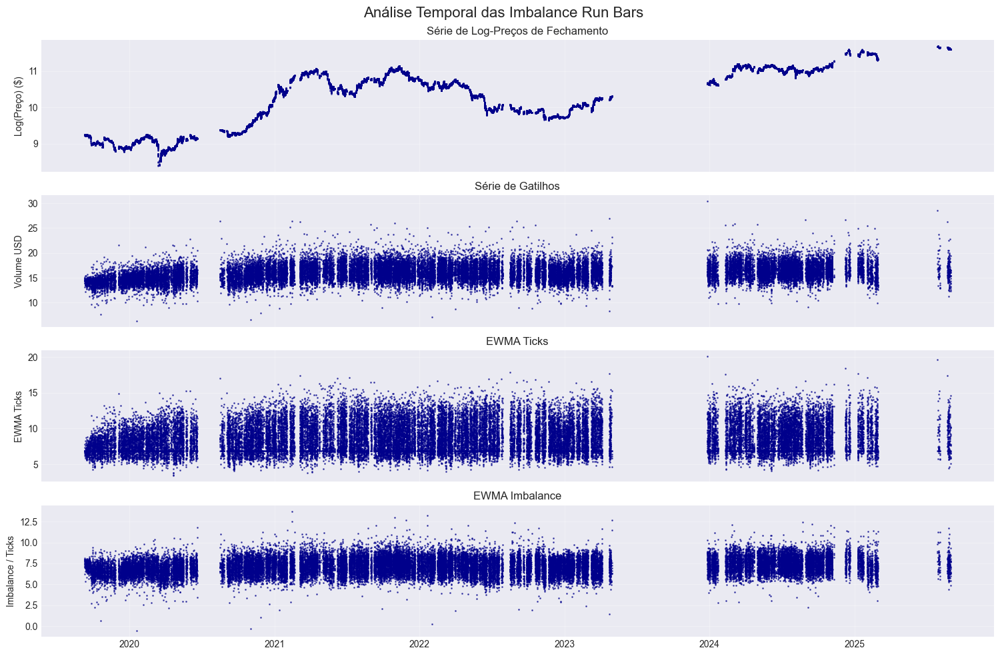

ANÁLISE DE DOLLAR IMBALANCE BARS - METODOLOGIA LOPEZ DE PRADO
SAMPLE - ./output/20250903-061653-imbalance-futures-ticks1000-aticks0.4-aimb0.4-treset6.parquet

📊 Dataset carregado: 10,634 barras
📅 Índices: 0 até 10633

📋 Estrutura dos dados:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10634 entries, 0 to 10633
Data columns (total 13 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   end_time              10634 non-null  datetime64[ns]
 1   open                  10634 non-null  float64       
 2   high                  10634 non-null  float64       
 3   low                   10634 non-null  float64       
 4   close                 10634 non-null  float64       
 5   theta_k               10634 non-null  float64       
 6   total_volume_buy_usd  10634 non-null  float64       
 7   total_volume_usd      10634 non-null  float64       
 8   total_volume          10634 non-null  float64       
 9   ticks  

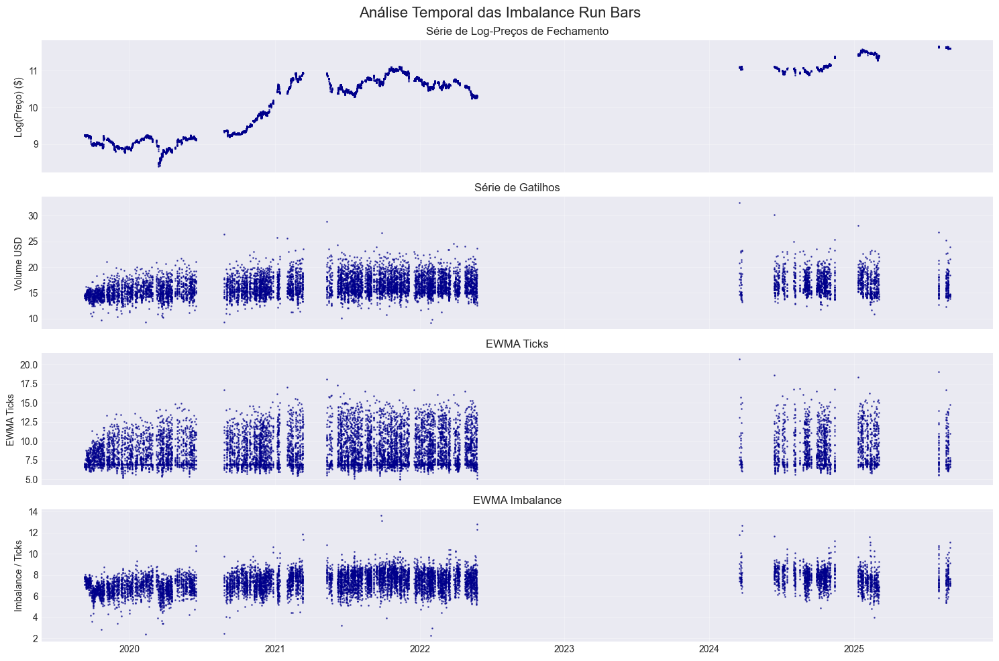

ANÁLISE DE DOLLAR IMBALANCE BARS - METODOLOGIA LOPEZ DE PRADO
SAMPLE - ./output/20250903-023455-imbalance-futures-ticks1000-aticks0.1-aimb0.4-treset4.parquet

📊 Dataset carregado: 53,064 barras
📅 Índices: 0 até 53063

📋 Estrutura dos dados:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 53064 entries, 0 to 53063
Data columns (total 13 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   end_time              53064 non-null  datetime64[ns]
 1   open                  53064 non-null  float64       
 2   high                  53064 non-null  float64       
 3   low                   53064 non-null  float64       
 4   close                 53064 non-null  float64       
 5   theta_k               53064 non-null  float64       
 6   total_volume_buy_usd  53064 non-null  float64       
 7   total_volume_usd      53064 non-null  float64       
 8   total_volume          53064 non-null  float64       
 9   ticks  

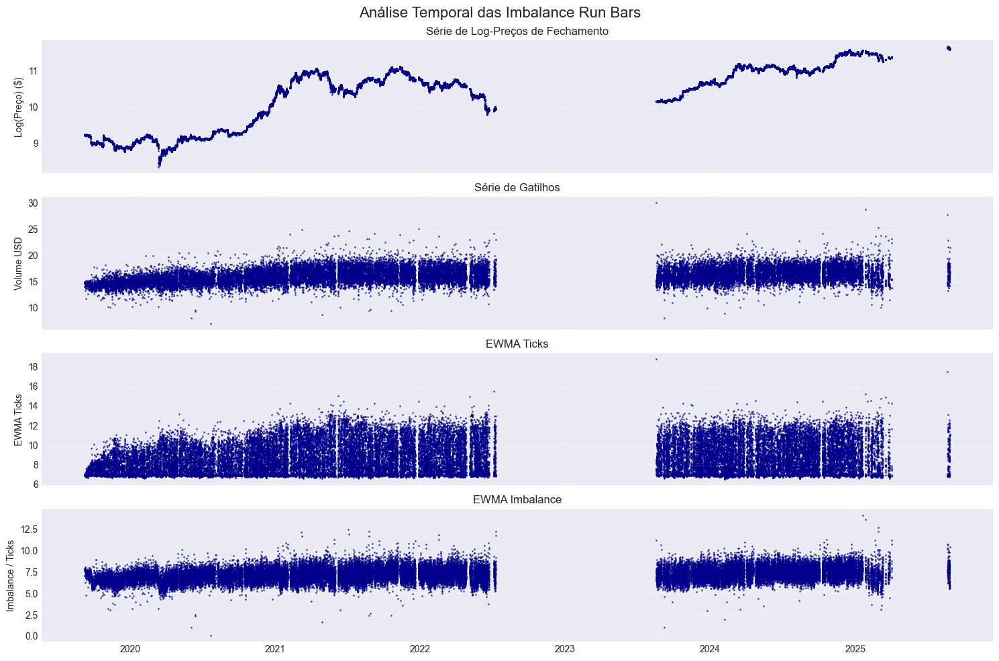

ANÁLISE DE DOLLAR IMBALANCE BARS - METODOLOGIA LOPEZ DE PRADO
SAMPLE - ./output/20250903-011842-imbalance-futures-ticks1000-aticks0.1-aimb0.1-treset3.parquet

📊 Dataset carregado: 57,557 barras
📅 Índices: 0 até 57556

📋 Estrutura dos dados:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 57557 entries, 0 to 57556
Data columns (total 13 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   end_time              57557 non-null  datetime64[ns]
 1   open                  57557 non-null  float64       
 2   high                  57557 non-null  float64       
 3   low                   57557 non-null  float64       
 4   close                 57557 non-null  float64       
 5   theta_k               57557 non-null  float64       
 6   total_volume_buy_usd  57557 non-null  float64       
 7   total_volume_usd      57557 non-null  float64       
 8   total_volume          57557 non-null  float64       
 9   ticks  

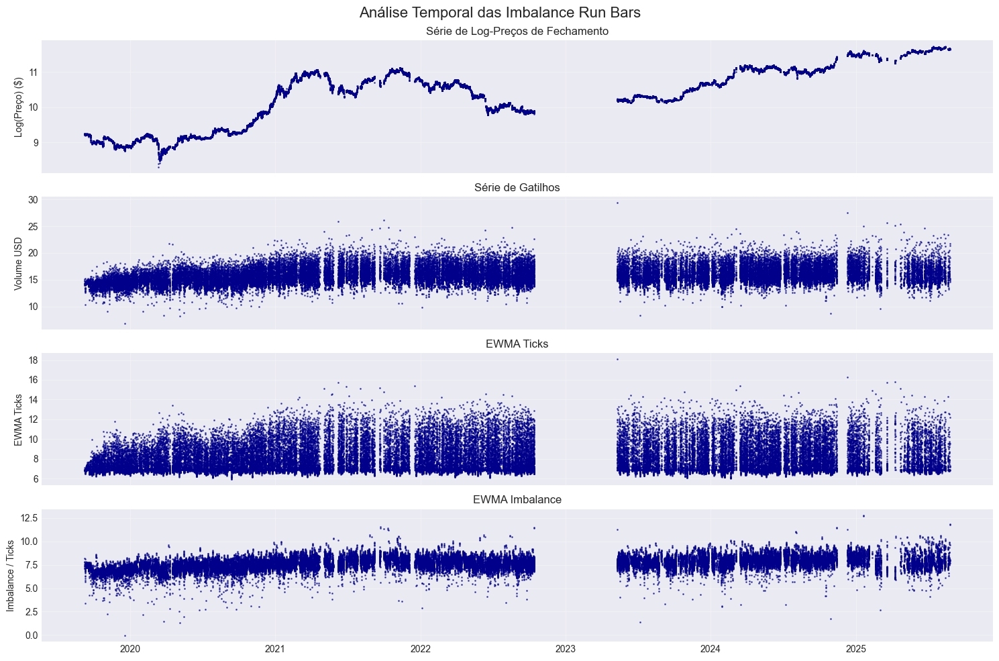

ANÁLISE DE DOLLAR IMBALANCE BARS - METODOLOGIA LOPEZ DE PRADO
SAMPLE - ./output/20250903-082202-imbalance-futures-ticks1000-aticks0.7-aimb0.1-treset4.parquet

📊 Dataset carregado: 4,601 barras
📅 Índices: 0 até 4600

📋 Estrutura dos dados:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4601 entries, 0 to 4600
Data columns (total 13 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   end_time              4601 non-null   datetime64[ns]
 1   open                  4601 non-null   float64       
 2   high                  4601 non-null   float64       
 3   low                   4601 non-null   float64       
 4   close                 4601 non-null   float64       
 5   theta_k               4601 non-null   float64       
 6   total_volume_buy_usd  4601 non-null   float64       
 7   total_volume_usd      4601 non-null   float64       
 8   total_volume          4601 non-null   float64       
 9   ticks      

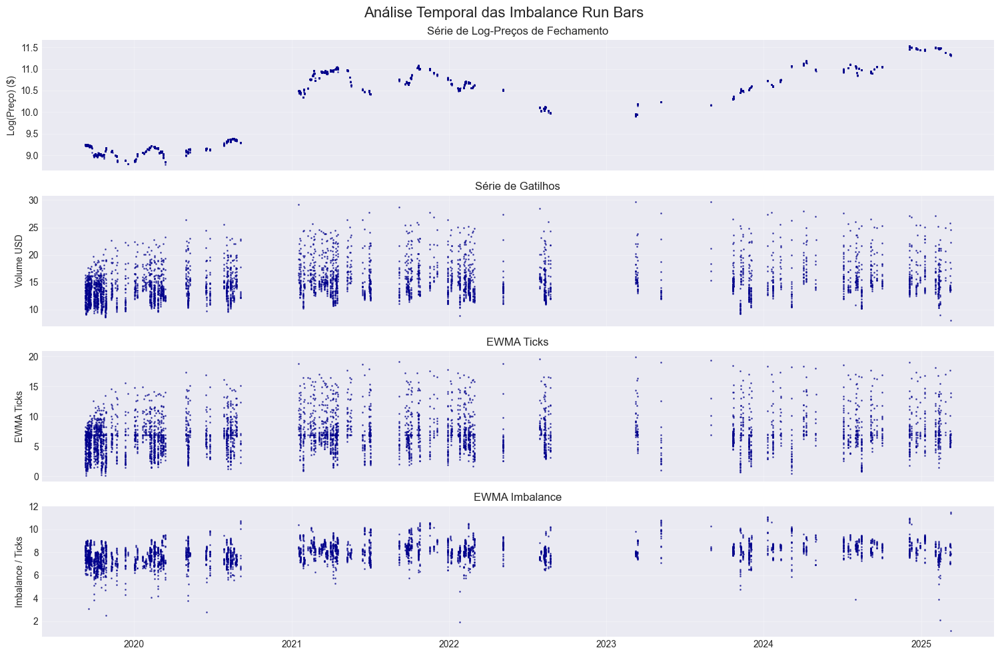

ANÁLISE DE DOLLAR IMBALANCE BARS - METODOLOGIA LOPEZ DE PRADO
SAMPLE - ./output/20250903-063745-imbalance-futures-ticks1000-aticks0.4-aimb0.4-treset9.parquet

📊 Dataset carregado: 11,970 barras
📅 Índices: 0 até 11969

📋 Estrutura dos dados:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 11970 entries, 0 to 11969
Data columns (total 13 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   end_time              11970 non-null  datetime64[ns]
 1   open                  11970 non-null  float64       
 2   high                  11970 non-null  float64       
 3   low                   11970 non-null  float64       
 4   close                 11970 non-null  float64       
 5   theta_k               11970 non-null  float64       
 6   total_volume_buy_usd  11970 non-null  float64       
 7   total_volume_usd      11970 non-null  float64       
 8   total_volume          11970 non-null  float64       
 9   ticks  

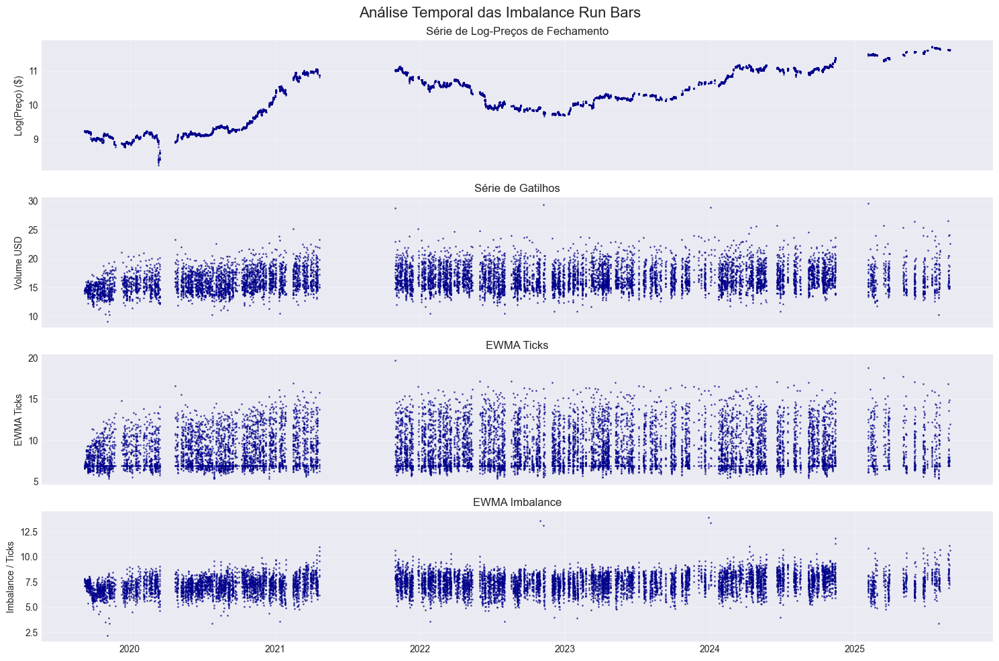

ANÁLISE DE DOLLAR IMBALANCE BARS - METODOLOGIA LOPEZ DE PRADO
SAMPLE - ./output/20250903-033723-imbalance-futures-ticks1000-aticks0.1-aimb0.7-treset3.parquet

📊 Dataset carregado: 75,285 barras
📅 Índices: 0 até 75284

📋 Estrutura dos dados:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 75285 entries, 0 to 75284
Data columns (total 13 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   end_time              75285 non-null  datetime64[ns]
 1   open                  75285 non-null  float64       
 2   high                  75285 non-null  float64       
 3   low                   75285 non-null  float64       
 4   close                 75285 non-null  float64       
 5   theta_k               75285 non-null  float64       
 6   total_volume_buy_usd  75285 non-null  float64       
 7   total_volume_usd      75285 non-null  float64       
 8   total_volume          75285 non-null  float64       
 9   ticks  

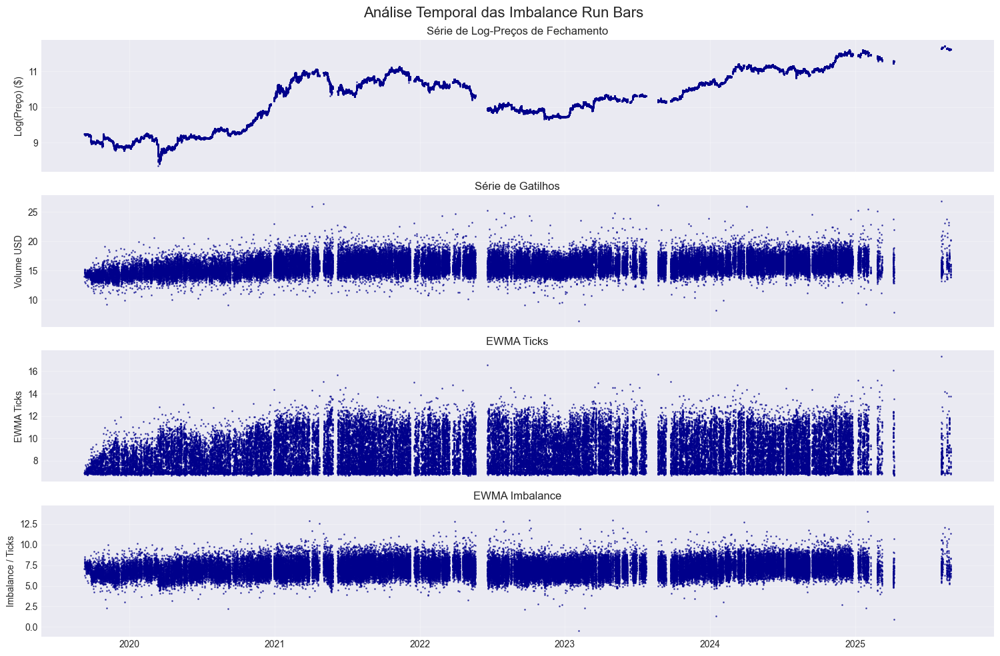

ANÁLISE DE DOLLAR IMBALANCE BARS - METODOLOGIA LOPEZ DE PRADO
SAMPLE - ./output/20250903-091053-imbalance-futures-ticks1000-aticks0.7-aimb0.4-treset1.parquet

📊 Dataset carregado: 32,447 barras
📅 Índices: 0 até 32446

📋 Estrutura dos dados:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 32447 entries, 0 to 32446
Data columns (total 13 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   end_time              32447 non-null  datetime64[ns]
 1   open                  32447 non-null  float64       
 2   high                  32447 non-null  float64       
 3   low                   32447 non-null  float64       
 4   close                 32447 non-null  float64       
 5   theta_k               32447 non-null  float64       
 6   total_volume_buy_usd  32447 non-null  float64       
 7   total_volume_usd      32447 non-null  float64       
 8   total_volume          32447 non-null  float64       
 9   ticks  

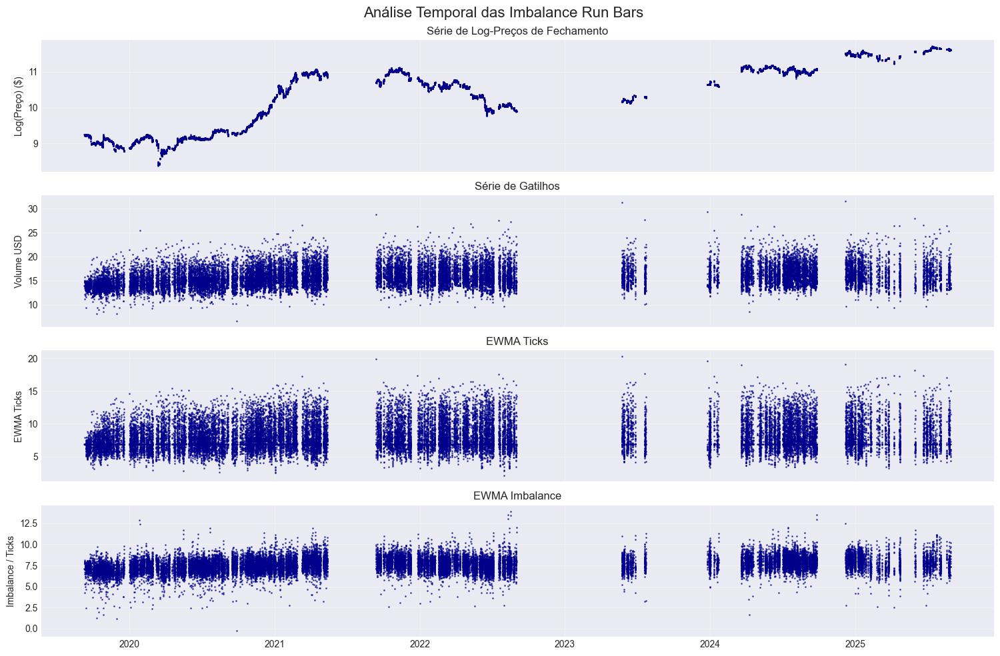

ANÁLISE DE DOLLAR IMBALANCE BARS - METODOLOGIA LOPEZ DE PRADO
SAMPLE - ./output/20250903-104039-imbalance-futures-ticks1000-aticks0.7-aimb0.7-treset3.parquet

📊 Dataset carregado: 25,724 barras
📅 Índices: 0 até 25723

📋 Estrutura dos dados:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 25724 entries, 0 to 25723
Data columns (total 13 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   end_time              25724 non-null  datetime64[ns]
 1   open                  25724 non-null  float64       
 2   high                  25724 non-null  float64       
 3   low                   25724 non-null  float64       
 4   close                 25724 non-null  float64       
 5   theta_k               25724 non-null  float64       
 6   total_volume_buy_usd  25724 non-null  float64       
 7   total_volume_usd      25724 non-null  float64       
 8   total_volume          25724 non-null  float64       
 9   ticks  

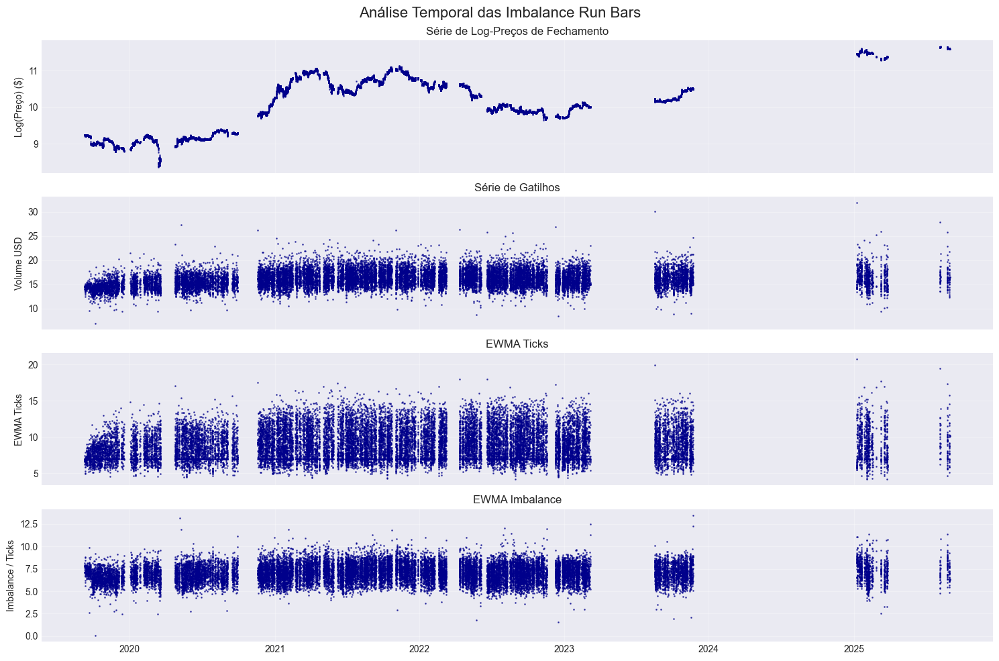

ANÁLISE DE DOLLAR IMBALANCE BARS - METODOLOGIA LOPEZ DE PRADO
SAMPLE - ./output/20250903-030235-imbalance-futures-ticks1000-aticks0.1-aimb0.4-treset8.parquet

📊 Dataset carregado: 37,277 barras
📅 Índices: 0 até 37276

📋 Estrutura dos dados:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 37277 entries, 0 to 37276
Data columns (total 13 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   end_time              37277 non-null  datetime64[ns]
 1   open                  37277 non-null  float64       
 2   high                  37277 non-null  float64       
 3   low                   37277 non-null  float64       
 4   close                 37277 non-null  float64       
 5   theta_k               37277 non-null  float64       
 6   total_volume_buy_usd  37277 non-null  float64       
 7   total_volume_usd      37277 non-null  float64       
 8   total_volume          37277 non-null  float64       
 9   ticks  

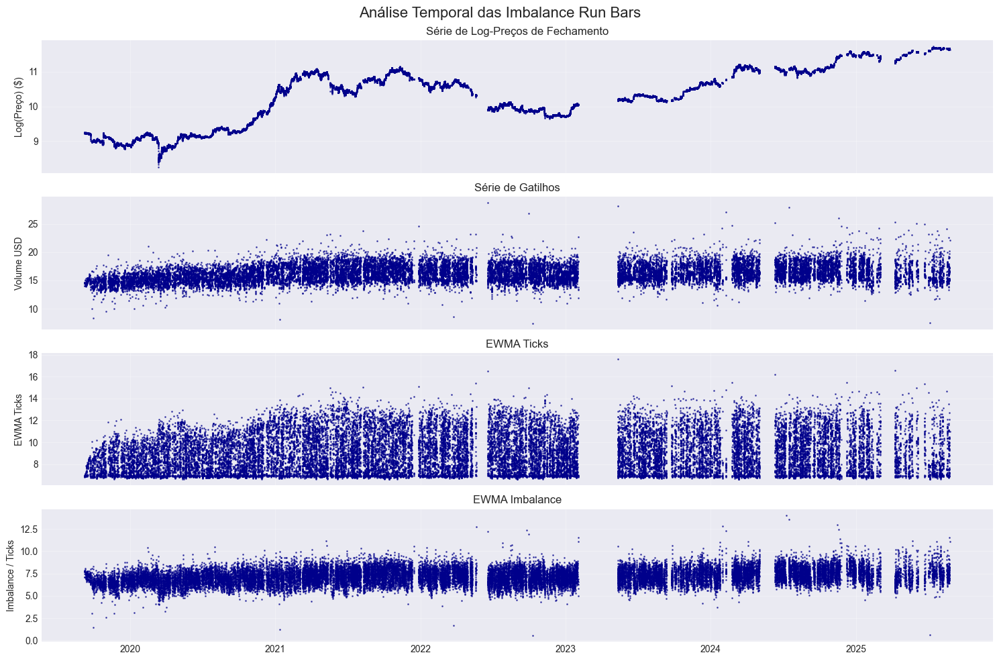

ANÁLISE DE DOLLAR IMBALANCE BARS - METODOLOGIA LOPEZ DE PRADO
SAMPLE - ./output/20250903-031630-imbalance-futures-ticks1000-aticks0.1-aimb0.4-treset10.parquet

📊 Dataset carregado: 32,606 barras
📅 Índices: 0 até 32605

📋 Estrutura dos dados:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 32606 entries, 0 to 32605
Data columns (total 13 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   end_time              32606 non-null  datetime64[ns]
 1   open                  32606 non-null  float64       
 2   high                  32606 non-null  float64       
 3   low                   32606 non-null  float64       
 4   close                 32606 non-null  float64       
 5   theta_k               32606 non-null  float64       
 6   total_volume_buy_usd  32606 non-null  float64       
 7   total_volume_usd      32606 non-null  float64       
 8   total_volume          32606 non-null  float64       
 9   ticks 

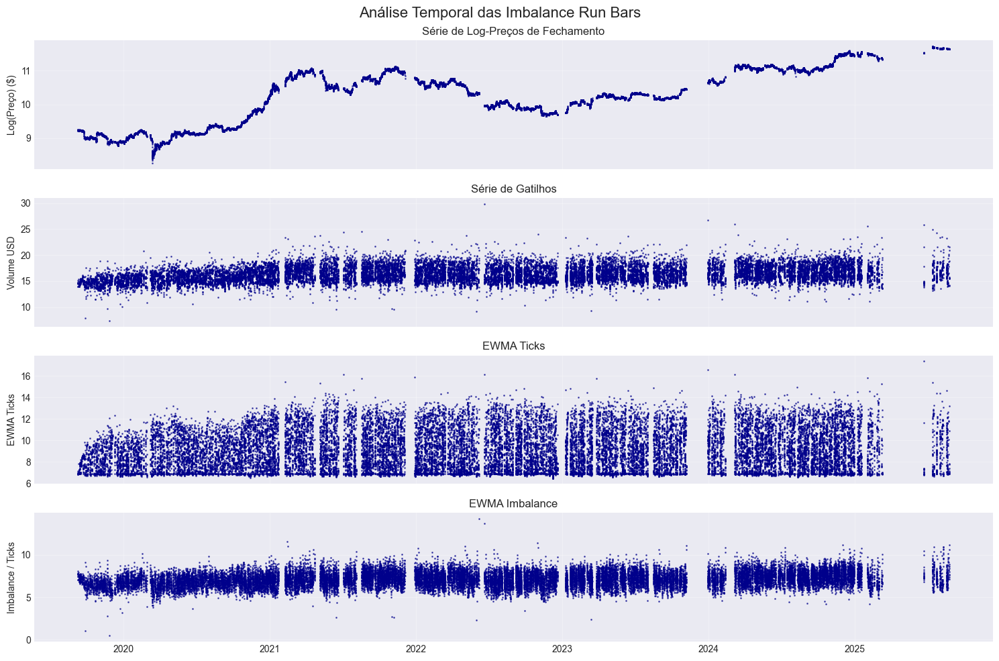

ANÁLISE DE DOLLAR IMBALANCE BARS - METODOLOGIA LOPEZ DE PRADO
SAMPLE - ./output/20250903-022801-imbalance-futures-ticks1000-aticks0.1-aimb0.4-treset3.parquet

📊 Dataset carregado: 82,675 barras
📅 Índices: 0 até 82674

📋 Estrutura dos dados:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 82675 entries, 0 to 82674
Data columns (total 13 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   end_time              82675 non-null  datetime64[ns]
 1   open                  82675 non-null  float64       
 2   high                  82675 non-null  float64       
 3   low                   82675 non-null  float64       
 4   close                 82675 non-null  float64       
 5   theta_k               82675 non-null  float64       
 6   total_volume_buy_usd  82675 non-null  float64       
 7   total_volume_usd      82675 non-null  float64       
 8   total_volume          82675 non-null  float64       
 9   ticks  

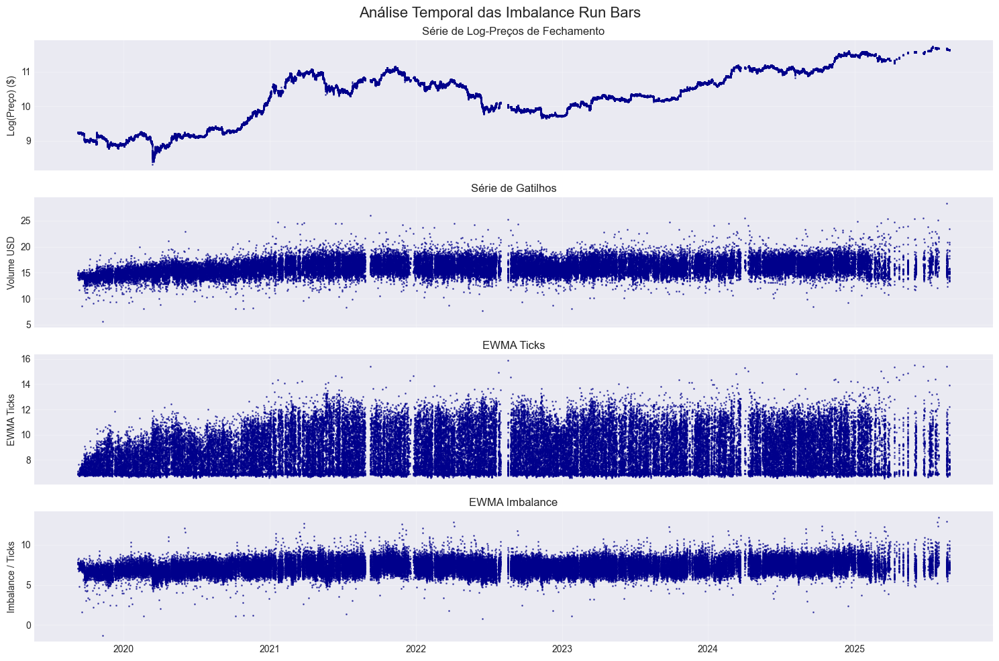

ANÁLISE DE DOLLAR IMBALANCE BARS - METODOLOGIA LOPEZ DE PRADO
SAMPLE - ./output/20250903-042553-imbalance-futures-ticks1000-aticks0.1-aimb0.7-treset10.parquet

📊 Dataset carregado: 28,922 barras
📅 Índices: 0 até 28921

📋 Estrutura dos dados:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 28922 entries, 0 to 28921
Data columns (total 13 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   end_time              28922 non-null  datetime64[ns]
 1   open                  28922 non-null  float64       
 2   high                  28922 non-null  float64       
 3   low                   28922 non-null  float64       
 4   close                 28922 non-null  float64       
 5   theta_k               28922 non-null  float64       
 6   total_volume_buy_usd  28922 non-null  float64       
 7   total_volume_usd      28922 non-null  float64       
 8   total_volume          28922 non-null  float64       
 9   ticks 

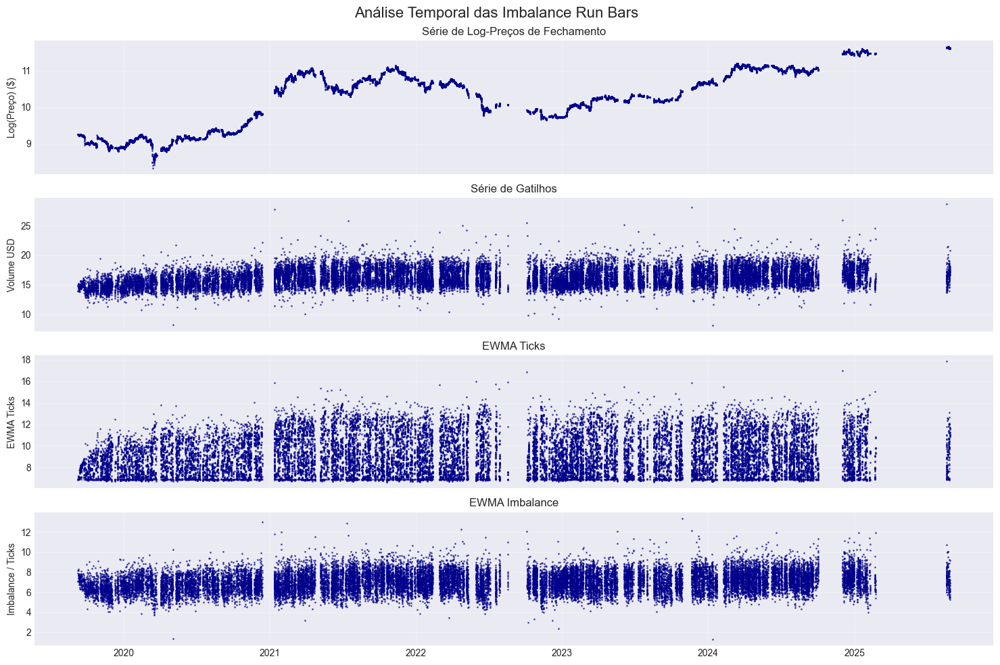

In [3]:
# Diretório contendo os datasets
data_dir = "./output/"

# Listar todos os arquivos na pasta 'data' que terminam com .parquet
parquet_files = [f for f in os.listdir(data_dir) if f.endswith('.parquet')]

if not parquet_files:
    print(f"Nenhum arquivo .parquet encontrado no diretório {data_dir}")
else:
    for file_name in parquet_files:
        full_path = os.path.join(data_dir, file_name)
        analyze_parquet_dataset(full_path)

## 3. Verificação da Construção das Barras

ANÁLISE DE DOLLAR STANDART BARS - METODOLOGIA LOPEZ DE PRADO
SAMPLE - ./output/standart/20250903-204459-standart-futures-volume40000000.parquet

📊 Dataset carregado: 682,162 barras
📅 Índices: 0 até 682161

📋 Estrutura dos dados:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 682162 entries, 0 to 682161
Data columns (total 11 columns):
 #   Column                Non-Null Count   Dtype         
---  ------                --------------   -----         
 0   end_time              682162 non-null  datetime64[ns]
 1   open                  682162 non-null  float64       
 2   high                  682162 non-null  float64       
 3   low                   682162 non-null  float64       
 4   close                 682162 non-null  float64       
 5   theta_k               682162 non-null  float64       
 6   total_volume_buy_usd  682162 non-null  float64       
 7   total_volume_usd      682162 non-null  float64       
 8   total_volume          682162 non-null  float64       
 9   ticks 

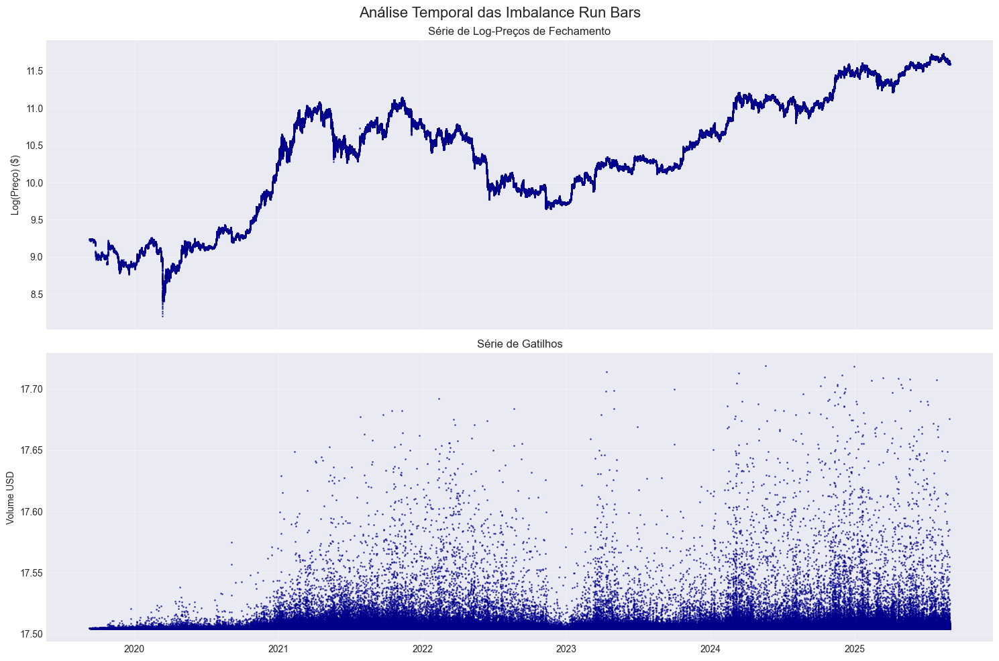

In [ ]:
def analyze_parquet_dataset(dataset_path):

    df = pd.read_parquet(dataset_path)

    print("="*80)
    print(f"ANÁLISE DE DOLLAR STANDART BARS - METODOLOGIA LOPEZ DE PRADO")
    print(f"SAMPLE - {dataset_path}")
    print("="*80)

    # Converter colunas de tempo para datetime se necessário
    # As datas parecem estar em nanossegundos desde época Unix
    if 'close_time' in df.columns:
        df['close_time'] = pd.to_datetime(df['close_time'], unit='ns')
    if 'open_time' in df.columns:
        df['open_time'] = pd.to_datetime(df['open_time'], unit='ns')

    # Informações básicas
    print(f"\n📊 Dataset carregado: {len(df):,} barras")

    # Usar close_time para análises temporais
    if 'close_time' in df.columns:
        print(f"📅 Período: {df['close_time'].min()} até {df['close_time'].max()}")
        duration = (df['close_time'].max() - df['close_time'].min()).total_seconds() / 86400  # em dias
        print(f"⏱️  Duração: {duration:.1f} dias")
        if duration > 0:
            print(f"📈 Frequência média: {len(df) / duration:.1f} barras/dia")
        else:
            # Se a duração for menor que 1 dia, calcular em horas
            duration_hours = (df['close_time'].max() - df['close_time'].min()).total_seconds() / 3600
            print(f"⏱️  Duração: {duration_hours:.1f} horas")
            print(f"📈 Frequência média: {len(df) / duration_hours:.1f} barras/hora")
    else:
        print(f"📅 Índices: {df.index[0]} até {df.index[-1]}")

    # Estrutura dos dados
    print("\n📋 Estrutura dos dados:")
    print(df.info())

    # Primeiras observações
    print("\n🔍 Primeiras 5 barras:")
    df.head()

    df['total_volume_sell_usd'] = df['total_volume_buy_usd'] - df['total_volume_usd']

    # Estatísticas descritivas
    print("\n📊 Estatísticas Descritivas:")
    print("\n1. PREÇOS:")
    price_stats = df[['open', 'high', 'low', 'close']].describe()
    print(price_stats)

    print("\n2. VOLUMES:")
    volume_stats = df[['total_volume_usd', 'total_volume_buy_usd', 'total_volume_sell_usd', 'total_volume']].describe()
    print(volume_stats)

    time_between_bars = df['end_time'].diff().dt.total_seconds() / 60  # em minutos
    time_between_bars = time_between_bars.dropna()

    # Estatísticas do tempo entre barras
    print("\n4. 📊 Estatísticas do Tempo entre Barras:")
    print(f"   • Média: {time_between_bars.mean():.2f} minutos")
    print(f"   • Mediana: {time_between_bars.median():.2f} minutos")
    print(f"   • Desvio padrão: {time_between_bars.std():.2f} minutos")
    print(f"   • Min: {time_between_bars.min():.2f} minutos")
    print(f"   • Max: {time_between_bars.max():.2f} minutos")

    # Visualização da série temporal completa (usando amostragem para performance)
    fig, axes = plt.subplots(2, 1, figsize=(15, 10), sharex=True)
    fig.suptitle('Análise Temporal das Imbalance Run Bars', fontsize=16)

    n_sample = 100_000_000_000_000

    # Usar amostragem para visualização se o dataset for muito grande
    if len(df) > n_sample:
        # Amostrar 10000 pontos uniformemente distribuídos
        sample_indices = np.linspace(0, len(df)-1, n_sample, dtype=int)
        df_plot = df.iloc[sample_indices]
        print(f"📊 Visualizando {len(df_plot):,} barras amostradas de {len(df):,} barras totais")
    else:
        df_plot = df

    # 1. Preço de fechamento (log scale)
    ax1 = axes[0]
    ax1.scatter(df_plot['end_time'], np.log(df_plot['close']),
            color='darkblue', s=1, alpha=0.6)
    ax1.set_ylabel('Log(Preço) ($)')
    ax1.set_title('Série de Log-Preços de Fechamento')
    ax1.grid(True, alpha=0.3)

    ax2 = axes[1]
    ax2.scatter(df_plot['end_time'], df_plot['total_volume_usd'],
            color='darkblue', s=1, alpha=0.6)
    ax2.set_ylabel('Volume USD')
    ax2.set_title('Série de Gatilhos')
    ax2.grid(True, alpha=0.3)

    plt.tight_layout()
    plt.show()

    # Diretório contendo os datasets
data_dir = "./output/standart/"

# Listar todos os arquivos na pasta 'data' que terminam com .parquet
parquet_files = [f for f in os.listdir(data_dir) if f.endswith('.parquet')]

if not parquet_files:
    print(f"Nenhum arquivo .parquet encontrado no diretório {data_dir}")
else:
    for file_name in parquet_files:
        full_path = os.path.join(data_dir, file_name)
        analyze_parquet_dataset(full_path)